# Case Study One

In [276]:
# Authors: 
# Elton Pan, Antonio del Rio Chanona

import pylab
import pandas as pd
import scipy.integrate as scp
import numpy as np
import seaborn as sns
from pylab import *
import csv
import os
import sys
import copy
import torch
from sklearn.preprocessing import StandardScaler
import collections
import numpy.random as rnd
from scipy.spatial.distance import cdist
import sobol_seq
from scipy.optimize import minimize
eps  = np.finfo(float).eps
import random
import time
import pickle
import imageio
matplotlib.rcParams['font.sans-serif'] = "Helvetica"
matplotlib.rcParams['font.family'] = "Helvetica"
matplotlib.rcParams['font.size'] = 20
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
from IPython.display import Audio # Import sound alert dependencies
from IPython import display # For live plots
from mpl_toolkits import mplot3d
from ipywidgets import interact
from __future__ import print_function
import sys
import threading
import json
from time import sleep
try:
    import thread
except ImportError:
    import _thread as thread
    
def quit_function(fn_name):
    # print to stderr, unbuffered in Python 2.
    print('@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@{0} TOOK TOO LONG @@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@'.format(fn_name), file=sys.stderr)
    sys.stderr.flush() # Python 3 stderr is likely buffered.
    thread.interrupt_main() # raises KeyboardInterrupt
def exit_after(s):
    '''
    use as decorator to exit process if 
    function takes longer than s seconds
    '''
    def outer(fn):
        def inner(*args, **kwargs):
            timer = threading.Timer(s, quit_function, args=[fn.__name__])
            timer.start()
            try:
                result = fn(*args, **kwargs)
            finally:
                timer.cancel()
            return result
        return inner
    return outer

def Done():
    display(Audio(url='https://sound.peal.io/ps/audios/000/000/537/original/woo_vu_luvub_dub_dub.wav', autoplay=True))
# Insert whatever audio file you want above

############ Defining Environment ##############
class Model_env: 
    
    # --- initializing model --- #
    def __init__(self, parameters, tf):
        
        # Object variable definitions
        self.parameters       = parameters
        self.tf = tf  
        
    # --- dynamic model definition --- #    
    # model takes state and action of previous time step and integrates -- definition of ODE system at time, t
    def model(self, t, state):
        # internal definitions
        params = self.parameters
        u_L  = self.u0[0] # Control for light intensity
        u_Fn = self.u0[1] # Control for nitrate input
                
        # state vector # Added Cq as the third state element
        Cx  = state[0]
        Cn  = state[1]
        Cq  = state[2]
        
        # parameters # Updated with new params
        u_m = params['u_m']; k_s = params['k_s'];
        k_i = params['k_i']; K_N = params['K_N'];
        u_d = params['u_d']; Y_nx = params['Y_nx'];
        k_m = params['k_m']; k_sq = params['k_sq'];
        k_iq = params['k_iq']; k_d = params['k_d'];
        K_Np = params['K_Np'];
        
        # algebraic equations
        
        # variable rate equations
        dev_Cx = (u_m * u_L * Cx * Cn/(Cn+K_N))/(u_L+k_s+u_L**2/k_i) - u_d*Cx
        dev_Cn = (- Y_nx*u_m* u_L * Cx * Cn/(Cn+K_N))/(u_L+k_s+u_L**2/k_i) + u_Fn
        dev_Cq = (k_m * u_L * Cx)/(u_L+k_sq+u_L**2/k_iq) - k_d * Cq/(Cn+K_Np)

        return np.array([dev_Cx, dev_Cn, dev_Cq],dtype='float64') # Added Cq

    def simulation(self, x0, controls):
        # internal definitions
        model, tf     = self.model, self.tf
        self.controls = controls
        
        # initialize simulation
        current_state = x0
        
        # simulation #ONLY ONE STEP unlike the previous code shown above
        self.u0   = controls
        ode       = scp.ode(model)                      # define ode
        ode.set_integrator('lsoda', nsteps=3000)        # define integrator
        ode.set_initial_value(current_state, tf)         # set initial value
        current_state = list(ode.integrate(ode.t + tf)) # integrate system
        xt            = current_state                   # add current state Note: here we can add randomnes as: + RandomNormal noise
        
        return xt

    def MDP_simulation(self, x0, controls): #simulate ONLY ONE STEP
        xt          = self.simulation(x0, controls) #simulate
####         xt_discrete = self.discrete_env(xt) # make output state discrete
####         return xt_discrete
        return xt #remove this if you want to discretize

    def reward(self, state):
        reward = 100*state[-1][0] - state[-1][1]              # objective function 1
        return reward

# Constants
p = {'u_m' : 0.0923*0.62, 
     'k_s' : 178.85, 
     'k_i' : 447.12, 
     'K_N' : 393.10, 
     'u_d' : 0.001, 
     'Y_nx' : 504.49, 
     'k_m' : 2.544*0.62*1e-4,  
     'k_sq' : 23.51,
     'k_iq' : 800.0, 
     'k_d' : 0.281, 
     'K_Np' : 16.89}

tf  = 240./12. # assuming 12 steps, we divide the whole horizon (240 h) over 12 for one step

# Creating the model
MDP_BioEnv = Model_env(p, tf)

def initialize_MDP_BioEnv():
    '''Initialize MDP_BioEnv with parameters with uncertainty'''
    # Constants with uncertainty
    p_uncertain = {'u_m' : 0.0923*0.62, 
                 'k_s' : np.random.normal(178.9, np.sqrt(17.89)),   # 10 % uncertainty # remember np.sqrt takes in std not variance
                 'k_i' : np.random.normal(447.12, np.sqrt(44.712)), # 10 % uncertainty # remember np.sqrt takes in std not variance
                 'K_N' : np.random.normal(393.10, np.sqrt(39.310)), # 10 % uncertainty # remember np.sqrt takes in std not variance
                 'u_d' : 0.001, 
                 'Y_nx' : 504.49, 
                 'k_m' : 2.544*0.62*1e-4,  
                 'k_sq' : 23.51,
                 'k_iq' : 800.0, 
                 'k_d' : 0.281, 
                 'K_Np' : 16.89}
    tf = 240./12.
    # Initialize the model
    MDP_BioEnv = Model_env(p_uncertain, tf)

def generate_initial_state():
    '''Generates initial state with uncertainty'''
    Cx = np.random.normal(1, np.sqrt(1e-3))
    Cn = np.random.normal(150, np.sqrt(22.5))
    Cq = 0
    t  = 0
    initial_state = [Cx, Cn, Cq, t]
    return initial_state

def transition(old_state, action):
    '''Gives the new state given the current state and action
       Arguments
       old state : [Cx, Cn, Cq, t] 
       action    : [u_L, u_Fn]
    
       Output 
       new state : [Cx, Cn, Cq, t]
       reward    : [Cq_Terminal]
       '''
    # If terminal state is reached (episode in final step)
    if abs(old_state[3] - 240.) < 0.1:
        reward    = copy.deepcopy(old_state[2])           # Reward at terminal state is concentration of q
        new_state = MDP_BioEnv.MDP_simulation(old_state[:-1], action)  # Take action and evolve using model
        new_state.append(old_state[-1] + tf)                           # Increment time by tf (20 h)
    
    # Else if past terminal state (episode has ended)
    elif (old_state[3] > 240.):
        reward    = 0         # Zero reward given
        new_state = old_state # Loop back to itself (no evolution)
    
    # Else non-terminal state (episode has not ended)
    else:
        reward    = 0         # Zero reward given
        new_state = MDP_BioEnv.MDP_simulation(old_state[:-1], action) # Take action and evolve using model
        new_state.append(old_state[-1] + tf)                          # Increment time by tf (20 h)

    return new_state, reward

def generate_random_episode(initial_state): 
    '''Generates an episode [
                             [ [Cx, Cn, Cq, t], [u_L, u_Fn], reward ]
                             ...
                             ...
                             ]
    with random policy with
    an initial state
    '''
    # Initial state
    state  = initial_state # initial state
    episode = []
    
    # Simulate 13 steps (not 12 because we want to exit the terminal step)
    for step in range(13):
        old_state = state                  # Save old state
        u_L  = np.random.uniform(120, 400) # Pick random u_L
        u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
        action = [u_L, u_Fn]
        
        state, reward = transition(state, action)
        episode       += [[old_state, action, reward]]
    return episode
# generate_random_episode(initial_state = [1.0,150.0,0,0]) # Test generate_random_episode


def extract_data_from_episode(episode, discount_factor = 0.9):
    '''
    Argument: An episode generated using the generate_random_episode() function
    
    Output: 13 Datapoints in the form of [[Cx, Cn, Cq, t, u_L, u_Fn], Q] for training 
            the Q-network
    '''
    Q_data = []
    for step in reversed(range(13)): # Each episode has 13 entries, and Q table is updated in reversed order
        state, action, reward = episode[step] 

        if step == 12: # If terminal state i.e. t = 240
            G = reward # Return = reward at terminal state
        else:
            G = reward + discount_factor * G  # Return = reward + discounted return of the PREVIOUS state
        
        u_L, u_Fn = action     #  Unpack controls
        state.append(u_L)       # Append u_L
        state.append(u_Fn)      # Append u_Fn
        data_point = [state, G] # Construct datapoint where state is index 0, and return is index 1
        Q_data += [data_point]
    return Q_data
# episode = generate_random_episode(initial_state = [1.0,150.0,0,0])
# extract_data_from_episode(episode, discount_factor = 0.9) # Test function

def standardize_state_Q(state): # For Q-network
    '''Argument: Un-standardized [Cx, Cn, Cq, t, u_L, u_Fn]
    Output: Standardized [Cx, Cn, Cq, t, u_L, u_Fn] using previously determined mean and std values''' 
    for feature in range(len(x_mean_Q)): 
        state[feature] = (state[feature] - x_mean_Q[feature])/x_std_Q[feature]
    return state

def unstandardize_state_Q(state): # For Q-network
    '''Argument: Standardized [Cx, Cn, Cq, t, u_L, u_Fn]
    Output: Un-standardized [Cx, Cn, Cq, t, u_L, u_Fn] using previously determined mean and std values''' 
    for feature in range(len(x_mean_Q)): 
        state[feature] = (state[feature] * x_std_Q[feature]) + x_mean_Q[feature]
    return state

def standardize_state_C(state): # For C-network
    '''Argument: Un-standardized [Cx, Cn, Cq, t_f - t, u_L, u_Fn]
    Output: Standardized [Cx, Cn, Cq, t_f - t, u_L, u_Fn] using previously determined mean and std values''' 
    for feature in range(len(x_mean_C)): 
        state[feature] = (state[feature] - x_mean_C[feature])/x_std_C[feature]
    return state

def unstandardize_state_C(state): # For C-network
    '''Argument: Standardized [Cx, Cn, Cq, t_f - t, u_L, u_Fn]
    Output: Un-standardized [Cx, Cn, Cq, t_f - t, u_L, u_Fn] using previously determined mean and std values''' 
    for feature in range(len(x_mean_C)): 
        state[feature] = (state[feature] * x_std_C[feature]) + x_mean_C[feature]
    return state

def take_random_action(epsilon): # Epsilon represents the probability of taking a random action
    if np.random.uniform(0,1) < epsilon:
        return True
    else:
        return False
    

def max_action(state):
    '''Argument: State   [Cx, Cn, Cq, t]
       Output  : Control [u_L, u_Fn] that maximizes Q_value using stochastic optimization'''
    
    # ROUND ONE: Get a ROUGH estimate of max action
    action_distribution = []
    for i in range(200): # Take 100 actions
        u_L  = np.random.uniform(120, 400) # Pick random u_L
        u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
        action_distribution += [[u_L, u_Fn]]

    inputs = []
    for a in action_distribution:
        s = state.copy()
        s.append(a[0]) # Append u_L
        s.append(a[1]) # Append u_Fn
        s = standardize_state_Q(s) # Standardize the input using function defined
        inputs += [s]
    inputs          = torch.tensor(inputs)
    index_of_highest_Q = np.argmax(Q_net(inputs).detach().numpy()) 

    # Unstandardize controls
    max_u_L  = (inputs[index_of_highest_Q][4] * x_std_Q[4]).item() + x_mean_Q[4]
    max_u_Fn = (inputs[index_of_highest_Q][5] * x_std_Q[5]).item() + x_mean_Q[5]
    max_control = [max_u_L, max_u_Fn]

    # ROUND TWO: Get a PRECISE estimate of max action
    action_distribution = []
    for i in range(200): # Take 100 actions
        u_L  = np.random.uniform(max(max_control[0]-50, 120), min(max_control[0]+50, 400))
        u_Fn = np.random.uniform(max(max_control[1]-5, 0), min(max_control[1]+5, 40))
        action_distribution += [[u_L, u_Fn]]

    inputs = []
    for a in action_distribution:
        s = state.copy()
        s.append(a[0]) # Append u_L
        s.append(a[1]) # Append u_Fn
        s = standardize_state_Q(s) # Standardize the input using function defined
        inputs += [s]

    inputs          = torch.tensor(inputs)
    index_of_highest_Q = np.argmax(Q_net(inputs).detach().numpy()) 

    # Unstandardize controls
    max_u_L  = (inputs[index_of_highest_Q][4] * x_std_Q[4]).item() + x_mean_Q[4]
    max_u_Fn = (inputs[index_of_highest_Q][5] * x_std_Q[5]).item() + x_mean_Q[5]
    max_control = [max_u_L, max_u_Fn] # Predict action with the highest Q value

    return max_control
# max_action([1.0, 150.0, 0, 0]) # Test function

@exit_after(10)
def score_NN_policy(NN, initial_state, num_iterations = 10, get_control = False, g1_threshold = None, g2_threshold = None, g3_threshold = None):
    total_score = 0
    sum_of_policies = []
    if g1_threshold == None: # If no threshold is given (non constrained NN)
        for j in range(num_iterations): 
            state     = initial_state.copy() # Initial state
            x_data    = [state[0]] # Store initial data
            N_data    = [state[1]]
            q_data    = [state[2]]
            t_data    = [state[3]]
            my_policy = []
            for i in range(12): #take ten steps
                action     = NN(state) # Predict action using NN
                state      = transition(state, action)[0]
                my_policy += [action]
                x_data    += [state[0]]
                N_data    += [state[1]]
                q_data    += [state[2]]
                t_data    += [state[3]]
            sum_of_policies += [my_policy] # Create list of lists
            score            = q_data[12]
            total_score     += score
    elif g1_threshold != None: # If threshold given (NN with constrained)
        for j in range(num_iterations): 
            state     = initial_state.copy() # Initial state
            x_data    = [state[0]] # Store initial data
            N_data    = [state[1]]
            q_data    = [state[2]]
            t_data    = [state[3]]
            my_policy = []
            for i in range(12): #take ten steps
#                 print('state after action:', state)
                state_for_NN = state.copy()
                action     = NN(state_for_NN, g1_threshold = g1_threshold, g2_threshold = g2_threshold, g3_threshold = g3_threshold) # Predict action using NN
#                 print('state before action:', state)
                state      = transition(state, action)[0]
                my_policy += [action]
                x_data    += [state[0]]
                N_data    += [state[1]]
                q_data    += [state[2]]
                t_data    += [state[3]]
            sum_of_policies += [my_policy] # Create list of lists
            score            = q_data[12]
            total_score     += score
    if get_control == True:
        return total_score/num_iterations, np.array(sum_of_policies)
    else:
        return total_score/num_iterations
# score_NN_policy(max_action, [1.0, 150.0, 0, 0], num_iterations = 10)

@exit_after(5)
def generate_episode_with_NN(NN, initial_state, epsilon, g1_threshold = None, g2_threshold = None, g3_threshold = None): 
    '''Generates an episode with the chosen action of each step having:
    Probability of epsilon       ---> random action
    Probability of (1 - epsilon) ---> greedy action (according to neural network)
    '''
    episode = []
    state = initial_state # Initial state
    
    if g1_threshold == None: # IF CONSTRAINTS ARE SWITCHED OFF
        for i in range(13): #take (12 + 1) steps
#             old_state = state # Old state for storing into episode
            old_state = copy.deepcopy(state)
    
            if take_random_action(epsilon): # Take random action
                u_L  = np.random.uniform(120, 400) # Pick random u_L
                u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
                action = [u_L, u_Fn]

            else:                           # Else take greedy action
                action = list(NN(old_state))

            state, reward  = transition(state, action)     # Evolve to get new state 
            episode       += [[old_state, action, reward]] # Update step
    
    elif g1_threshold != None: # IF CONSTRAINTS ARE SWITCHED ON
        for i in range(13): #take (12 + 1) steps
#             print('state at the start of each step:', state)
#             old_state_copy = copy.deepcopy(state)  # THIS IS IMPORTANT BCOS THE NN BELOW SOMEHOW DISTORTS OLD_STATE
            if take_random_action(epsilon): # Take random action
                u_L  = np.random.uniform(120, 400) # Pick random u_L
                u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
                action = [u_L, u_Fn]
            else:                           # Else take greedy action
                if i == 12: # If transition out of the terminal state, pick any action
                    action = action
#                     print('13th transition')
                else:
                    state_for_NN = copy.copy(state)
                    
#                     print('state_for_nn:', state_for_NN)
#                     print('state before acion:', state)
                    
                    action = list(NN(state_for_NN, g1_threshold = g1_threshold, g2_threshold = g2_threshold, g3_threshold = g3_threshold)) # APPLY THRESHOLD
#                     print('state after acion:', state)
#                     print(i)
                #                     print('old_state:', old_state)
#                 print('done')

            old_state = state.copy() # Old state for storing into episode
#             print('old_state_1:', old_state)
#             print('state before evolution:', state)
            state, reward  = transition(state, action)     # Evolve to get new state
#             print('state after evolution:', state)
#             print('')
            episode       += [[old_state, action, reward]] # Update step
    return episode
# generate_episode_with_NN(max_action, [1.0, 150.0, 0, 0], epsilon = 0.1)

def update_replay_buffer(replay_buffer, episode, discount_factor = 0.9):
    '''Argument: replay buffer (a collections.deque object) and ONE episode
    Output: Adds standardized datapoints [[Cx, Cn, Cq, t, u_L, u_Fn], Q] for training NN into replay buffer
    '''
    data = extract_data_from_episode(episode, discount_factor = discount_factor) # Extract data points from episode
    for data_point in data:
        X, y = data_point # Unpack datapoint
        X = standardize_state_Q(X) # Standardize X
        y = ((y - y_mean_Q)/y_std_Q)[0] # Standardize y
        data_point = [X, y] # Repack datapoint
        replay_buffer.extend([data_point]) # Add to replay buffer
    
    return replay_buffer
# replay_buffer = collections.deque(maxlen = 3000) # Max capacity of 3000
# episode = generate_episode_with_NN(max_action, [1.0, 150.0, 0, 0], epsilon = 0.1)
# update_replay_buffer(replay_buffer, episode)

def plot_episode(episode):
    '''Plots an episode and corresponding score'''
    x_list = []
    N_list =[]
    q_list =[]
    t_list =[]
    u_L_list= []
    u_Fn_list = []
    reward_list = []
    t = 0
    for step in episode:
        [Cx, Cn, Cq, t], [u_L, u_Fn], reward = step
        x_list += [Cx]
        N_list += [Cn]
        q_list += [Cq]
        t_list += [t]
        u_L_list+= [u_L]
        u_Fn_list += [u_Fn]
        reward_list += [reward]
        t += tf

    plt.figure(figsize=(10,10))

    plt.subplot(3,2,1)
    plt.plot(t_list, x_list, label = 'x trajectory', color = 'b')
    plt.legend(fontsize = 15)

    plt.subplot(3,2,2)
    plt.plot(t_list, N_list, label = 'N trajectory', color = 'b')
    plt.legend(fontsize = 15)

    plt.subplot(3,2,3)
    plt.plot(t_list, q_list, label = 'q trajectory', color = 'b')
    plt.legend(fontsize = 15)

    plt.subplot(3,2,5)
    plt.step(t_list, u_L_list, label = 'u_L trajectory', color = 'r')
    plt.ylim(100,420)
    plt.legend(fontsize = 15)

    plt.subplot(3,2,6)
    plt.step(t_list, u_Fn_list, label = 'u_Fn trajectory', color = 'r')
    plt.ylim(0,43)
    plt.legend(fontsize = 15)

    plt.show()
    print('Score:', q_list[-1])
    # print('x_list:', x_list)
    # print('n_list:', N_list)
    # print('q_list:', q_list)
    # print('reward_list:', reward_list)
    # print('t_list:', t_list)
# episode = generate_episode_with_NN(NN = max_action, initial_state = [1.0, 150.0, 0, 0], epsilon = 0)
# plot_episode(episode)

def plot_episode_pool(episode_pool):
    '''Plots an episode pool (n number of episodes) and corresponding score'''
    
    plt.figure(figsize=(10,10))
    x_pool = []
    N_pool = []
    q_pool = []
    t_pool = []
    u_L_pool = []
    u_Fn_pool = []
    
    for idx in range(len(episode_pool)): # Idx refers to nth episode in episode pool
        episode = episode_pool[idx]
        x_list = []
        N_list = []
        q_list = []
        t_list = []
        u_L_list = []
        u_Fn_list = []
        reward_list = []
        t = 0
        
        for step in episode:
            [Cx, Cn, Cq, t], [u_L, u_Fn], reward = step
            x_list += [Cx]
            N_list += [Cn]
            q_list += [Cq]
            t_list += [t]
            u_L_list += [u_L]
            u_Fn_list += [u_Fn]
            reward_list += [reward]
            t += tf
        
        x_pool += [x_list]
        N_pool += [N_list]
        q_pool += [q_list]
        u_L_pool += [u_L_list]
        u_Fn_pool += [u_Fn_list]
        
        plt.subplot(3,2,1)
        if idx == 0:
            plt.plot(t_list, x_list, label = 'x trajectory', color = 'grey')
            
            plt.legend(fontsize = 15)
        else:
            plt.plot(t_list, x_list, label = 'x trajectory', color = 'grey')

        plt.subplot(3,2,2)
        if idx == 0:
            plt.plot(t_list, N_list, label = 'N trajectory', color = 'grey')
            plt.legend(fontsize = 15)
        else:
            plt.plot(t_list, N_list, label = 'N trajectory', color = 'grey')

        plt.subplot(3,2,3)
        if idx == 0:
            plt.plot(t_list, q_list, label = 'q trajectory', color = 'grey')
            plt.legend(fontsize = 15)
        else:
            plt.plot(t_list, q_list, label = 'q trajectory', color = 'grey')

        plt.subplot(3,2,5)
        if idx == 0:
            plt.step(t_list, u_L_list, label = 'u_L trajectory', color = 'grey')
            plt.ylim(100,420)
            plt.legend(fontsize = 15)
        else:
            plt.step(t_list, u_L_list, label = 'u_L trajectory', color = 'grey')
            plt.ylim(100,420)

        plt.subplot(3,2,6)
        if idx == 0:
            plt.step(t_list, u_Fn_list, label = 'u_Fn trajectory', color = 'grey')
            plt.ylim(0,43)
            plt.legend(fontsize = 15)
        else:
            plt.step(t_list, u_Fn_list, label = 'u_Fn trajectory', color = 'grey')
            plt.ylim(0,43)
        
    x_pool = np.array(x_pool)
    N_pool = np.array(N_pool)
    q_pool = np.array(q_pool)
    u_L_pool = np.array(u_L_pool)
    u_Fn_pool = np.array(u_Fn_pool)
        
    # Take mean of all columns (all time steps)
    x_avg_list = x_pool.mean(axis=0)
    N_avg_list = N_pool.mean(axis=0)
    q_avg_list = q_pool.mean(axis=0)
    u_L_avg_list  = u_L_pool.mean(axis=0)
    u_Fn_avg_list = u_Fn_pool.mean(axis=0)
        
    plt.subplot(3,2,1)
    plt.plot(t_list, x_avg_list, label = 'x trajectory', color = 'b')
#     plt.xlabel('Time')
#     plt.ylabel('x')

    plt.subplot(3,2,2)
    plt.plot(t_list, N_avg_list, label = 'N trajectory', color = 'b')
    plt.plot(t_list, len(t_list)*[800.0], linestyle = '--', color = 'r') # Plot N_limit

    plt.subplot(3,2,3)
    plt.plot(t_list, q_avg_list, label = 'q trajectory', color = 'b')

    plt.subplot(3,2,5)
    plt.step(t_list, u_L_avg_list, label = 'u_L trajectory', color = 'r')
    plt.ylim(100,420)

    plt.subplot(3,2,6)
    plt.step(t_list, u_Fn_avg_list, label = 'u_Fn trajectory', color = 'r')
    plt.ylim(0,43)
            
    plt.show()
    print('Score:', q_list[-1])
# episode_pool = []
# for i in range(10):
#     episode = generate_episode_with_NN(GA_optimize_constrained, [1.0, 150.0, 0, 0], epsilon = 0, 
#                                    g1_threshold = 0, 
#                                    g2_threshold = 0,
#                                      g3_threshold = 0) 
#     episode_pool += [episode]
# plot_episode_pool(episode_pool)

def extract_constraint_values_from_episode(episode, N_limit = 800, terminal_N_limit = 150):
    '''Arguments : 1 episode and N_limit
       Output    : Index 0 gives input data in terms of [Cx, Cn, Cq, t-t_f, u_L, u_Fn]
                   Index 1 gives target constraint values'''

    state_action = [] # Initialize inputs
    g1_target   = [] # Initialize target value (constraints)
    g2_target   = [] # Initialize target value (constraints)
    g3_target   = [] # Initialize target value (constraints)
    targets = [] # Initialize target values [[g1, g2 g3], ...]
    
    num_transitions = 12
    for i in range(num_transitions): # Index 0 to 11 instead of 12 because we consider the 1st 12 transitions
        step             = episode[i]       # Choose a specific step
        new_step         = episode[i+1]     # and the corresponding subsequent step
        
        state, action, _ = step             # Unpack state & action
        state            = list(state)
        state[3]         = 240. - state[3]   # IMPORTANT: Modify t to (t_f - t)
        state           += action           # Append u_L and u_Fn
        
        # INPUT for training
        state_action += [state]
        
        new_state, _, _  = new_step         # Unpack subsequent state
        Cx               = new_state[0]     # Biomass of SUBSEQUENT step (for g2)
        Cn               = new_state[1]     # Nitrate of SUBSEQUENT step (for g1)
        Cq               = new_state[2]     # Bioproduct of SUBSEQUENT step (for g2)
        
        if i == (num_transitions-1): # If final transition
            Cn_T         = new_state[1]     # Nitrate of TERMINAL state (for g3)

        # TARGETS for path constraint 1 (g1) where Cn - 800 =< 0
        g1           = Cn - N_limit # Calculate constraint value (+ve for exceeding limit)
        g1_target   += [[g1]]      # TARGET OUTPUT (IMPORTANT TO USE A NESTED LIST hence the DOUBLE square brackets)

        # TARGETS for path constraint 2 (g2) where Cq - 0.011*Cx =< 0
        g2           = Cq - 0.011 * Cx # Calculate constraint value (+ve for exceeding limit)
        g2_target   += [[g2]]      # TARGET OUTPUT (IMPORTANT TO USE A NESTED LIST hence the DOUBLE square brackets)
        
    # TARGETS for terminal constraint 2 (g3) where CnT - 150 =< 0
    g3           = Cn_T - terminal_N_limit # Calculate constraint value (+ve for exceeding limit)
    g3_target    = []
    for k in range(num_transitions):
        g3_target += [[g3]] # Nested list
    # End constraint violation same for all steps in same episode
    
    # Update constraints using "Crystal Ball/Oracle": Highest/Worst constraint value from current and future steps
    for j in range(num_transitions - 1): # Index of constraint value to be checked (11 instead of 12 bcos the 12th value is terminal and has no future)
        for k in range(num_transitions-j): # Number of steps into the future
            # ====Oracle for g1====
            if g1_target[j] < g1_target[j+k]: # If future g1 value is LARGER than current value
                g1_target[j] = g1_target[j+k]  # Replace current value with future value
        
#         # ===== DISCOUNTED ORACLE FOR g2====
#         alpha = (j+1)/12 # Degree of contribution by terminal g2 (low for early states, high for late states)
#         g2_target[j][0] = alpha*g2_target[-1][0] + (1 - alpha)*g2_target[j][0]
            # ====Oracle for g2====
            if g2_target[j] < g2_target[j+k]: # If future g2 value is LARGER than current value
                g2_target[j] = g2_target[j+k]  # Replace current value with future value
            
    
#     for m in range(num_transitions): # Pack into a nested list
#         g1 = g1_target[m]
#         g2 = g2_target[m]
#         g3 = g3_target[m]
#         targets += [[g1]] # g1 only - NEEDS TO BE NESTED LIST
#         targets += [[g1, g2]] # g1 and g2 only - NEEDS TO BE NESTED LIST
#         targets += [[g1, g2, g3]] # g1, g2 and g3 - NEEDS TO BE NESTED LIST
        
#     print('g1:', g1_target)
#     print('')
#     print('g2:', g2_target)
#     print('')
#     print('g3:', g3_target)  
    return state_action, g1_target, g2_target, g3_target
# episode = generate_random_episode(initial_state = [1.0,150.0,0,0]) 
# extract_constraint_values_from_episode(episode)

def extract_constraint_values_from_episode_NO_ORACLE(episode, N_limit = 800, terminal_N_limit = 150):
    '''Arguments : 1 episode and N_limit
       Output    : Index 0 gives input data in terms of [Cx, Cn, Cq, t-t_f, u_L, u_Fn]
                   Index 1 gives target constraint values'''

    state_action = [] # Initialize inputs
    g1_target   = [] # Initialize target value (constraints)
    g2_target   = [] # Initialize target value (constraints)
    g3_target   = [] # Initialize target value (constraints)
    targets = [] # Initialize target values [[g1, g2 g3], ...]
    
    num_transitions = 12
    for i in range(num_transitions+1): # Index 0 to 11 instead of 12 because we consider the 1st 12 transitions
        step             = episode[i]       # Choose a specific step
        
        state, action, _ = step             # Unpack state & action
        
        Cx               = state[0]     # Biomass of CURRENT step (for g2)
        Cn               = state[1]     # Nitrate of CURRENT step (for g1)
        Cq               = state[2]     # Bioproduct of CURRENT step (for g2)
        
        if i == (num_transitions): # If final transition
            Cn_T         = state[1]     # Nitrate of TERMINAL state (for g3)

        # TARGETS for path constraint 1 (g1) where Cn - 800 =< 0
        g1           = Cn - N_limit # Calculate constraint value (+ve for exceeding limit)
        g1_target   += [[g1]]      # TARGET OUTPUT (IMPORTANT TO USE A NESTED LIST hence the DOUBLE square brackets)

        # TARGETS for path constraint 2 (g2) where Cq - 0.011*Cx =< 0
        g2           = Cq - 0.011 * Cx # Calculate constraint value (+ve for exceeding limit)
        g2_target   += [[g2]]      # TARGET OUTPUT (IMPORTANT TO USE A NESTED LIST hence the DOUBLE square brackets)
        
    # TARGETS for terminal constraint 2 (g3) where CnT - 150 =< 0
    g3           = Cn_T - terminal_N_limit # Calculate constraint value (+ve for exceeding limit)
    g3_target    = []
    for k in range(num_transitions):
        g3_target += [[g3]] # Nested list
    # End constraint violation same for all steps in same episode

#     for m in range(num_transitions): # Pack into a nested list
#         g1 = g1_target[m]
#         g2 = g2_target[m]
#         g3 = g3_target[m]
#         targets += [[g1]] # g1 only - NEEDS TO BE NESTED LIST
#         targets += [[g1, g2]] # g1 and g2 only - NEEDS TO BE NESTED LIST
#         targets += [[g1, g2, g3]] # g1, g2 and g3 - NEEDS TO BE NESTED LIST
        
#     print('g1:', g1_target)
#     print('')
#     print('g2:', g2_target)
#     print('')
#     print('g3:', g3_target)  
    return state_action, g1_target, g2_target, g3_target
# episode = generate_random_episode(initial_state = [1.0,150.0,0,0]) 
# extract_constraint_values_from_episode(episode)

def update_g1_buffer(g1_buffer, episode):
    '''Argument: g1 buffer (a collections.deque object) and ONE episode
    Output: Adds standardized datapoints [[Cx, Cn, Cq, t_f-f, u_L, u_Fn], g1] for training g1_net into replay buffer
    '''
    state_action, g1_constraint, g2_constraint, g3_constraint = extract_constraint_values_from_episode(episode) # Extract data points from episode
#     print('state_action:', state_action)

#     print('constraint:', constraint)
    for idx in range(len(state_action)):
        state_action[idx] = standardize_state_C(state_action[idx])
        g1_constraint[idx] = (np.array(g1_constraint[idx]) - y_mean_C[0])/y_std_C[0]
        data_point = [list(state_action[idx]), g1_constraint[idx].item()] # Repack datapoint
        g1_buffer.extend([data_point]) # Add to replay buffer
    
    return g1_buffer
# episode   = generate_random_episode(initial_state = [1.0,150.0,0,0]) 
# g1_buffer = collections.deque(maxlen = 3000) # Max capacity of 3000
# g1_buffer = update_g1_buffer(g1_buffer, episode)

def update_g2_buffer(g2_buffer, episode):
    '''Argument: g2 buffer (a collections.deque object) and ONE episode
    Output: Adds standardized datapoints [[Cx, Cn, Cq, t_f-f, u_L, u_Fn], g1] for training g1_net into replay buffer
    '''
    state_action, g1_constraint, g2_constraint, g3_constraint = extract_constraint_values_from_episode(episode) # Extract data points from episode
#     print('state_action:', state_action)

#     print('constraint:', constraint)
    for idx in range(len(state_action)):
        state_action[idx] = standardize_state_C(state_action[idx])
        g2_constraint[idx] = (np.array(g2_constraint[idx]) - y_mean_C[1])/y_std_C[1]
        data_point = [list(state_action[idx]), g2_constraint[idx].item()] # Repack datapoint
        g2_buffer.extend([data_point]) # Add to replay buffer
    
    return g2_buffer

def update_g3_buffer(g3_buffer, episode):
    '''Argument: g3 buffer (a collections.deque object) and ONE episode
    Output: Adds standardized datapoints [[Cx, Cn, Cq, t_f-f, u_L, u_Fn], g1] for training g1_net into replay buffer
    '''
    state_action, g1_constraint, g2_constraint, g3_constraint = extract_constraint_values_from_episode(episode) # Extract data points from episode
#     print('state_action:', state_action)

#     print('constraint:', constraint)
    for idx in range(len(state_action)):
        state_action[idx] = standardize_state_C(state_action[idx])
        g3_constraint[idx] = (np.array(g3_constraint[idx]) - y_mean_C[2])/y_std_C[2]
        data_point = [list(state_action[idx]), g3_constraint[idx].item()] # Repack datapoint
        g3_buffer.extend([data_point]) # Add to replay buffer
    
    return g3_buffer

def anneal_NN():
    '''Retrains to the neural networks (Q-net and constraint nets) to anneal the policy to
    solve the problem of frozen algorithm'''
    # TRAIN Q-NET
    combined_inputs_Q = []
    combined_targets_Q = []
    samples_Q          = random.sample(replay_buffer, 100) # Draw random samples from replay buffer
    for inputs, target in samples_Q:
        if len(inputs) == 6: # To fix the changing len problem
            combined_inputs_Q  += [inputs]
            combined_targets_Q += [[target]]
    combined_inputs_Q  = torch.tensor(combined_inputs_Q).double()  # Convert list to tensor
    combined_targets_Q = torch.tensor(combined_targets_Q).double() # Convert list to tensor
    Q_optimizer = torch.optim.Adam(Q_net.parameters(), lr=1e-3) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    for epoch in range(20):
        prediction = Q_net(combined_inputs_Q)                    # Input x and predict based on x
        Q_loss     = loss_func(prediction, combined_targets_Q) # Must be (1. nn output, 2. target)
        Q_optimizer.zero_grad()   # Clear gradients for next train
        Q_loss.backward()         # Backpropagation, compute gradients
        Q_optimizer.step() 

    # TRAIN G1-NET
    combined_inputs_g1  = [] # List of lists to be converted into input tensor
    combined_targets_g1 = []
    samples_g1          = random.sample(g1_buffer, 500) # Draw random samples from replay buffer
    for inputs, target in samples_g1:
        if len(inputs) == 6: # To fix the changing len problem
            combined_inputs_g1  += [inputs]
            combined_targets_g1 += [[target]]
    combined_inputs_g1  = torch.tensor(combined_inputs_g1).double()  # Convert list to tensor
    combined_targets_g1 = torch.tensor(combined_targets_g1).double()
    g1_optimizer = torch.optim.Adam(g1_net.parameters(), lr=1e-4) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    for epoch in range(10):
        prediction = g1_net(combined_inputs_g1)                    # Input x and predict based on x
        g1_loss    = loss_func(prediction, combined_targets_g1) # Must be (1. nn output, 2. target)
        g1_optimizer.zero_grad()   # Clear gradients for next train
        g1_loss.backward()         # Backpropagation, compute gradients
        g1_optimizer.step()        # Apply gradients

    # TRAIN G2-NET
    combined_inputs_g2  = [] # List of lists to be converted into input tensor
    combined_targets_g2 = []
    samples_g2          = random.sample(g2_buffer, 1000) # Draw random samples from replay buffer
    for inputs, target in samples_g2:
        if len(inputs) == 6: # To fix the changing len problem
            combined_inputs_g2  += [inputs]
            combined_targets_g2 += [[target]]
    combined_inputs_g2  = torch.tensor(combined_inputs_g2).double()  # Convert list to tensor
    combined_targets_g2 = torch.tensor(combined_targets_g2).double() # Convert list to tensor
    g2_optimizer = torch.optim.Adam(g2_net.parameters(), lr=1e-3) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    for epoch in range(100):
        prediction = g2_net(combined_inputs_g2)                    # Input x and predict based on x
        g2_loss    = loss_func(prediction, combined_targets_g2) # Must be (1. nn output, 2. target)
        g2_optimizer.zero_grad()   # Clear gradients for next train
        g2_loss.backward()         # Backpropagation, compute gradients
        g2_optimizer.step()        # Apply gradients
    
    # TRAIN G3-NET
    combined_inputs_g3  = [] # List of lists to be converted into input tensor
    combined_targets_g3 = [] # List to be converted into target tensor
    samples_g3          = random.sample(g3_buffer, 1000) # Draw random samples from replay buffer
    for inputs, target in samples_g3:
        if len(inputs) == 6: # To fix the changing len problem
            combined_inputs_g3  += [inputs]
            combined_targets_g3 += [[target]]
    combined_inputs_g3  = torch.tensor(combined_inputs_g3).double()  # Convert list to tensor
    combined_targets_g3 = torch.tensor(combined_targets_g3).double() # Convert list to tensor
    g3_optimizer = torch.optim.Adam(g3_net.parameters(), lr=1e-3) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    for epoch in range(200):
        prediction = g3_net(combined_inputs_g3)                    # Input x and predict based on x
        g3_loss    = loss_func(prediction, combined_targets_g3) # Must be (1. nn output, 2. target)
        g3_optimizer.zero_grad()   # Clear gradients for next train
        g3_loss.backward()         # Backpropagation, compute gradients
        g3_optimizer.step()        # Apply gradients
    print('NEURAL NETWORKS ANNEALED')

## Generate random MC episodes for standardizing training set

In [164]:
# Generate data
Q_network_training_data = []
for i in range(10000):
    initialize_MDP_BioEnv() # Initialize system with set of uncertain constants
    episode = generate_random_episode(initial_state = generate_initial_state()) # Generate 1 episode
    data = extract_data_from_episode(episode, discount_factor = 0.9)   # Extract datapoint from episode
    
    Q_network_training_data += data # Add datapoints to training set
Q_network_training_data

[[[7.509434725162255,
   89.02232416398125,
   0.08979387649281428,
   240.0,
   383.49150127965527,
   19.70902964655256],
  0.08979387649281428],
 [[7.022392185897543,
   56.95672942529394,
   0.07853441308510478,
   220.0,
   269.43361069922094,
   17.545629363401233],
  0.08081448884353286],
 [[6.656894359699193,
   91.45462616823069,
   0.06827624912382486,
   200.0,
   262.482853034098,
   10.952477718050604],
  0.07273303995917957],
 [[6.342130643965494,
   23.22257571004612,
   0.05722044014957039,
   180.0,
   143.8670197624729,
   14.61593044084994],
  0.06545973596326161],
 [[6.064768243133085,
   175.05381419948108,
   0.046810151366263555,
   160.0,
   142.28213353983773,
   2.56297183659588],
  0.058913762366935456],
 [[5.109080768753594,
   537.4336283792519,
   0.03432552149389747,
   140.0,
   127.57872299171085,
   8.8270496904649],
  0.05302238613024191],
 [[3.9737184312263314,
   816.8526815547485,
   0.023918572943820417,
   120.0,
   129.91274246423998,
   16.9550

In [187]:
# Random policy score
total_score = 0
for i in range(100):
    total_score += generate_random_episode(initial_state = generate_initial_state())[-1][-1]
print('Objective score of random policy:', total_score/100)

0.10267185400262488

In [178]:
# Extract data
state_and_action = [] # A list of lists for input
Q_value          = [] # A list of lists for target values 

for datapoint in Q_network_training_data: # Iterate over states
    s_a, Q            = datapoint # Unpack [Cx, Cn, Cq, t, u_L, u_Fn], Q
    state_and_action += [s_a]
    Q_value          += [[Q]]

state_and_action = np.array(state_and_action) # Convert list to tensor
Q_value          = np.array(Q_value)          # Convert list to tensor

# state_and_action[:3], Q_value[:3] # View first three examples
state_and_action.shape, Q_value.shape

((130000, 6), (130000, 1))

In [179]:
# Standardize data
X = state_and_action
y = Q_value

scaler_X = StandardScaler().fit(X)
scaler_y = StandardScaler().fit(y)

# Get mean and std
x_mean_Q = scaler_X.mean_
x_std_Q  = scaler_X.scale_
y_mean_Q = scaler_y.mean_
y_std_Q  = scaler_y.scale_

# Scale x
X_scaled = np.zeros(X.shape)
for feature in range(len(x_mean_Q)): 
    X_scaled[:,feature] = (X[:,feature] - x_mean_Q[feature])/x_std_Q[feature]

# Scale y
y_scaled = (y - y_mean_Q)/y_std_Q

# Convert into tensors
X_scaled = torch.tensor(X_scaled)
y_scaled = torch.tensor(y_scaled)
X_scaled, y_scaled

(tensor([[ 0.8475, -0.8710,  1.3803,  1.6036,  1.5239, -0.0229],
         [ 0.6897, -0.9697,  1.0662,  1.3363,  0.1171, -0.2105],
         [ 0.5713, -0.8635,  0.7801,  1.0690,  0.0314, -0.7822],
         ...,
         [-1.0858,  0.7873, -0.9679, -1.0690,  1.6518, -1.2291],
         [-1.1851, -0.2101, -1.0567, -1.3363, -1.4262,  0.4043],
         [-1.2458, -0.6998, -1.1244, -1.6036,  0.5309, -0.5828]],
        dtype=torch.float64),
 tensor([[ 1.1332],
         [ 0.7823],
         [ 0.4666],
         ...,
         [-1.1359],
         [-1.2599],
         [-1.3714]], dtype=torch.float64))

In [182]:
X_scaled.shape, y_scaled.shape

(torch.Size([130000, 6]), torch.Size([130000, 1]))

## Pre-training the Q-network with MC samples

In [183]:
Q_net = torch.nn.Sequential(
        torch.nn.Linear(6,   200, bias = True), # 6 input nodes
        torch.nn.LeakyReLU(),    # apply ReLU activation function
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),    # apply ReLU activation function
        torch.nn.Linear(200,   1, bias = True), # 1 output node
    ).double()

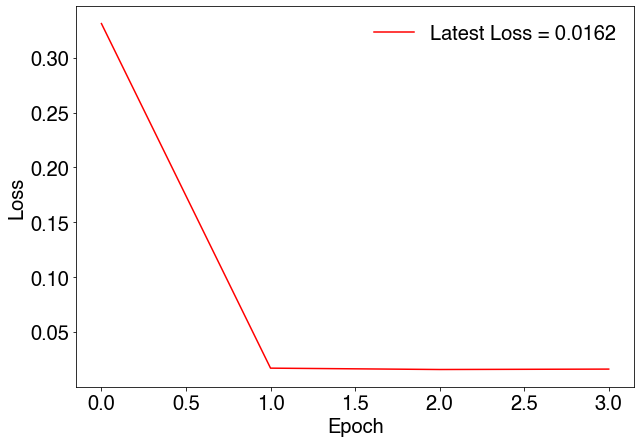

Current Epoch = 3
Latest Loss = 0.016198937064605925


KeyboardInterrupt: 

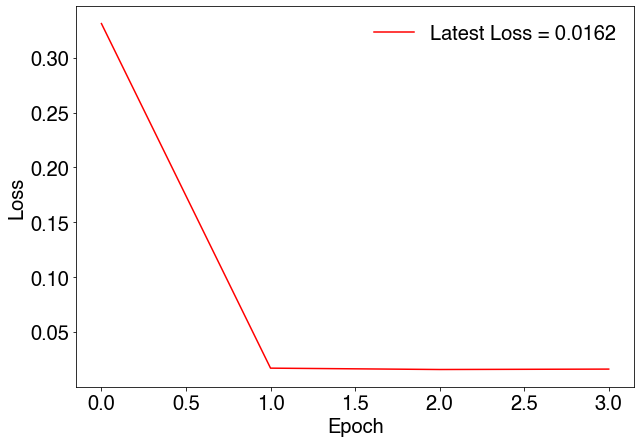

In [184]:
# Define dataset
torch_dataset = torch.utils.data.TensorDataset(X_scaled, y_scaled)

# def weights_init_uniform(m): # For initializing uniform weights
#     classname = m.__class__.__name__
#     # for every Linear layer in a model..
#     if classname.find('Linear') != -1:
#         # apply a uniform distribution to the weights and a bias=0
#         m.weight.data.uniform_(0.0, 1.0)
#         m.bias.data.fill_(0)

#Define a network
Q_net = torch.nn.Sequential(
        torch.nn.Linear(6,   200, bias = True), # 6 input nodes
        torch.nn.LeakyReLU(),    # apply ReLU activation function
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),    # apply ReLU activation function
        torch.nn.Linear(200,   1, bias = True), # 1 output node
    ).double()

# Q_net.apply(weights_init_uniform) # Initialize uniform weights

optimizer = torch.optim.Adam(Q_net.parameters(), lr = 1e-3) # Initialize Adam optimizer
loss_func = torch.nn.SmoothL1Loss()  # this is for regression mean squared loss

BATCH_SIZE = 1000 # Batch size
EPOCH      = 50   # No. of epochs

# Splitting dataset into batches
loader = torch.utils.data.DataLoader(dataset     = torch_dataset, 
                         batch_size  = BATCH_SIZE, 
                         shuffle     = True, 
                         num_workers = 0)

# my_images = []  # For saving into gif
fig, ax = plt.subplots(figsize=(10,7))

epoch_list = [] # Save epoch for plotting
loss_list  = [] # Save loss for plotting

# Start training
for epoch in range(EPOCH):
    epoch_list += [epoch]
    for step, (batch_x, batch_y) in enumerate(loader): # for each training step

        prediction = Q_net(batch_x.double())          # input x and predict based on x

        loss       = loss_func(prediction, batch_y) # must be (1. nn output, 2. target)

        optimizer.zero_grad()   # clear gradients for next train
        loss.backward()         # backpropagation, compute gradients
        optimizer.step()        # apply gradients

        if step == 1:
            # plot and show learning process
            plt.cla()
            loss_list += [loss.data.numpy()]
            plt.plot(epoch_list, loss_list, label = 'Latest Loss = %.4f' % loss.data.numpy(), color = 'r')
            plt.xlabel('Epoch', fontsize = 20)
            plt.ylabel('Loss', fontsize = 20)
            plt.xticks(fontsize = 20)
            plt.yticks(fontsize = 20)
            plt.legend(fontsize = 20, frameon= 0)
            
            display.clear_output(wait = True) #these two lines plots the data in real time
            display.display(fig)
            print('Current Epoch =', epoch)
            print('Latest Loss =', loss.data.numpy())

In [185]:
predictions = (Q_net(X_scaled).detach().numpy() * y_std_Q) + y_mean_Q
predictions[:10], y[:10]

(array([[0.0889363 ],
        [0.0809901 ],
        [0.07222995],
        [0.06733491],
        [0.06004787],
        [0.05666076],
        [0.0513346 ],
        [0.04686506],
        [0.04185438],
        [0.03423978]]),
 array([[0.08979388],
        [0.08081449],
        [0.07273304],
        [0.06545974],
        [0.05891376],
        [0.05302239],
        [0.04772015],
        [0.04294813],
        [0.03865332],
        [0.03478799]]))

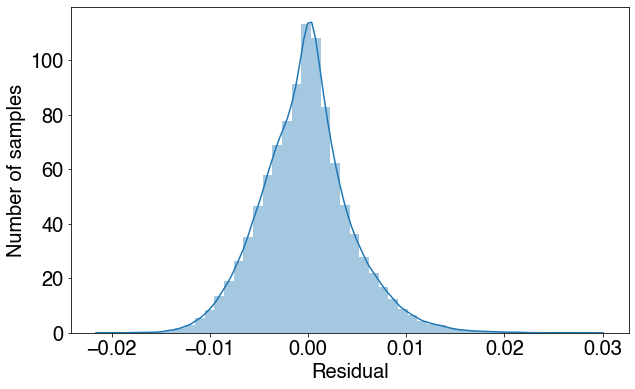

In [186]:
# Plot histogram of errors
residual = predictions - y
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(residual)
ax.set(xlabel= 'Residual', ylabel = 'Number of samples')
plt.show()

In [2751]:
score_NN_policy(GA_optimize, [1.0, 150.0, 0, 0], num_iterations = 20)

0.21132967139852585

## Training the UNCONSTRAINED Q-network

In [1427]:
# Initialize Q-network
Q_net = torch.nn.Sequential(
        torch.nn.Linear(6,   200, bias = True), # 6 input nodes
        torch.nn.LeakyReLU(),    # apply ReLU activation function
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),    # apply ReLU activation function
        torch.nn.Linear(200,   1, bias = True), # 1 output node
    ).double()

In [1429]:
# ========== 1) GENERATING INITIAL BATCH OF SAMPLES FOR REPLAY BUFFER ==========
epsilon       = 0.99
replay_buffer = collections.deque(maxlen = 3000) # Max capacity of 3000

for i in range(100): # Generate 100 episodes
    episode       = generate_episode_with_NN(NN = GA_optimize,
                                             initial_state = [1.0, 150.0, 0, 0],
                                             epsilon = epsilon)
    replay_buffer = update_replay_buffer(replay_buffer, episode, discount_factor = 0.9) # Add to replay buffer
print(len(replay_buffer))

# ================================= 2) TRAINING THE Q-NETWORK =================================
epsilon            = 0.99 # Initial epsilon
score_list         = [] # For plotting score of policy visited over time
iteration_list     = []
policy_mean_list   = [] # For plotting evolution of policy visited over time
policy_std_list    = [] # For plotting evolution of policy visited over time
training_loss_list = [] # For plotting loss of NN (after 20 epochs) over time
episode_bank       = [] # A list of list of lists - Tertiary list  -> Iterations
                        #                         - Secondary list -> Episodes
                        #                         - Primary list   -> Steps
                        #                         For plotting evolution of states visited over time            

for iteration in range(1000):
    # SCORE EXISTING POLICY
    print('=========== TRAINING ITERATION %.0f ===========' % iteration)
    print('Current epsilon = ', epsilon)
    current_score = score_NN_policy(GA_optimize, [1.0, 150.0, 0, 0], num_iterations = 10)
    print('AVERAGE SCORE = '  , current_score)
    print('')
    
    # GENERATE EPISODES & ADD TO REPLAY BUFFER
    for j in range(100):
        episode       = generate_episode_with_NN(NN = GA_optimize,
                                             initial_state = [1.0, 150.0, 0, 0],
                                             epsilon = epsilon)
        replay_buffer = update_replay_buffer(replay_buffer, episode, discount_factor = 0.9) # Add to replay buffer
    
    # SAMPLE EPISODES FROM REPLAY BUFFER
    combined_inputs  = [] # List of lists to be converted into input tensor
    combined_targets = [] # List to be converted into target tensor
    samples          = random.sample(replay_buffer, 100) # Draw random samples from replay buffer
    
    for inputs, target in samples:
        combined_inputs  += [inputs]
        combined_targets += [[target]]
    combined_inputs  = torch.tensor(combined_inputs)  # Convert list to tensor
    combined_targets = torch.tensor(combined_targets) # Convert list to tensor
    
    # TRAIN THE NEURAL NETWORK
    optimizer = torch.optim.Adam(Q_net.parameters(), lr=1e-3) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    

    for epoch in range(20):
        prediction = Q_net(combined_inputs)                    # Input x and predict based on x
        loss       = loss_func(prediction, combined_targets) # Must be (1. nn output, 2. target)

        optimizer.zero_grad()   # Clear gradients for next train
        loss.backward()         # Backpropagation, compute gradients
        optimizer.step()        # Apply gradients
#         print('Epoch = ', epoch, 'Loss = %.4f' % loss.data.numpy())

    score_list         += [current_score] # Store score for each iteration
    training_loss_list += [loss.data.numpy()]                                # Store training loss after 20 epochs for each iteration
    iteration_list     += [iteration]                                        # Store iteration
    
    # INVESTIGATING EVOLUTION OF POLICY OVER TRAINING ITERATIONS
    if iteration in np.arange(0,5000,10): # Every 10 iterations
        list_of_policies  = score_NN_policy(GA_optimize, [1.0, 150.0, 0, 0], num_iterations = 100, get_control = True)[1] # add policies
        policy_mean       = np.mean(list_of_policies, axis = 0) # Calculate mean of policies
        policy_std        = np.std(list_of_policies, axis = 0)  # Calculate std of policies
        policy_mean_list += [policy_mean] # Save mean policy for plotting
        policy_std_list  += [policy_std]  # Save std of policy for plotting
    
    # INVESTIGATING EVOLUTION OF STATES VISITED OVER TRAINING ITERATIONS
    if iteration in np.arange(0, 5000, 10): # Every 10 iterations
        pool_of_episodes = [] # A *list of lists* of episodes
        for i in range(10):   # Generate 10 sample episodes and store them
            pool_of_episodes += [generate_episode_with_NN(NN = GA_optimize,
                                             initial_state = [1.0, 150.0, 0, 0],
                                             epsilon = 0)]
        episode_bank         += [pool_of_episodes]
    
    epsilon *= 0.99 # Decay epsilon

1300
=========== TRAINING ITERATION 0 ===========
Current epsilon =  0.99
AVERAGE SCORE =  0.0469546594969021

=========== TRAINING ITERATION 1 ===========
Current epsilon =  0.9801
AVERAGE SCORE =  0.16681827477301764

=========== TRAINING ITERATION 2 ===========
Current epsilon =  0.9702989999999999
AVERAGE SCORE =  0.19205790737200937

=========== TRAINING ITERATION 3 ===========
Current epsilon =  0.96059601
AVERAGE SCORE =  0.18985025321303653

=========== TRAINING ITERATION 4 ===========
Current epsilon =  0.9509900498999999
AVERAGE SCORE =  0.18041386964774603

=========== TRAINING ITERATION 5 ===========
Current epsilon =  0.9414801494009999
AVERAGE SCORE =  0.15763484392269506

=========== TRAINING ITERATION 6 ===========
Current epsilon =  0.9320653479069899
AVERAGE SCORE =  0.17876313476791444

=========== TRAINING ITERATION 7 ===========
Current epsilon =  0.92274469442792
AVERAGE SCORE =  0.1879825664556811

=========== TRAINING ITERATION 8 ===========
Current epsilon =  0

=========== TRAINING ITERATION 68 ===========
Current epsilon =  0.4998370298991989
AVERAGE SCORE =  0.14499011185800872

=========== TRAINING ITERATION 69 ===========
Current epsilon =  0.49483865960020695
AVERAGE SCORE =  0.19109135181282338

=========== TRAINING ITERATION 70 ===========
Current epsilon =  0.4898902730042049
AVERAGE SCORE =  0.19266918256626392

=========== TRAINING ITERATION 71 ===========
Current epsilon =  0.48499137027416284
AVERAGE SCORE =  0.1827263907719213

=========== TRAINING ITERATION 72 ===========
Current epsilon =  0.4801414565714212
AVERAGE SCORE =  0.20556556462326245

=========== TRAINING ITERATION 73 ===========
Current epsilon =  0.475340042005707
AVERAGE SCORE =  0.18792382614325404

=========== TRAINING ITERATION 74 ===========
Current epsilon =  0.47058664158564995
AVERAGE SCORE =  0.11991360549959693

=========== TRAINING ITERATION 75 ===========
Current epsilon =  0.4658807751697934
AVERAGE SCORE =  0.20907992513573834

=========== TRAINING IT

=========== TRAINING ITERATION 135 ===========
Current epsilon =  0.2549097606963092
AVERAGE SCORE =  0.19598761962654887

=========== TRAINING ITERATION 136 ===========
Current epsilon =  0.2523606630893461
AVERAGE SCORE =  0.20643233414048603

=========== TRAINING ITERATION 137 ===========
Current epsilon =  0.24983705645845267
AVERAGE SCORE =  0.18109045547332098

=========== TRAINING ITERATION 138 ===========
Current epsilon =  0.24733868589386815
AVERAGE SCORE =  0.20132286763000637

=========== TRAINING ITERATION 139 ===========
Current epsilon =  0.24486529903492946
AVERAGE SCORE =  0.20272155205906506

=========== TRAINING ITERATION 140 ===========
Current epsilon =  0.24241664604458016
AVERAGE SCORE =  0.1732398984525862

=========== TRAINING ITERATION 141 ===========
Current epsilon =  0.23999247958413436
AVERAGE SCORE =  0.20665608134948737

=========== TRAINING ITERATION 142 ===========
Current epsilon =  0.23759255478829303
AVERAGE SCORE =  0.1908332305985928

=========== 

AVERAGE SCORE =  0.20037246469258174

=========== TRAINING ITERATION 202 ===========
Current epsilon =  0.13000034453500542
AVERAGE SCORE =  0.19177357707606135

=========== TRAINING ITERATION 203 ===========
Current epsilon =  0.12870034108965536
AVERAGE SCORE =  0.046627288519461005

=========== TRAINING ITERATION 204 ===========
Current epsilon =  0.12741333767875881
AVERAGE SCORE =  0.17289461487222185

=========== TRAINING ITERATION 205 ===========
Current epsilon =  0.12613920430197123
AVERAGE SCORE =  0.18844508288745707

=========== TRAINING ITERATION 206 ===========
Current epsilon =  0.12487781225895152
AVERAGE SCORE =  0.18439494697994932

=========== TRAINING ITERATION 207 ===========
Current epsilon =  0.123629034136362
AVERAGE SCORE =  0.180330619307194

=========== TRAINING ITERATION 208 ===========
Current epsilon =  0.12239274379499838
AVERAGE SCORE =  0.1700309922285809

=========== TRAINING ITERATION 209 ===========
Current epsilon =  0.1211688163570484
AVERAGE SCORE

=========== TRAINING ITERATION 268 ===========
Current epsilon =  0.066968002747864
AVERAGE SCORE =  0.21074476243223916

=========== TRAINING ITERATION 269 ===========
Current epsilon =  0.06629832272038537
AVERAGE SCORE =  0.20237130507933804

=========== TRAINING ITERATION 270 ===========
Current epsilon =  0.06563533949318151
AVERAGE SCORE =  0.2065661430709293

=========== TRAINING ITERATION 271 ===========
Current epsilon =  0.06497898609824969
AVERAGE SCORE =  0.20910766967862848

=========== TRAINING ITERATION 272 ===========
Current epsilon =  0.0643291962372672
AVERAGE SCORE =  0.20704087901108995

=========== TRAINING ITERATION 273 ===========
Current epsilon =  0.06368590427489453
AVERAGE SCORE =  0.20722168868023552

=========== TRAINING ITERATION 274 ===========
Current epsilon =  0.06304904523214558
AVERAGE SCORE =  0.19556671777952297

=========== TRAINING ITERATION 275 ===========
Current epsilon =  0.06241855477982412
AVERAGE SCORE =  0.20425263981791955

=========== 

AVERAGE SCORE =  0.20104055559055017

=========== TRAINING ITERATION 335 ===========
Current epsilon =  0.03415272685621234
AVERAGE SCORE =  0.19942217510100232

=========== TRAINING ITERATION 336 ===========
Current epsilon =  0.03381119958765021
AVERAGE SCORE =  0.187965981685881

=========== TRAINING ITERATION 337 ===========
Current epsilon =  0.03347308759177371
AVERAGE SCORE =  0.2061193898832568

=========== TRAINING ITERATION 338 ===========
Current epsilon =  0.03313835671585597
AVERAGE SCORE =  0.19933948174270813

=========== TRAINING ITERATION 339 ===========
Current epsilon =  0.03280697314869741
AVERAGE SCORE =  0.20771141166906712

=========== TRAINING ITERATION 340 ===========
Current epsilon =  0.032478903417210436
AVERAGE SCORE =  0.1753608385010424

=========== TRAINING ITERATION 341 ===========
Current epsilon =  0.032154114383038335
AVERAGE SCORE =  0.20691204133620006

=========== TRAINING ITERATION 342 ===========
Current epsilon =  0.03183257323920795
AVERAGE SC

AVERAGE SCORE =  0.20449874225409914

=========== TRAINING ITERATION 401 ===========
Current epsilon =  0.017593337264871736
AVERAGE SCORE =  0.20666303482484077

=========== TRAINING ITERATION 402 ===========
Current epsilon =  0.01741740389222302
AVERAGE SCORE =  0.20791857397087585

=========== TRAINING ITERATION 403 ===========
Current epsilon =  0.01724322985330079
AVERAGE SCORE =  0.018461449446759703

=========== TRAINING ITERATION 404 ===========
Current epsilon =  0.017070797554767782
AVERAGE SCORE =  0.20763752526957982

=========== TRAINING ITERATION 405 ===========
Current epsilon =  0.016900089579220106
AVERAGE SCORE =  0.2086089471643548

=========== TRAINING ITERATION 406 ===========
Current epsilon =  0.016731088683427906
AVERAGE SCORE =  0.207874782331263

=========== TRAINING ITERATION 407 ===========
Current epsilon =  0.016563777796593626
AVERAGE SCORE =  0.208491827291342

=========== TRAINING ITERATION 408 ===========
Current epsilon =  0.016398140018627688
AVERAG

AVERAGE SCORE =  0.20760825137800382

=========== TRAINING ITERATION 467 ===========
Current epsilon =  0.009062981044490808
AVERAGE SCORE =  0.2081075821107287

=========== TRAINING ITERATION 468 ===========
Current epsilon =  0.0089723512340459
AVERAGE SCORE =  0.20608738668856366

=========== TRAINING ITERATION 469 ===========
Current epsilon =  0.00888262772170544
AVERAGE SCORE =  0.2087566524153436

=========== TRAINING ITERATION 470 ===========
Current epsilon =  0.008793801444488386
AVERAGE SCORE =  0.2088697832124855

=========== TRAINING ITERATION 471 ===========
Current epsilon =  0.008705863430043502
AVERAGE SCORE =  0.21027367606766276

=========== TRAINING ITERATION 472 ===========
Current epsilon =  0.008618804795743068
AVERAGE SCORE =  0.20515877237480568

=========== TRAINING ITERATION 473 ===========
Current epsilon =  0.008532616747785637
AVERAGE SCORE =  0.20747332062609553

=========== TRAINING ITERATION 474 ===========
Current epsilon =  0.00844729058030778
AVERAGE

AVERAGE SCORE =  0.21072660204234

=========== TRAINING ITERATION 533 ===========
Current epsilon =  0.004668677930525566
AVERAGE SCORE =  0.21122025610946177

=========== TRAINING ITERATION 534 ===========
Current epsilon =  0.00462199115122031
AVERAGE SCORE =  0.20974069582616095

=========== TRAINING ITERATION 535 ===========
Current epsilon =  0.004575771239708107
AVERAGE SCORE =  0.21145900400775947

=========== TRAINING ITERATION 536 ===========
Current epsilon =  0.004530013527311026
AVERAGE SCORE =  0.20963145872900749

=========== TRAINING ITERATION 537 ===========
Current epsilon =  0.004484713392037916
AVERAGE SCORE =  0.20871608458265728

=========== TRAINING ITERATION 538 ===========
Current epsilon =  0.004439866258117537
AVERAGE SCORE =  0.21132278700480325

=========== TRAINING ITERATION 539 ===========
Current epsilon =  0.004395467595536362
AVERAGE SCORE =  0.21017113992695027

=========== TRAINING ITERATION 540 ===========
Current epsilon =  0.004351512919580998
AVER

AVERAGE SCORE =  0.2093140501580144

=========== TRAINING ITERATION 599 ===========
Current epsilon =  0.002405009291311067
AVERAGE SCORE =  0.21086975085021073

=========== TRAINING ITERATION 600 ===========
Current epsilon =  0.0023809591983979563
AVERAGE SCORE =  0.2113904384886678

=========== TRAINING ITERATION 601 ===========
Current epsilon =  0.0023571496064139765
AVERAGE SCORE =  0.21007166968476326

=========== TRAINING ITERATION 602 ===========
Current epsilon =  0.0023335781103498367
AVERAGE SCORE =  0.2104672490807626

=========== TRAINING ITERATION 603 ===========
Current epsilon =  0.002310242329246338
AVERAGE SCORE =  0.21033370630311882

=========== TRAINING ITERATION 604 ===========
Current epsilon =  0.002287139905953875
AVERAGE SCORE =  0.21054415062685541

=========== TRAINING ITERATION 605 ===========
Current epsilon =  0.0022642685068943362
AVERAGE SCORE =  0.2099763011637478

=========== TRAINING ITERATION 606 ===========
Current epsilon =  0.002241625821825393


AVERAGE SCORE =  0.21005227810572485

=========== TRAINING ITERATION 665 ===========
Current epsilon =  0.0012389095537034477
AVERAGE SCORE =  0.21031491714524644

=========== TRAINING ITERATION 666 ===========
Current epsilon =  0.0012265204581664133
AVERAGE SCORE =  0.21112732845251053

=========== TRAINING ITERATION 667 ===========
Current epsilon =  0.0012142552535847491
AVERAGE SCORE =  0.21075533238213923

=========== TRAINING ITERATION 668 ===========
Current epsilon =  0.0012021127010489016
AVERAGE SCORE =  0.21101650125520152

=========== TRAINING ITERATION 669 ===========
Current epsilon =  0.0011900915740384126
AVERAGE SCORE =  0.21095368646002655

=========== TRAINING ITERATION 670 ===========
Current epsilon =  0.0011781906582980285
AVERAGE SCORE =  0.21085091528119343

=========== TRAINING ITERATION 671 ===========
Current epsilon =  0.0011664087517150481
AVERAGE SCORE =  0.21095719547080405

=========== TRAINING ITERATION 672 ===========
Current epsilon =  0.001154744664

=========== TRAINING ITERATION 730 ===========
Current epsilon =  0.0006446548446905099
AVERAGE SCORE =  0.21129893415219456

=========== TRAINING ITERATION 731 ===========
Current epsilon =  0.0006382082962436048
AVERAGE SCORE =  0.21141170892381167

=========== TRAINING ITERATION 732 ===========
Current epsilon =  0.0006318262132811687
AVERAGE SCORE =  0.211325272027935

=========== TRAINING ITERATION 733 ===========
Current epsilon =  0.000625507951148357
AVERAGE SCORE =  0.21161544657393166

=========== TRAINING ITERATION 734 ===========
Current epsilon =  0.0006192528716368734
AVERAGE SCORE =  0.21134544764650348

=========== TRAINING ITERATION 735 ===========
Current epsilon =  0.0006130603429205046
AVERAGE SCORE =  0.2116032931666504

=========== TRAINING ITERATION 736 ===========
Current epsilon =  0.0006069297394912996
AVERAGE SCORE =  0.2117574610722539

=========== TRAINING ITERATION 737 ===========
Current epsilon =  0.0006008604420963866
AVERAGE SCORE =  0.2115666701780454

AVERAGE SCORE =  0.21156848209156381

=========== TRAINING ITERATION 796 ===========
Current epsilon =  0.00033208563842715866
AVERAGE SCORE =  0.21172827481566836

=========== TRAINING ITERATION 797 ===========
Current epsilon =  0.0003287647820428871
AVERAGE SCORE =  0.2107966511379626

=========== TRAINING ITERATION 798 ===========
Current epsilon =  0.00032547713422245825
AVERAGE SCORE =  0.21169908056548975

=========== TRAINING ITERATION 799 ===========
Current epsilon =  0.00032222236288023367
AVERAGE SCORE =  0.21135760296421405

=========== TRAINING ITERATION 800 ===========
Current epsilon =  0.00031900013925143135
AVERAGE SCORE =  0.21117413230927246

=========== TRAINING ITERATION 801 ===========
Current epsilon =  0.000315810137858917
AVERAGE SCORE =  0.21132857310765857

=========== TRAINING ITERATION 802 ===========
Current epsilon =  0.00031265203648032783
AVERAGE SCORE =  0.19376442471358227

=========== TRAINING ITERATION 803 ===========
Current epsilon =  0.000309525

AVERAGE SCORE =  0.21193954756885472

=========== TRAINING ITERATION 861 ===========
Current epsilon =  0.0001727976146638485
AVERAGE SCORE =  0.21152636429716973

=========== TRAINING ITERATION 862 ===========
Current epsilon =  0.00017106963851721
AVERAGE SCORE =  0.2113786987388974

=========== TRAINING ITERATION 863 ===========
Current epsilon =  0.0001693589421320379
AVERAGE SCORE =  0.21105830588625607

=========== TRAINING ITERATION 864 ===========
Current epsilon =  0.00016766535271071751
AVERAGE SCORE =  0.2118100813898281

=========== TRAINING ITERATION 865 ===========
Current epsilon =  0.00016598869918361034
AVERAGE SCORE =  0.21207468891859982

=========== TRAINING ITERATION 866 ===========
Current epsilon =  0.00016432881219177425
AVERAGE SCORE =  0.2061149751454371

=========== TRAINING ITERATION 867 ===========
Current epsilon =  0.0001626855240698565
AVERAGE SCORE =  0.2116392713333588

=========== TRAINING ITERATION 868 ===========
Current epsilon =  0.000161058668829

AVERAGE SCORE =  0.21148865692800517

=========== TRAINING ITERATION 926 ===========
Current epsilon =  8.991360112691314e-05
AVERAGE SCORE =  0.21136074062071253

=========== TRAINING ITERATION 927 ===========
Current epsilon =  8.901446511564401e-05
AVERAGE SCORE =  0.21137258371632045

=========== TRAINING ITERATION 928 ===========
Current epsilon =  8.812432046448757e-05
AVERAGE SCORE =  0.21122309126124733

=========== TRAINING ITERATION 929 ===========
Current epsilon =  8.72430772598427e-05
AVERAGE SCORE =  0.21163699002445174

=========== TRAINING ITERATION 930 ===========
Current epsilon =  8.637064648724426e-05
AVERAGE SCORE =  0.21126158194708125

=========== TRAINING ITERATION 931 ===========
Current epsilon =  8.550694002237182e-05
AVERAGE SCORE =  0.21188241673232772

=========== TRAINING ITERATION 932 ===========
Current epsilon =  8.46518706221481e-05
AVERAGE SCORE =  0.2121672750438774

=========== TRAINING ITERATION 933 ===========
Current epsilon =  8.380535191592662

=========== TRAINING ITERATION 991 ===========
Current epsilon =  4.678569020374915e-05
AVERAGE SCORE =  0.21174987079748106

=========== TRAINING ITERATION 992 ===========
Current epsilon =  4.6317833301711654e-05
AVERAGE SCORE =  0.21135094346972277

=========== TRAINING ITERATION 993 ===========
Current epsilon =  4.585465496869454e-05
AVERAGE SCORE =  0.21141235796553265

=========== TRAINING ITERATION 994 ===========
Current epsilon =  4.5396108419007594e-05
AVERAGE SCORE =  0.21088885583500255

=========== TRAINING ITERATION 995 ===========
Current epsilon =  4.494214733481752e-05
AVERAGE SCORE =  0.21154166104775074

=========== TRAINING ITERATION 996 ===========
Current epsilon =  4.449272586146935e-05
AVERAGE SCORE =  0.2112963030776213

=========== TRAINING ITERATION 997 ===========
Current epsilon =  4.404779860285465e-05
AVERAGE SCORE =  0.21153776693169882

=========== TRAINING ITERATION 998 ===========
Current epsilon =  4.36073206168261e-05
AVERAGE SCORE =  0.21152043007

In [2975]:
# # Save neural network
# torch.save(Q_net, './NN_models/CS1_Q_net_unconstrained')

# # Load pre-trained neural network
# Q_net = torch.load('./NN_models/CS1_Q_net_unconstrained')
# Q_net.eval()

Sequential(
  (0): Linear(in_features=6, out_features=200, bias=True)
  (1): LeakyReLU(negative_slope=0.01)
  (2): Linear(in_features=200, out_features=200, bias=True)
  (3): LeakyReLU(negative_slope=0.01)
  (4): Linear(in_features=200, out_features=1, bias=True)
)

No handles with labels found to put in legend.


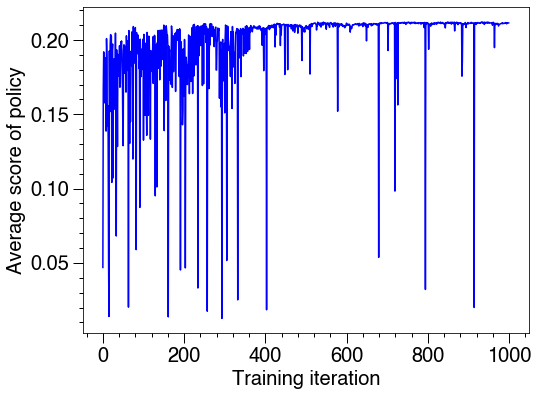

No handles with labels found to put in legend.


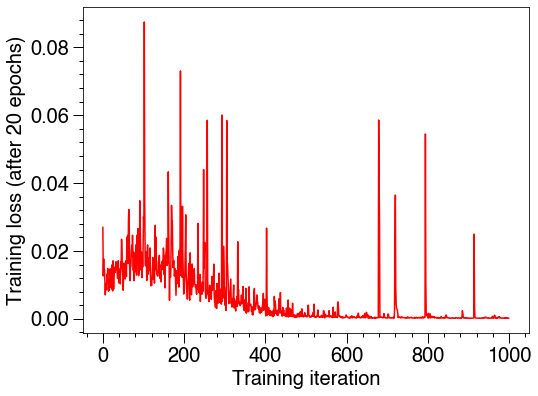

In [2753]:
# Save data
# with open('./Data/CS1_score_GA_unconstrained', 'wb') as f:
#     pickle.dump(score_list, f, pickle.HIGHEST_PROTOCOL)
# with open('./Data/CS1_loss_GA_unconstrained', 'wb') as f:
#     pickle.dump(training_loss_list, f, pickle.HIGHEST_PROTOCOL)

# Load pre-run data
# with open('./Data/CS1_score_GA_unconstrained', 'rb') as f:
#     score_list = pickle.load(f)
# with open('./Data/CS1_loss_GA_unconstrained', 'rb') as f:
#     training_loss_list = pickle.load(f)

# Plot score vs. training iteration
fig, ax = plt.subplots(figsize=(8,6))
ax.minorticks_on()
ax.xaxis.set_minor_locator(AutoMinorLocator(5))
ax.yaxis.set_minor_locator(AutoMinorLocator(5))
ax.tick_params(which='major', length=10, width=1, direction='out')
ax.tick_params(which='minor', length=4, width=1, direction='out')
plt.plot(iteration_list, score_list, color = 'b')
plt.legend(frameon =  0)
plt.ylabel('Average score of policy', fontsize = 20)
plt.xlabel('Training iteration', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

# Plot training loss vs. training iteration
fig, ax = plt.subplots(figsize=(8,6))
ax.minorticks_on()
ax.xaxis.set_minor_locator(AutoMinorLocator(5))
ax.yaxis.set_minor_locator(AutoMinorLocator(5))
ax.tick_params(which='major', length=10, width=1, direction='out')
ax.tick_params(which='minor', length=4, width=1, direction='out')
plt.plot(iteration_list, training_loss_list, color = 'r')
plt.legend(frameon =  0)
plt.ylabel('Training loss (after 20 epochs)', fontsize = 20)
plt.xlabel('Training iteration', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

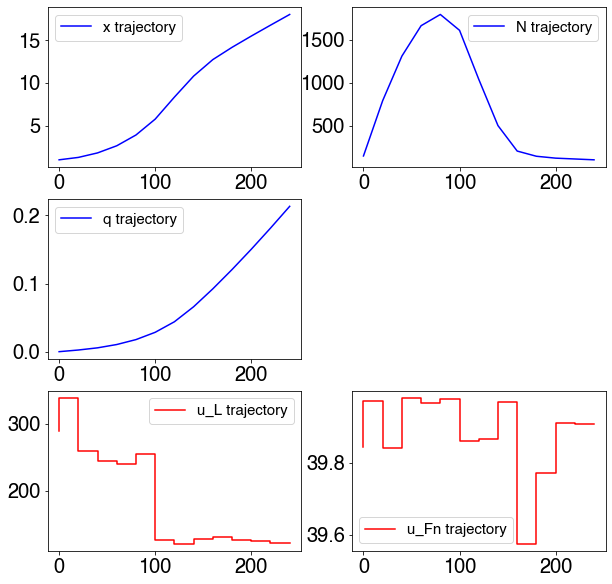

Score: 0.2132957972354426


In [3089]:
episode = generate_episode_with_NN(NN = max_action, initial_state = [1.0, 150.0, 0, 0], epsilon = 0)
plot_episode(episode) 

In [1298]:
score_NN_policy(GA_optimize, [1.0, 150.0, 0, 0], num_iterations = 100)

0.20795865725499407

## Genetic algorithm

In [216]:
# Source: Ahmed Gad - https://github.com/ahmedfgad/GeneticAlgorithmPython/tree/master/Tutorial%20Project
def cal_pop_fitness(population, initial_state):
    # Calculating the fitness value of each solution in the current population.
    # The fitness function calulates the sum of products between each input and its corresponding weight.
    state = []
    population = population.tolist() # convert 2D array to list of lists
    for i in range(len(population)):
        s = initial_state + population[i] # Append action to state 
        s = standardize_state_Q(s) # Standardize
        state += [s]
    state = torch.tensor(state).double()
    fitness = Q_net(state).detach().numpy()
    return fitness

def cal_pop_fitness_constrained(population, initial_state, g1_threshold, g2_threshold, g3_threshold):
    # Calculating the fitness value of each solution in the current population.
    # The fitness function calulates the sum of products between each input and its corresponding weight.
    
    # CALCULATE Q-FITNESS
    state = []
    population = population.tolist() # convert 2D array to list of lists
    for i in range(len(population)):
        s = initial_state + population[i] # Append action to state 
        s = standardize_state_Q(s) # Standardize using Q-network mean & std
        state += [s]
    state = torch.tensor(state).double()
    fitness_Q = (Q_net(state).detach().numpy() * y_std_Q) + y_mean_Q # Unstandardized Q-network fitness
#     print('fitness_Q:', fitness_Q)
    # CALCULATE C-FITNESS 
    state = []
    
    initial_state_for_C = copy.deepcopy(initial_state) 
    initial_state_for_C[3] = 240. - initial_state_for_C[3] #### NEED TO TRANSFORM T TO T_F- T #####
#     print('population:', population)
    for i in range(len(population)):
        s = initial_state_for_C + population[i] # Append action to state 
#         print('non-standardized state:',s)
        s = standardize_state_C(s) # Standardize using C-network mean & std
#         print('standardized state:',s)
        state += [s]
    state = torch.tensor(state).double()
    state_copy = copy.deepcopy(state) # Just to be sure
    state_copy2 = copy.deepcopy(state) # Just to be sure
    
    fitness_g1 = -1*((g1_net(state).detach().numpy() * y_std_C[0]) + y_mean_C[0])  # Unstandardized C-network fitness - NEGATIVE SIGN because -ve g1_net values denote higher fitness!
    fitness_g2 = -1*((g2_net(state_copy).detach().numpy() * y_std_C[1]) + y_mean_C[1])
    fitness_g3 = -1*((g3_net(state_copy2).detach().numpy() * y_std_C[2]) + y_mean_C[2])
#     print('fitness_g1:', fitness_g1)
#     print('fitness_g2:', fitness_g2)
#     print('fitness_g3:', fitness_g3)
    # COMBINE Q-FITNESS AND C-FITNESS
    fitness_overall = []
    for i in range(len(population)):
        
        # include gl and g2 only for now
        f = max(0, fitness_Q[i].item()) + 100*min(0, fitness_g1[i].item() + g1_threshold) + 10000*min(0, fitness_g2[i].item() + g2_threshold) + 100*min(0, fitness_g3[i].item() + g3_threshold)
        fitness_overall += [f]
    
    return fitness_overall

def select_mating_pool(pop, fitness, num_parents):
    # Selecting the best individuals in the current generation as parents for producing the offspring of the next generation.
    parents = np.empty((num_parents, pop.shape[1]))
    for parent_num in range(num_parents):
        max_fitness_idx = np.where(fitness == np.max(fitness))
        max_fitness_idx = max_fitness_idx[0][0]
        parents[parent_num, :] = pop[max_fitness_idx, :]
        fitness[max_fitness_idx] = -99999999999     # Make the current parent the most unfit
    return parents

def crossover(parents, offspring_size):
    offspring = np.empty(offspring_size)
    # The point at which crossover takes place between two parents. Usually, it is at the center.
    crossover_point = np.uint8(offspring_size[1]/2) # Returns 1 in this case (because 2 values)

    for k in range(offspring_size[0]):
        # Index of the first parent to mate.
        parent1_idx = k%parents.shape[0]
        # Index of the second parent to mate.
        parent2_idx = (k+1)%parents.shape[0]
        # The new offspring will have its first half of its genes taken from the first parent.
        offspring[k, 0:crossover_point] = parents[parent1_idx, 0:crossover_point]
        # The new offspring will have its second half of its genes taken from the second parent.
        offspring[k, crossover_point:] = parents[parent2_idx, crossover_point:]
    return offspring

def mutation(offspring_crossover, mut_percen):

    for idx in range(offspring_crossover.shape[0]): # Iterate over individual offspring
        for feature in range(offspring_crossover.shape[1]): # Iterate over its features 
            r = np.random.uniform(0, 1)
            
            if r < mut_percen: # If mutation occurs
#                 print('Mutated')
                if feature == 0: # If u_L 
                    offspring_crossover[idx, feature] = np.random.uniform(120, 400) # Pick random u_L
                else:            # Else u_Fn
                    offspring_crossover[idx, feature] = np.random.uniform(0, 40) # Pick random u_Fn
    return offspring_crossover

def generate_random_episode_constrained(initial_state, g1_threshold = 0): 
    '''Generates an episode using RANDOM policy
    threshold is the tolerance of the limit, where 
    0            : Limit itself (as per defined in extract_constraint_values_from_episode() function)
    +ve threshold: Looser limit   
    -ve threshold: Stricter limit 
    '''
    episode = []
    state = initial_state  # Initial state
    for i in range(13):   # Take (12 + 1) steps
        predicted_c = np.inf # Initialize constraint
        while predicted_c > g1_threshold: # Keep choosing a different action this until constraint is LESS THAN zero
            old_state = state # Old state for storing into episode
            old_state_without_action = old_state
            old_state = list(old_state)
            old_state[3] = 240.0 - old_state[3] # Convert to t to (t - t_f)
            u_L  = np.random.uniform(120, 400) # Pick random u_L
            u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
            action = [u_L, u_Fn]
            old_state += action     # Append action to state

            old_state_standardized = old_state.copy()
            old_state_standardized = standardize_state_C(old_state_standardized)

            old_state_standardized = torch.tensor(old_state_standardized)
            predicted_c = ((g1_net(old_state_standardized).detach().numpy())*y_std_C) + y_mean_C # Update predicted constraint
#             print('predicted_c:', predicted_c)
        state, reward  = transition(state, action)     # Evolve to get new state 
        episode       += [[list(old_state_without_action), action, reward]] # Update step
    return episode
# generate_random_episode_constrained(initial_state = [1.0,150.0,0.,0.], g1_threshold = 0)

def GA_optimize(state, mut_percen = 0.1):
    '''Argument: State [Cx, Cn, Cq, t]
       Output: Control [u_L, u_Fn] that maximizes Q 
    '''
    num_features       = 2  # Number of features (u_L and u_Fn)
    sol_per_pop        = 10 # Number of individuals per population
    num_parents_mating = 5  # Numbers of parents selected from each generation
    num_generations    = 10 # Number of generations
    
    mut_percen = mut_percen # Initial probability of mutation

    #Creating the initial population.
    new_pop = []
    for i in range(200): # Initial pop
        u_L  = np.random.uniform(120, 400) # Pick random u_L
        u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
        new_pop += [[u_L, u_Fn]]
    new_pop = np.array(new_pop)
#     print('new_pop',new_pop)

    decay_factor = (0.01/mut_percen)**(1/num_generations) # Define decay factor for mut_percen

    state = state
    avg_fitness_list = [] # Store average fitness scores
    max_fitness_list = [] # Store max fitness scores
    generation_list = []  # Store generation index

    for generation in range(num_generations):
        
        # Measuring the fitness of each chromosome in the population.
        fitness = cal_pop_fitness(new_pop, state)

        avg_fit = np.mean(fitness) # Average fitness
        max_fit = np.max(fitness)  # Max fitness of the generation
    #     print('==== Generation %.0f ====' % generation)
    #     print('Average fitness:', avg_fit)
    #     print('Max fitness:', max_fit)
    #     print('')
        avg_fitness_list += [avg_fit]    # Save average fitness score for plotting
        max_fitness_list += [max_fit]    # Save average fitness score for plotting
        generation_list  += [generation] # Save generation index

        # Selecting the best parents in the population for mating
        parents = select_mating_pool(new_pop, fitness, num_parents_mating)
#         print('parents:',parents)

        # Generating next generation using crossover
        offspring_crossover = crossover(parents, offspring_size=(sol_per_pop-parents.shape[0], num_features))
#         print('offspring_crossover',offspring_crossover)

        offspring_mutation = mutation(offspring_crossover, mut_percen = mut_percen)
#         print('offspring_mutation',offspring_mutation)

        # Creating the new population based on the parents and offspring
        new_pop[0:parents.shape[0], :] = parents
        new_pop[parents.shape[0]:sol_per_pop, :] = offspring_mutation

        # Cull excess initial population
        new_pop = new_pop[0:sol_per_pop,:]

    #     mut_percen = 0.5*e**(-1*generation/(num_generations/3)) # Decay
        mut_percen *= decay_factor
    
    max_action = new_pop[0] # Select the fittest action from final population
    return max_action
# GA_optimize([1.0, 150.0, 0, 0], mut_percen = 0.25) # Test function

# def GA_optimize_constrained(state, g1_threshold, g2_threshold, g3_threshold, init_mut_percen = 0.01):
#     '''Argument: State [Cx, Cn, Cq, t]
#        Output: Control [u_L, u_Fn] that maximizes Q and avoids violation of constraints
#     '''
#     num_features       = 2  # Number of features (u_L and u_Fn)
#     sol_per_pop        = 10 # Number of individuals per population
#     num_parents_mating = 5  # Numbers of parents selected from each generation
#     num_generations    = 10 # Number of generations
    
#     max_fitness = -np.inf # Initialize fitness
    
#     while max_fitness < 0: # Keep running this loop until no violations (no -ve fitness) occurs
    
#         mut_percen = init_mut_percen # Initial probability of mutation

#         #Creating the initial population.
#         new_pop = []
#         for i in range(200): # Initial pop
#             u_L  = np.random.uniform(120, 400) # Pick random u_L
#             u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
#             new_pop += [[u_L, u_Fn]]
#         new_pop = np.array(new_pop)
#     #     print('new_pop',new_pop)

#         decay_factor = (0.01/mut_percen)**(1/num_generations) # Define decay factor for mut_percen

#         state = state
#         avg_fitness_list = [] # Store average fitness scores
#         max_fitness_list = [] # Store max fitness scores
#         generation_list = []  # Store generation index

#         for generation in range(num_generations):

#             # Measuring the fitness of each chromosome in the population.
#             fitness = cal_pop_fitness_constrained(new_pop, state, g1_threshold = g1_threshold, g2_threshold = g2_threshold, g3_threshold = g3_threshold)

#             avg_fit = np.mean(fitness) # Average fitness
#             max_fit = np.max(fitness)  # Max fitness of the generation
#         #     print('==== Generation %.0f ====' % generation)
#         #     print('Average fitness:', avg_fit)
#         #     print('Max fitness:', max_fit)
#         #     print('')
#             avg_fitness_list += [avg_fit]    # Save average fitness score for plotting
#             max_fitness_list += [max_fit]    # Save average fitness score for plotting
#             generation_list  += [generation] # Save generation index

#             # Selecting the best parents in the population for mating
#             parents = select_mating_pool(new_pop, fitness, num_parents_mating)
#     #         print('parents:',parents)

#             # Generating next generation using crossover
#             offspring_crossover = crossover(parents, offspring_size=(sol_per_pop-parents.shape[0], num_features))
#     #         print('offspring_crossover',offspring_crossover)

#             offspring_mutation = mutation(offspring_crossover, mut_percen = mut_percen)
#     #         print('offspring_mutation',offspring_mutation)

#             # Creating the new population based on the parents and offspring
#             new_pop[0:parents.shape[0], :] = parents
#             new_pop[parents.shape[0]:sol_per_pop, :] = offspring_mutation

#             # Cull excess initial population
#             new_pop = new_pop[0:sol_per_pop,:]

#         #     mut_percen = 0.5*e**(-1*generation/(num_generations/3)) # Decay
#     #         mut_percen *= decay_factor

#         max_action = new_pop[0] # Select the fittest action from final population
#         max_fitness = max_fitness_list[-1] # Update max_fitness
# #     plt.figure()
# #     plt.plot(generation_list, avg_fitness_list, label = 'Avg (%.3f)'%avg_fitness_list[-1])
# #     plt.plot(generation_list, max_fitness_list, label = 'Max (%.3f)'%max_fitness_list[-1])
# #     plt.legend()
# #     plt.show()
# #     print(max_fitness)
    
#     return max_action
# GA_optimize_constrained([1.0, 150.0, 0, 0], g1_threshold = g1_threshold, g2_threshold = g2_threshold, g3_threshold = g3_threshold ) # Test function

def GA_optimize_constrained(state, g1_threshold, g2_threshold, g3_threshold, init_mut_percen = 0.01):
    '''Argument: State [Cx, Cn, Cq, t]
       Output: Control [u_L, u_Fn] that maximizes Q and avoids violation of constraints
    '''
    max_fitness = -np.inf # Initialize fitness
    
    while max_fitness < 0: # Keep running this loop until no violations (no -ve fitness) occurs
    
        #Creating the initial population.
        new_pop = []
        for i in range(1000): # Initial pop
            u_L  = np.random.uniform(120, 400) # Pick random u_L
            u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
            new_pop += [[u_L, u_Fn]]
            
        new_pop = np.array(new_pop)

        fitness = cal_pop_fitness_constrained(new_pop, state, g1_threshold = g1_threshold, g2_threshold = g2_threshold, g3_threshold = g3_threshold)
        max_idx = np.argmax(fitness)
        max_action  = new_pop[max_idx]
        max_fitness = fitness[max_idx]
            
    return max_action
# GA_optimize_constrained([1.0, 150.0, 0, 0], g1_threshold = 1000, g2_threshold = 100, g3_threshold = 0) # Test function

In [4]:
episode = generate_episode_with_NN(GA_optimize_constrained, [1.0, 150.0, 0, 0], epsilon = 0, 
                                   g1_threshold = g1_threshold,
                                   g2_threshold = g2_threshold,
                                   g3_threshold = g3_threshold)
episode

NameError: name 'g1_threshold' is not defined

In [198]:
#test constrained
sol_per_pop = 200 # Number of individuals per population
num_features = 2 # Number of features (u_L and u_Fn)
num_parents_mating = 2
num_generations = 10
mut_percen = 0.1
state = [1.0, 150.0, 0, 0]
new_pop = []
for i in range(sol_per_pop): # Initial pop
    u_L  = np.random.uniform(120, 400) # Pick random u_L
    u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
    new_pop += [[u_L, u_Fn]]
new_pop = np.array(new_pop)
print(new_pop)

[[2.90501593e+02 3.32958527e+01]
 [2.56130422e+02 3.68743436e+01]
 [1.51336251e+02 2.05648612e+01]
 [2.96532242e+02 2.10378688e+01]
 [3.85114739e+02 1.20026221e+01]
 [1.99573064e+02 2.25625692e+01]
 [3.53666164e+02 2.46340889e+01]
 [1.57746374e+02 3.70889923e+01]
 [1.74408826e+02 1.63251833e+01]
 [2.22864569e+02 1.72368641e+01]
 [1.20675689e+02 1.76337161e+01]
 [1.72425592e+02 7.31148459e+00]
 [3.55106669e+02 3.50578643e+01]
 [3.69016905e+02 1.01584263e+01]
 [3.12084129e+02 3.74700766e+01]
 [3.52792244e+02 2.82593768e+01]
 [3.88474342e+02 2.56678244e-01]
 [2.25795159e+02 9.05828478e+00]
 [2.76509869e+02 1.12371222e+01]
 [3.60019174e+02 3.35586165e+01]
 [2.14108049e+02 3.07723058e+01]
 [1.42333950e+02 8.45884690e+00]
 [2.30331716e+02 3.88056169e+01]
 [1.99536087e+02 1.90951678e+01]
 [1.72566659e+02 2.88811679e+01]
 [1.95612083e+02 1.00127299e+01]
 [3.70376444e+02 4.07280711e+00]
 [3.74610362e+02 2.42368420e+01]
 [3.29736393e+02 3.80545126e+01]
 [3.52563651e+02 2.79459949e+01]
 [3.745890

In [199]:
fitness = cal_pop_fitness_constrained(new_pop, [1.0, 150.0, 0, 0], 
                                      g1_threshold = 500, 
                                      g2_threshold = 0.004,
                                      g3_threshold = 0)
fitness

fitness_g3: [[ 45.64637479]
 [ 53.58504415]
 [ 44.40426794]
 [ 79.92341197]
 [  0.40265995]
 [ 99.38168584]
 [ 74.31563997]
 [113.61205093]
 [ 67.52119058]
 [ 96.19610926]
 [109.72764065]
 [ 86.06943768]
 [106.27081072]
 [ 42.3791798 ]
 [ 64.78355205]
 [ 54.91645266]
 [ 21.745923  ]
 [ 32.81445616]
 [ 43.2761719 ]
 [ 84.21836367]
 [ 83.139136  ]
 [155.87070528]
 [ 90.34056069]
 [ 78.45130317]
 [ 73.15007892]
 [ 79.5448245 ]
 [ 21.85957945]
 [122.28888172]
 [ 93.15656154]
 [ 55.39134523]
 [155.19644876]
 [ 24.61992617]
 [ 57.85693659]
 [ 70.07778513]
 [126.1711054 ]
 [ 60.19925476]
 [ 62.99864157]
 [ 96.39044917]
 [ 36.8102621 ]
 [ 50.29056279]
 [102.56526619]
 [ 36.48087746]
 [ 94.16522017]
 [ 72.79935364]
 [ 56.69081272]
 [ 60.55012933]
 [-22.31416927]
 [ 77.04721772]
 [124.56715366]
 [ 85.89525781]
 [ 56.85312619]
 [ 20.29625833]
 [ 40.87195687]
 [ 76.86545226]
 [ 53.02809661]
 [ 59.95188691]
 [106.15597157]
 [-33.27681225]
 [-20.05088848]
 [110.00105196]
 [ 48.04170204]
 [ 89.528558

[0.04680907521381962,
 0.04751531338728326,
 0.04188131831726373,
 0.04424394466578804,
 0.0373982875305665,
 0.04421051610263634,
 0.04496733723124354,
 0.04782021923567662,
 0.03945400112228837,
 0.04169514757935003,
 0.03872807173215039,
 0.03184976078615354,
 0.047016599164665863,
 0.03667516814569895,
 0.04759613403819056,
 0.04580779156257303,
 0.02914887434626915,
 0.035920094432975676,
 0.039265252101689185,
 0.046699531284287846,
 0.046341641996363855,
 0.030892320884619483,
 0.04787461227680177,
 0.04235619084583141,
 0.04572544156154101,
 0.03557525034481249,
 0.03242161464618472,
 0.044635190899754845,
 0.04767586552016355,
 0.045748176813233475,
 0.043172286558197104,
 0.0375465049664301,
 0.036765900763265955,
 0.03636625855391923,
 0.04039718592354555,
 0.03772154888685533,
 0.046411670626307654,
 0.04564399605400421,
 0.04084883523872944,
 0.039856788654171554,
 0.045626155843880134,
 0.03889264912758483,
 0.044799408924364154,
 0.043676352962257387,
 0.0477836900608613

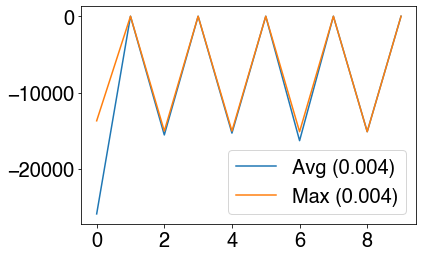

array([379.75412521,   2.26208791])

In [440]:
GA_optimize_constrained([1.0, 150.0, 0, 0], g1_threshold = 0, g2_threshold = 0, g3_threshold = 0,, init_mut_percen = 0.01)

new_pop [[1.20763215e+02 3.63771522e+01]
 [1.82185173e+02 9.79185940e-03]
 [1.88919402e+02 7.96462500e+00]
 [2.70810444e+02 2.25450981e+01]
 [2.64681597e+02 1.42065928e+01]
 [3.36304174e+02 2.97004334e+01]
 [3.89137778e+02 2.75539665e+01]
 [1.92059897e+02 4.41183515e+00]
 [1.59832108e+02 1.05676672e+01]
 [1.20815316e+02 1.76080594e+01]
 [2.83246277e+02 1.96534382e+01]
 [2.51090465e+02 3.92791381e+01]
 [3.79864022e+02 1.86859345e+01]
 [1.50971979e+02 1.98787630e+01]
 [1.37434996e+02 2.64851089e+01]
 [1.52077675e+02 1.82547963e+01]
 [1.62411976e+02 1.75672305e+01]
 [2.18755770e+02 2.81747050e+01]
 [2.42040546e+02 2.42773980e+01]
 [2.23823086e+02 3.82709577e+01]
 [2.31444400e+02 2.36154036e+01]
 [2.36698413e+02 3.14414183e+01]
 [3.31266643e+02 1.19902283e+01]
 [3.74656737e+02 2.31034703e+01]
 [3.96874623e+02 3.44678898e+00]
 [2.18969961e+02 3.71700072e+01]
 [1.24125990e+02 9.14123330e+00]
 [3.85618627e+02 1.89360889e+01]
 [3.24492800e+02 3.06438990e+01]
 [2.54405934e+02 3.94357322e+00]
 [

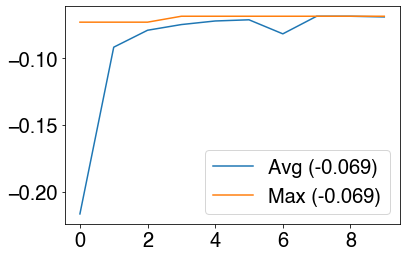

In [1352]:
sol_per_pop = 10 # Number of individuals per population
num_features = 2 # Number of features (u_L and u_Fn)
mut_percen = 0.1

#Creating the initial population.
new_pop = []
for i in range(200): # Initial pop
    u_L  = np.random.uniform(120, 400) # Pick random u_L
    u_Fn = np.random.uniform(0, 40)    # Pick random u_Fn
    new_pop += [[u_L, u_Fn]]
new_pop = np.array(new_pop)
print('new_pop',new_pop)

num_generations = 10
decay_factor = (0.01/mut_percen)**(1/num_generations) # Define decay factor for mut_percen
num_parents_mating = 5
state = [1.0, 150.0, 0, 0]
avg_fitness_list = []
max_fitness_list = []
generation_list = []

for generation in range(num_generations):
    # Measuring the fitness of each chromosome in the population.
    fitness = cal_pop_fitness(new_pop, state)
    
    avg_fit = np.mean(fitness)
    max_fit = np.max(fitness)
#     print('==== Generation %.0f ====' % generation)
#     print('Average fitness:', avg_fit)
#     print('Max fitness:', max_fit)
#     print('')
    avg_fitness_list += [avg_fit]    # Save average fitness score for plotting
    max_fitness_list += [max_fit]    # Save average fitness score for plotting
    generation_list  += [generation] # Save generation index
    
    # Selecting the best parents in the population for mating.
    parents = select_mating_pool(new_pop, fitness, num_parents_mating)
    print('parents:',parents)

    # Generating next generation using crossover.
    offspring_crossover = crossover(parents, offspring_size=(sol_per_pop-parents.shape[0], num_features))
    print('offspring_crossover',offspring_crossover)

    offspring_mutation = mutation(offspring_crossover, mut_percen = mut_percen)
    print('offspring_mutation',offspring_mutation)

    # Creating the new population based on the parents and offspring.
    new_pop[0:parents.shape[0], :] = parents
    new_pop[parents.shape[0]:sol_per_pop, :] = offspring_mutation

    # Cull excess
    new_pop = new_pop[0:sol_per_pop,:]
    
#     mut_percen = 0.5*e**(-1*generation/(num_generations/3)) # Decay
#     mut_percen *= decay_factor
    print('Mut_percen:', mut_percen)
    print('new_pop',new_pop)
plt.figure()
plt.plot(generation_list, avg_fitness_list, label = 'Avg (%.3f)'%avg_fitness_list[-1])
plt.plot(generation_list, max_fitness_list, label = 'Max (%.3f)'%avg_fitness_list[-1])
plt.legend()
plt.show()

In [26]:
# Inspecting the spread of actions predicted by GA
start = time.time()  # For timing purposes
u_L_pool  = []
u_Fn_pool = []
for i in range(500):
    u_L, u_Fn = GA_optimize_constrained([1.0, 150.0, 0, 0], g1_threshold = 0, g2_threshold = 0, g3_threshold = 0,init_mut_percen = 0.01)
    u_L_pool  += [u_L]
    u_Fn_pool += [u_Fn]
end = time.time()  # For timing purposes
print(end - start)
plt.figure()
plt.scatter(u_L_pool, u_Fn_pool, s = 0.5)
plt.scatter(np.mean(u_L_pool), np.mean(u_Fn_pool), color = 'r')
plt.xlim(120, 400)
plt.ylim(0,40)
plt.xlabel('u_L')
plt.ylabel('u_Fn')

KeyboardInterrupt: 

6.305979013442993


Text(0, 0.5, 'u_Fn')

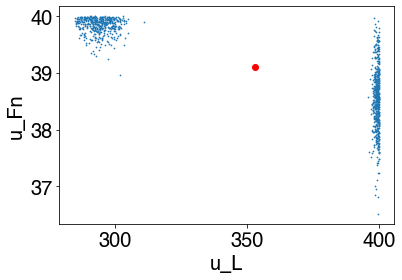

In [2513]:
# Inspecting the spread of predicted max_actions
start = time.time()  # For timing purposes
u_L_pool  = []
u_Fn_pool = []
for i in range(1000):
    u_L, u_Fn = max_action([1.0, 150.0, 0, 0])
    u_L_pool += [u_L]
    u_Fn_pool += [u_Fn]
end = time.time()  # For timing purposes
print(end - start)
plt.figure()
plt.scatter(u_L_pool, u_Fn_pool, s = 0.5)
plt.scatter(np.mean(u_L_pool), np.mean(u_Fn_pool), color = 'r')
# plt.xlim(120, 250)
# plt.ylim(35,41)
plt.xlabel('u_L')
plt.ylabel('u_Fn')

# Introducing constraints
The goal is to train a 2nd neural network to predict a constraint value given a state-action pair. The data used to train this NN will generated using a random policy in the cells below.

### Method 1: Training Q-network and C-network separately

In [189]:
# Generate UNCONSTRAINED data for training the constraint neural network

start = time.time()  # For timing purposes
state_action = []    # To store state and action [Cx, Cn, Cq, t-t_f, u_L, u_Fn]
g1_constraint   = []    # To store g1 constraint 
g2_constraint   = []    # To store g2 constraint 
g3_constraint   = []    # To store g3 constraint 
num_episodes = 10000 # Number of episodes to generate

for j in range(num_episodes):
    initialize_MDP_BioEnv() # Initialize system
    generated_episode = generate_random_episode(initial_state = generate_initial_state())  # Generate one episode
    s_a, g1, g2, g3   = extract_constraint_values_from_episode(generated_episode)            # Extract data from episode
    
    state_action += s_a             # Append state and action 
    g1_constraint   += g1           # Append g1 constraint
    g2_constraint   += g2           # Append g2 constraint
    g3_constraint   += g3           # Append g2 constraint

end = time.time() # For timing purposes

state_action = np.array(state_action)
g1_constraint   = np.array(g1_constraint)
g2_constraint   = np.array(g2_constraint)
g3_constraint   = np.array(g3_constraint)
print('')
print('Time taken:', end - start)
print('==========INPUT [Cx, Cn, Cq, t_f-t, u_L, u_Fn]==========')
print(state_action)
print('')
print('==========TARGET VALUES [g1]==========')
print(g1_constraint)
print('==========TARGET VALUES [g2]==========')
print(g2_constraint)
print('==========TARGET VALUES [g3]==========')
print(g3_constraint)


Time taken: 119.8421642780304
==========INPUT [Cx, Cn, Cq, t_f-t, u_L, u_Fn]==========
[[9.70555027e-01 1.49040188e+02 0.00000000e+00 2.40000000e+02
  3.40039598e+02 3.27614575e+01]
 [1.22051101e+00 6.67313941e+02 2.25888539e-03 2.20000000e+02
  2.38292166e+02 3.77270886e+01]
 [1.69797706e+00 1.16645759e+03 5.48765518e-03 2.00000000e+02
  2.10661500e+02 3.30253704e+01]
 ...
 [9.47556367e+00 1.86648372e+02 7.41403545e-02 6.00000000e+01
  1.20415503e+02 3.27474719e+01]
 [1.05992614e+01 1.73472027e+02 9.52788173e-02 4.00000000e+01
  1.82107830e+02 2.94025838e+01]
 [1.16730117e+01 1.07180132e+02 1.17003366e-01 2.00000000e+01
  3.30239614e+02 2.00395255e+01]]

==========TARGET VALUES [g1]==========
[[ 717.28512247]
 [ 717.28512247]
 [ 717.28512247]
 ...
 [-626.52797272]
 [-692.81986825]
 [-741.40397534]]
==========TARGET VALUES [g2]==========
[[ 0.01015251]
 [ 0.01015251]
 [ 0.01015251]
 ...
 [-0.00144044]
 [-0.00144044]
 [-0.00144044]]
==========TARGET VALUES [g3]==========
[[-94.96354435

No handles with labels found to put in legend.


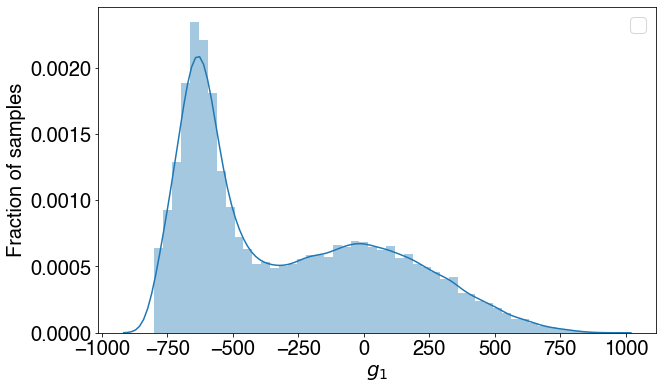

No handles with labels found to put in legend.


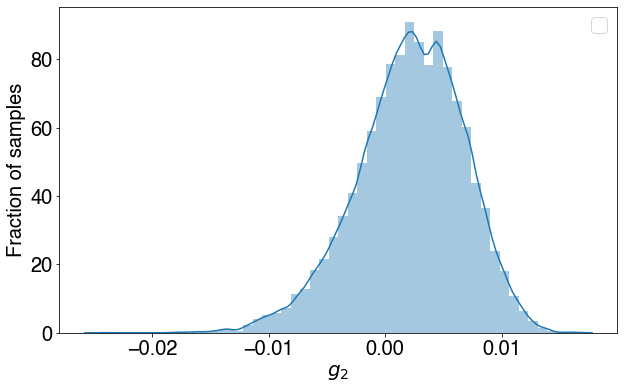

No handles with labels found to put in legend.


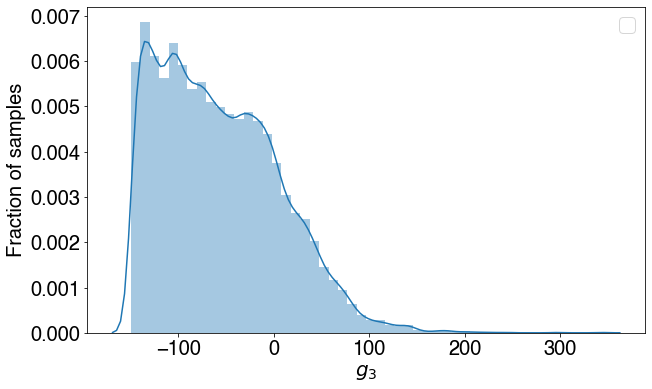

In [258]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(g1_constraint)
ax.set(xlabel= '$g_1$', ylabel = 'Fraction of samples')
plt.legend()
plt.show()

fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(g2_constraint)
ax.set(xlabel= '$g_2$', ylabel = 'Fraction of samples')
plt.legend()
plt.show()

fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(g3_constraint)
ax.set(xlabel= '$g_3$', ylabel = 'Fraction of samples')
plt.legend()
plt.show()

In [192]:
# Combine g1_constraint,g2_constraint and g3_constraint into a (n x 3) array for standardization purposes
g1g2g3_constraint = []
for i in range(len(g1_constraint)):
    g1g2g3_constraint += [[g1_constraint[i][0], g2_constraint[i][0], g3_constraint[i][0]]]
g1g2g3_constraint = np.array(g1g2g3_constraint)
g1g2g3_constraint

array([[ 7.17285122e+02,  1.01525071e-02, -9.49635443e+01],
       [ 7.17285122e+02,  1.01525071e-02, -9.49635443e+01],
       [ 7.17285122e+02,  1.01525071e-02, -9.49635443e+01],
       ...,
       [-6.26527973e+02, -1.44044017e-03, -9.14039753e+01],
       [-6.92819868e+02, -1.44044017e-03, -9.14039753e+01],
       [-7.41403975e+02, -1.44044017e-03, -9.14039753e+01]])

In [193]:
# Standardize data for C-network
X = state_action
y = g1g2g3_constraint

scaler_X = StandardScaler().fit(X)
scaler_y = StandardScaler().fit(y)

# Get mean and std
x_mean_C = scaler_X.mean_
x_std_C  = scaler_X.scale_
y_mean_C = scaler_y.mean_
y_std_C  = scaler_y.scale_

# Scale x
X_scaled = np.zeros(X.shape)
for feature in range(len(x_mean_C)): 
    X_scaled[:,feature] = (X[:,feature] - x_mean_C[feature])/x_std_C[feature]

# Scale g1
g1_scaled = np.zeros([y.shape[0],1])
g1_scaled[:] = (g1_constraint[:] - y_mean_C[0])/y_std_C[0] # Use 0th index of y_mean and y_std

# Scale g2
g2_scaled = np.zeros([y.shape[0],1])
g2_scaled[:] = (g2_constraint[:] - y_mean_C[1])/y_std_C[1] # Use 1st index of y_mean and y_std

# Scale g3
g3_scaled = np.zeros([y.shape[0],1])
g3_scaled[:] = (g3_constraint[:] - y_mean_C[2])/y_std_C[2] # Use 1st index of y_mean and y_std


# Convert into tensors
X_scaled = torch.tensor(X_scaled)
g1_scaled = torch.tensor(g1_scaled)
g2_scaled = torch.tensor(g2_scaled)
g3_scaled = torch.tensor(g3_scaled)
X_scaled, g1_scaled, g2_scaled, g3_scaled

(tensor([[-1.2332, -0.7551, -1.1124,  1.5933,  0.9944,  1.1071],
         [-1.1465,  0.8280, -1.0405,  1.3036, -0.2630,  1.5380],
         [-0.9808,  2.3528, -0.9376,  1.0139, -0.6044,  1.1300],
         ...,
         [ 1.7174, -0.6403,  1.2498, -1.0139, -1.7196,  1.1059],
         [ 2.1072, -0.6805,  1.9234, -1.3036, -0.9572,  0.8156],
         [ 2.4797, -0.8830,  2.6155, -1.5933,  0.8733,  0.0032]],
        dtype=torch.float64),
 tensor([[ 2.6607],
         [ 2.6607],
         [ 2.6607],
         ...,
         [-0.8685],
         [-1.0426],
         [-1.1702]], dtype=torch.float64),
 tensor([[ 1.7309],
         [ 1.7309],
         [ 1.7309],
         ...,
         [-0.7758],
         [-0.7758],
         [-0.7758]], dtype=torch.float64),
 tensor([[-0.5978],
         [-0.5978],
         [-0.5978],
         ...,
         [-0.5412],
         [-0.5412],
         [-0.5412]], dtype=torch.float64))

In [194]:
len(X_scaled), len(g1_scaled), len(g2_scaled), len(g3_scaled)

(120000, 120000, 120000, 120000)

### Training g1-net

In [195]:
g1_net = torch.nn.Sequential(
        torch.nn.Linear(6, 200, bias = True), # 6 input nodes (Cx, Cn, Cq, t_f - t, u_L, u_Fn)
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 100, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(100, 50, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(50, 1, bias = True), # 1 output node
    ).double()

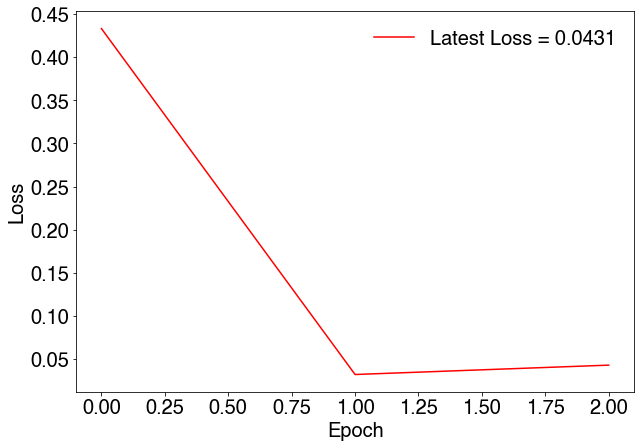

Current Epoch = 2
Latest Loss = 0.04314330987793635


KeyboardInterrupt: 

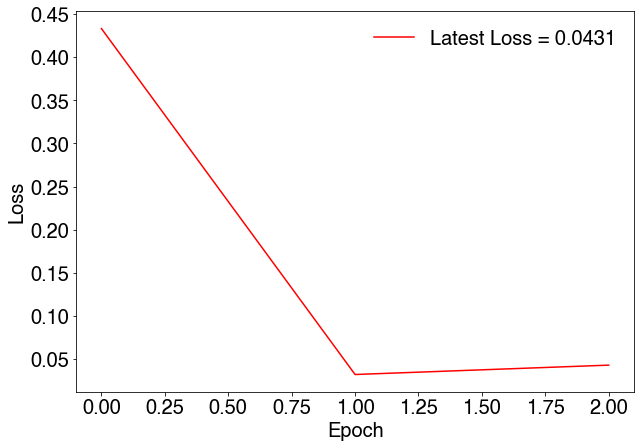

In [196]:
# Define dataset
torch_dataset = torch.utils.data.TensorDataset(X_scaled, g1_scaled)

optimizer = torch.optim.Adam(g1_net.parameters(), lr = 1e-4, amsgrad= True) # Initialize Adam optimizer
loss_func = torch.nn.SmoothL1Loss()  # this is for regression mean squared loss

BATCH_SIZE = 200 # Batch size
EPOCH      = 500   # No. of epochs

# Splitting dataset into batches
loader = torch.utils.data.DataLoader(dataset     = torch_dataset, 
                         batch_size  = BATCH_SIZE, 
                         shuffle     = True, 
                         num_workers = 0)

# my_images = []  # For saving into gif
fig, ax = plt.subplots(figsize=(10,7))

epoch_list = [] # Save epoch for plotting
loss_list  = [] # Save loss for plotting

# Start training
for epoch in range(EPOCH):
    epoch_list += [epoch]
    for step, (batch_x, batch_y) in enumerate(loader): # for each training step

        prediction = g1_net(batch_x.double())          # input x and predict based on x

        loss       = loss_func(prediction, batch_y) # must be (1. nn output, 2. target)

        optimizer.zero_grad()   # clear gradients for next train
        loss.backward()         # backpropagation, compute gradients
        optimizer.step()        # apply gradients

        if step == 1:
            # plot and show learning process
            plt.cla()
            loss_list += [loss.data.numpy()]
            plt.plot(epoch_list, loss_list, label = 'Latest Loss = %.4f' % loss.data.numpy(), color = 'r')
            plt.xlabel('Epoch', fontsize = 20)
            plt.ylabel('Loss', fontsize = 20)
            plt.xticks(fontsize = 20)
            plt.yticks(fontsize = 20)
            plt.legend(fontsize = 20, frameon= 0)
            
            display.clear_output(wait = True) #these two lines plots the data in real time
            display.display(fig)
            print('Current Epoch =', epoch)
            print('Latest Loss =', loss.data.numpy())

Very poor prediction of first transition [1.0, 150.0, 0, 240, u_L, u_Fn] --> cannot predict -ve values of g1

In [220]:
print('g1_net predictions of g1:',  (g1_net(X_scaled[0:200:12]).detach().numpy()*y_std_C[0])+y_mean_C[0]   )
print('Actual labels:',  g1_constraint[0:200:12]   )

g1_net predictions of g1: [[169.88598475]
 [192.16665927]
 [277.96121581]
 [168.94059048]
 [ 49.9956065 ]
 [ 19.36737399]
 [105.84107779]
 [339.76878869]
 [ 47.18078534]
 [281.01348606]
 [ 24.07480609]
 [109.42772014]
 [297.25347707]
 [ 37.70378133]
 [181.43995365]
 [163.2190903 ]
 [143.60078228]]
Actual labels: [[  77.73519622]
 [ 638.94362711]
 [ 176.46875385]
 [ 431.98459369]
 [ 401.34313084]
 [ 587.24721208]
 [ 338.53076033]
 [ 294.07330344]
 [-137.29324356]
 [ 278.98456649]
 [  17.84313246]
 [  12.3166078 ]
 [ 301.80490414]
 [ -22.61426158]
 [ 157.30346801]
 [ -50.66123331]
 [  62.18762976]]


### Training g2-net

In [206]:
g2_net = torch.nn.Sequential(
        torch.nn.Linear(6, 200, bias = True), # 6 input nodes (Cx, Cn, Cq, t_f - t, u_L, u_Fn)
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 100, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(100, 50, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(50, 1, bias = True), # 1 output node
    ).double()

KeyboardInterrupt: 

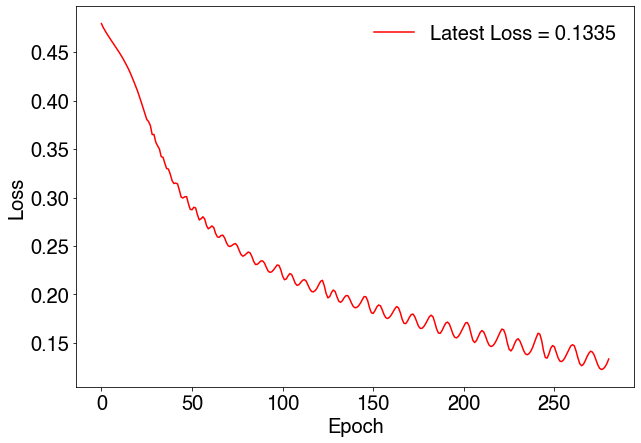

In [207]:
# for overfitting
# Define dataset
torch_dataset = torch.utils.data.TensorDataset(X_scaled[:1000], g2_scaled[:1000])

optimizer = torch.optim.Adam(g2_net.parameters(), lr = 1e-3, amsgrad= True) # Initialize Adam optimizer
loss_func = torch.nn.SmoothL1Loss()  # this is for regression mean squared loss


EPOCH      = 1000   # No. of epochs

# my_images = []  # For saving into gif
fig, ax = plt.subplots(figsize=(10,7))

epoch_list = [] # Save epoch for plotting
loss_list  = [] # Save loss for plotting

# Start training
for epoch in range(EPOCH):
    epoch_list += [epoch]
    

    prediction = g2_net(X_scaled[:1000])          # input x and predict based on x

    loss       = loss_func(prediction, g2_scaled[:1000]) # must be (1. nn output, 2. target)

    optimizer.zero_grad()   # clear gradients for next train
    loss.backward()         # backpropagation, compute gradients
    optimizer.step()        # apply gradients


            # plot and show learning process
    plt.cla()
    loss_list += [loss.data.numpy()]
    plt.plot(epoch_list, loss_list, label = 'Latest Loss = %.4f' % loss.data.numpy(), color = 'r')
    plt.xlabel('Epoch', fontsize = 20)
    plt.ylabel('Loss', fontsize = 20)
    plt.xticks(fontsize = 20)
    plt.yticks(fontsize = 20)
    plt.legend(fontsize = 20, frameon= 0)
            
    display.clear_output(wait = True) #these two lines plots the data in real time
    display.display(fig)
    print('Current Epoch =', epoch)
    print('Latest Loss =', loss.data.numpy())

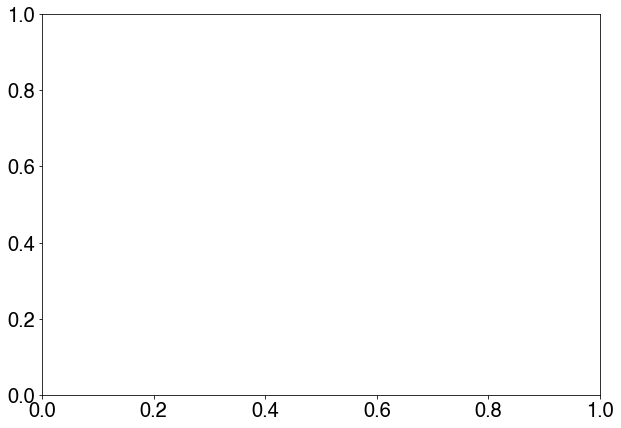

In [488]:
# Define dataset
torch_dataset = torch.utils.data.TensorDataset(X_scaled, g2_scaled)

optimizer = torch.optim.Adam(g2_net.parameters(), lr = 1e-4, amsgrad= True) # Initialize Adam optimizer
loss_func = torch.nn.SmoothL1Loss()  # this is for regression mean squared loss

BATCH_SIZE = 200 # Batch size
EPOCH      = 500   # No. of epochs

# Splitting dataset into batches
loader = torch.utils.data.DataLoader(dataset     = torch_dataset, 
                         batch_size  = BATCH_SIZE, 
                         shuffle     = True, 
                         num_workers = 0)

# my_images = []  # For saving into gif
fig, ax = plt.subplots(figsize=(10,7))

epoch_list = [] # Save epoch for plotting
loss_list  = [] # Save loss for plotting

# Start training
for epoch in range(EPOCH):
    epoch_list += [epoch]
    for step, (batch_x, batch_y) in enumerate(loader): # for each training step

        prediction = g2_net(batch_x.double())          # input x and predict based on x

        loss       = loss_func(prediction, batch_y) # must be (1. nn output, 2. target)

        optimizer.zero_grad()   # clear gradients for next train
        loss.backward()         # backpropagation, compute gradients
        optimizer.step()        # apply gradients

        if step == 1:
            # plot and show learning process
            plt.cla()
            loss_list += [loss.data.numpy()]
            plt.plot(epoch_list, loss_list, label = 'Latest Loss = %.4f' % loss.data.numpy(), color = 'r')
            plt.xlabel('Epoch', fontsize = 20)
            plt.ylabel('Loss', fontsize = 20)
            plt.xticks(fontsize = 20)
            plt.yticks(fontsize = 20)
            plt.legend(fontsize = 20, frameon= 0)
            
            display.clear_output(wait = True) #these two lines plots the data in real time
            display.display(fig)
            print('Current Epoch =', epoch)
            print('Latest Loss =', loss.data.numpy())

Poor prediction by g2_net in general (as shown by the high losses above)

In [228]:
print('g2_net predictions of g2:',  (g2_net(X_scaled[20:40]).detach().numpy()*y_std_C[1])+y_mean_C[1]   )
print('Actual labels:',  g2_constraint[20:40]   )

g2_net predictions of g2: [[ 0.00234046]
 [ 0.00488032]
 [ 0.002773  ]
 [ 0.00406091]
 [ 0.0047795 ]
 [ 0.00485463]
 [ 0.00445504]
 [ 0.0033243 ]
 [ 0.00295055]
 [ 0.00388676]
 [ 0.00386802]
 [ 0.00216321]
 [-0.00125155]
 [-0.00067009]
 [-0.00247181]
 [-0.00452562]
 [ 0.00319862]
 [ 0.00496048]
 [ 0.00425856]
 [ 0.00403404]]
Actual labels: [[ 0.00425832]
 [ 0.00425832]
 [ 0.00425832]
 [ 0.00425832]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [-0.00551784]
 [ 0.00548473]
 [ 0.00548473]
 [ 0.00548473]
 [ 0.00548473]]


### Training g3-net

In [204]:
g3_net = torch.nn.Sequential(
        torch.nn.Linear(6, 200, bias = True), # 6 input nodes (Cx, Cn, Cq, t_f - t, u_L, u_Fn)
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 100, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(100, 50, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(50, 1, bias = True), # 1 output node
    ).double()

KeyboardInterrupt: 

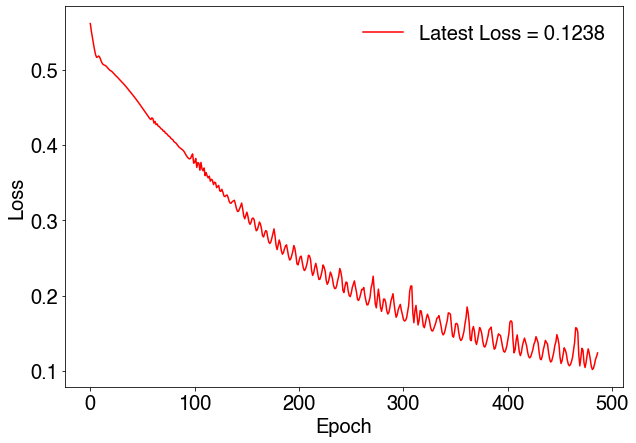

In [205]:
# for overfitting
# Define dataset
torch_dataset = torch.utils.data.TensorDataset(X_scaled[:1000], g3_scaled[:1000])

optimizer = torch.optim.Adam(g3_net.parameters(), lr = 1e-3, amsgrad= True) # Initialize Adam optimizer
loss_func = torch.nn.SmoothL1Loss()  # this is for regression mean squared loss

EPOCH      = 1000   # No. of epochs

# my_images = []  # For saving into gif
fig, ax = plt.subplots(figsize=(10,7))

epoch_list = [] # Save epoch for plotting
loss_list  = [] # Save loss for plotting

# Start training
for epoch in range(EPOCH):
    epoch_list += [epoch]
    

    prediction = g3_net(X_scaled[:1000])          # input x and predict based on x

    loss       = loss_func(prediction, g3_scaled[:1000]) # must be (1. nn output, 2. target)

    optimizer.zero_grad()   # clear gradients for next train
    loss.backward()         # backpropagation, compute gradients
    optimizer.step()        # apply gradients


            # plot and show learning process
    plt.cla()
    loss_list += [loss.data.numpy()]
    plt.plot(epoch_list, loss_list, label = 'Latest Loss = %.4f' % loss.data.numpy(), color = 'r')
    plt.xlabel('Epoch', fontsize = 20)
    plt.ylabel('Loss', fontsize = 20)
    plt.xticks(fontsize = 20)
    plt.yticks(fontsize = 20)
    plt.legend(fontsize = 20, frameon= 0)
            
    display.clear_output(wait = True) #these two lines plots the data in real time
    display.display(fig)
    print('Current Epoch =', epoch)
    print('Latest Loss =', loss.data.numpy())

Generally, g3_net has good predictions

In [186]:
print('g3_net predictions of g3:',  (g3_net(X_scaled[0:20]).detach().numpy()*y_std_C[2])+y_mean_C[2]   )
print('Actual labels:',  g3_constraint[0:20])

g3_net predictions of g3: [[ -77.806102  ]
 [ -97.06130819]
 [-106.34042362]
 [-137.60384027]
 [-120.78631951]
 [-125.44264043]
 [-156.66715492]
 [-112.65270213]
 [-133.65638136]
 [-144.22463634]
 [-122.51155582]
 [-150.05703523]
 [ -72.67258576]
 [ -55.00919328]
 [ -30.94300155]
 [ -28.28689373]
 [ -39.54570351]
 [ -57.12382701]
 [ -23.4946504 ]
 [ -26.58062602]]
Actual labels: [[-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [-139.77697891]
 [ -24.11821548]
 [ -24.11821548]
 [ -24.11821548]
 [ -24.11821548]
 [ -24.11821548]
 [ -24.11821548]
 [ -24.11821548]
 [ -24.11821548]]


## Plotting state space and visualize violation of constraints

### Random **unconstrained** policy

In [208]:
# Generate data using random policy
plotting_state_data = []
for i in range(1000):
    initialize_MDP_BioEnv() # Initialize system
    episode = generate_random_episode(initial_state = generate_initial_state()) # Generate 1 episode
    data = extract_data_from_episode(episode, discount_factor = 0.9)   # Extract datapoint from episode
    for j in data:
        j = j[:-1]
        plotting_state_data += j  # Add datapoints to training set
# plotting_state_data
plotting_state_data = pd.DataFrame(plotting_state_data)
plotting_state_data_g1_violated = plotting_state_data[plotting_state_data[1] - 800 > 0] # Conpath 1
plotting_state_data_g2_violated = plotting_state_data[plotting_state_data[2] - 0.011*plotting_state_data[0] > 0] # Conpath 2
plotting_state_data_g3_violated = plotting_state_data[(plotting_state_data[3] == 240.0) & (plotting_state_data[1] - 150 > 0)] # Terminal constraint

print('No. of states visited:',len(plotting_state_data))
print('No. of states where g1 violated:',len(plotting_state_data_g1_violated))
print('No. of states where g2 violated:',len(plotting_state_data_g2_violated))
print('No. of states where g3 violated:',len(plotting_state_data_g3_violated))

Cx_all = plotting_state_data[0]
Cn_all = plotting_state_data[1]
Cq_all = plotting_state_data[2]

Cx_g1 = plotting_state_data_g1_violated[0]
Cn_g1 = plotting_state_data_g1_violated[1]
Cq_g1 = plotting_state_data_g1_violated[2]

Cx_g2 = plotting_state_data_g2_violated[0]
Cn_g2 = plotting_state_data_g2_violated[1]
Cq_g2 = plotting_state_data_g2_violated[2]

Cx_g3 = plotting_state_data_g3_violated[0]
Cn_g3 = plotting_state_data_g3_violated[1]
Cq_g3 = plotting_state_data_g3_violated[2]

@interact(ns=(-90,90,0.1),ew=(-90,90,0.1))
def interact_poly(ns,ew):
    fig = plt.figure(figsize = (10,7))
    ax = plt.axes(projection='3d')

    # Data for a three-dimensional line
    ax.plot3D(Cx_all, Cn_all, Cq_all, 'g', label = 'no violation', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g1, Cn_g1, Cq_g1, 'r', label = 'g1', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g2, Cn_g2, Cq_g2, 'b', label = 'g2', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g3, Cn_g3, Cq_g3, 'black', label = 'g3', linestyle = '', marker = 'o', markersize = 1)
    plt.xlabel('$C_x$', labelpad=30)
    plt.ylabel('$C_n$', labelpad=50)
    ax.set_zlabel('$C_q$', fontsize=20, labelpad=20)
    plt.legend()
    plt.xticks(rotation=90)
    plt.yticks(rotation=90)
    plt.xlim(0,16)
    plt.ylim(0,2200)
    ax.set_zlim(0, 0.25)
    ax.view_init(ns,ew)
    plt.show()

No. of states visited: 13000
No. of states where g1 violated: 1626
No. of states where g2 violated: 915
No. of states where g3 violated: 212


interactive(children=(FloatSlider(value=0.0, description='ns', max=90.0, min=-90.0), FloatSlider(value=0.0, de…

### Trained **unconstrained** policy

In [2746]:
# Generate data using random policy
plotting_state_data = []
for i in range(1000):
    episode = generate_episode_with_NN(GA_optimize, [1.0, 150.0, 0, 0], epsilon = 0) # Generate 1 episode
    data = extract_data_from_episode(episode, discount_factor = 0.9)   # Extract datapoint from episode
    for j in data:
        j = j[:-1]
        plotting_state_data += j  # Add datapoints to training set
# plotting_state_data
plotting_state_data = pd.DataFrame(plotting_state_data)
plotting_state_data_g1_violated = plotting_state_data[plotting_state_data[1] - 800 > 0] # Conpath 1
plotting_state_data_g2_violated = plotting_state_data[plotting_state_data[2] - 0.011*plotting_state_data[0] > 0] # Conpath 2
plotting_state_data_g3_violated = plotting_state_data[(plotting_state_data[3] == 240.0) & (plotting_state_data[1] - 150 > 0)] # Terminal constraint

print('No. of states visited:',len(plotting_state_data))
print('No. of states where g1 violated:',len(plotting_state_data_g1_violated))
print('No. of states where g2 violated:',len(plotting_state_data_g2_violated))
print('No. of states where g3 violated:',len(plotting_state_data_g3_violated))

Cx_all = plotting_state_data[0]
Cn_all = plotting_state_data[1]
Cq_all = plotting_state_data[2]

Cx_g1 = plotting_state_data_g1_violated[0]
Cn_g1 = plotting_state_data_g1_violated[1]
Cq_g1 = plotting_state_data_g1_violated[2]

Cx_g2 = plotting_state_data_g2_violated[0]
Cn_g2 = plotting_state_data_g2_violated[1]
Cq_g2 = plotting_state_data_g2_violated[2]

Cx_g3 = plotting_state_data_g3_violated[0]
Cn_g3 = plotting_state_data_g3_violated[1]
Cq_g3 = plotting_state_data_g3_violated[2]

@interact(ns=(-90,90,0.1),ew=(-90,90,0.1))
def interact_poly(ns,ew):
    fig = plt.figure(figsize = (10,7))
    ax = plt.axes(projection='3d')

    # Data for a three-dimensional line
    ax.plot3D(Cx_all, Cn_all, Cq_all, 'g', label = 'no violation', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g1, Cn_g1, Cq_g1, 'r', label = 'g1', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g2, Cn_g2, Cq_g2, 'b', label = 'g2', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g3, Cn_g3, Cq_g3, 'black', label = 'g3', linestyle = '', marker = 'o', markersize = 1)
    plt.xlabel('$C_x$', labelpad=20)
    plt.ylabel('$C_n$', labelpad=20)
    ax.set_zlabel('$C_q$', fontsize=20, labelpad=20)
    plt.legend()
    # plt.zlabel('Cq')
    ax.view_init(ns,ew)
    plt.show()

No. of states visited: 13000
No. of states where g1 violated: 5004
No. of states where g2 violated: 1000
No. of states where g3 violated: 0


interactive(children=(FloatSlider(value=0.0, description='ns', max=90.0, min=-90.0), FloatSlider(value=0.0, de…

### Method 2: Training Q-network and C-network simultaneously

In [217]:
# Initialize Q-network
Q_net = torch.nn.Sequential(
        torch.nn.Linear(6,   200, bias = True), # 6 input nodes
        torch.nn.LeakyReLU(),    # apply ReLU activation function
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),    # apply ReLU activation function
        torch.nn.Linear(200,   1, bias = True), # 1 output node
    ).double()

# Initialize g1_network
g1_net = torch.nn.Sequential(
        torch.nn.Linear(6, 200, bias = True), # 4 input nodes (Cx, Cn, Cq, t_f - t, u_L, u_Fn)
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 100, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(100, 50, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(50, 1, bias = True), # 1 output node
    ).double()

# Initialize g2_network
g2_net = torch.nn.Sequential(
        torch.nn.Linear(6, 200, bias = True), # 4 input nodes (Cx, Cn, Cq, t_f - t, u_L, u_Fn)
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 100, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(100, 50, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(50, 1, bias = True), # 1 output node
    ).double()

g3_net = torch.nn.Sequential(
        torch.nn.Linear(6, 200, bias = True), # 6 input nodes (Cx, Cn, Cq, t_f - t, u_L, u_Fn)
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 200, bias = True), 
        torch.nn.LeakyReLU(),                
        torch.nn.Linear(200, 100, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(100, 50, bias = True), 
        torch.nn.LeakyReLU(),
        torch.nn.Linear(50, 1, bias = True), # 1 output node
    ).double()

In [220]:
# ========== 1) GENERATING INITIAL BATCH OF SAMPLES FOR REPLAY BUFFER ==========
epsilon       = 0.99   # Initial epsilon
g1_threshold  = 500    # Initial g1_threshold
g2_threshold  = 0.050  # Initial g2_threshold
g3_threshold  = 150    # Initial g3_threshold
replay_buffer = collections.deque(maxlen = 3000)  # Max capacity of 3k
g1_buffer     = collections.deque(maxlen = 30000) # Max capacity of 30k
g2_buffer     = collections.deque(maxlen = 30000) # Max capacity of 30k
g3_buffer     = collections.deque(maxlen = 30000) # Max capacity of 30k

for i in range(100): # Generate 100 initial episodes
    initialize_MDP_BioEnv() # Initialize system
    episode       = generate_episode_with_NN(NN = GA_optimize_constrained,
                                             initial_state = generate_initial_state(),
                                             epsilon = epsilon, 
                                             g1_threshold = g1_threshold,
                                             g2_threshold = g2_threshold,
                                             g3_threshold = g3_threshold)
    episode_copy  = copy.deepcopy(episode) # Copied to ensure same episodes are fed into Q and C
    episode_copy2 = copy.deepcopy(episode) # Copied to ensure same episodes are fed into Q and C
    episode_copy3 = copy.deepcopy(episode) # Copied to ensure same episodes are fed into Q and C
    replay_buffer = update_replay_buffer(replay_buffer, episode, discount_factor = 0.9) # Add to replay buffer
    g1_buffer     = update_g1_buffer(g1_buffer, episode_copy)  # Add to g1 buffer
    g2_buffer     = update_g2_buffer(g2_buffer, episode_copy2) # Add to g2 buffer
    g3_buffer     = update_g3_buffer(g3_buffer, episode_copy3) # Add to g2 buffer
print('Initial size of replay buffer:', len(replay_buffer))
print('Initial size of g1 buffer:', len(g1_buffer))
print('Initial size of g2 buffer:', len(g2_buffer))
print('Initial size of g3 buffer:', len(g3_buffer))

# ================================= 2) TRAINING THE Q-NETWORK =================================
g1_threshold_list  = [] # Store g1_threshold
g2_threshold_list  = [] # Store g2_threshold
g3_threshold_list  = [] # Store g3_threshold
epsilon_list       = [] # Store epsilon
score_list         = [] # For plotting score of policy visited over time
iteration_list     = [] # Store iteration
policy_mean_list   = [] # For plotting evolution of policy visited over time
policy_std_list    = [] # For plotting evolution of policy visited over time
training_loss_list = [] # For plotting loss of NN (after 20 epochs) over time
episode_bank       = [] # A list of list of lists - Tertiary list  -> Iterations
                        #                         - Secondary list -> Episodes
                        #                         - Primary list   -> Steps
                        #                         For plotting evolution of states visited over time            


for iteration in range(2000):
    
    # SCORE EXISTING POLICY
    print('=========== TRAINING ITERATION %.0f ===========' % iteration)
    print('Current epsilon = ', epsilon)
    print('Current g1_threshold = ', g1_threshold)
    print('Current g2_threshold = ', g2_threshold)
    print('Current g3_threshold = ', g3_threshold)
    MDP_BioEnv = Model_env(p, tf) # Initialize with fixed constants for scoring
    try:
        current_score = score_NN_policy(GA_optimize_constrained, 
                                        initial_state = [1.0, 150.0, 0, 0], # Use fixed initial state
                                        num_iterations = 1, 
                                        get_control = False, 
                                        g1_threshold = g1_threshold,
                                        g2_threshold = g2_threshold,
                                        g3_threshold = g3_threshold)
    except KeyboardInterrupt: 
        try:
            current_score = score_NN_policy(GA_optimize_constrained, 
                                        initial_state = [1.0, 150.0, 0, 0], 
                                        num_iterations = 1, 
                                        get_control = False, 
                                        g1_threshold = g1_threshold,
                                        g2_threshold = g2_threshold,
                                        g3_threshold = g3_threshold)
        except KeyboardInterrupt:
            anneal_NN()
            
    print('AVERAGE SCORE = ', current_score)
    print('')
    
    # GENERATE EPISODES & ADD TO REPLAY BUFFER
    for j in range(100):
        if j in range(0,1000,10): # Reinitialize system every 10 episodes
            initialize_MDP_BioEnv() # Initialize system
            print('MDP_BioEnv reinitialized')
        try: # generate_episode_with_NN has timeout of 5 seconds
            episode      = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = g1_threshold,
                                                 g2_threshold = g2_threshold,
                                                 g3_threshold = g3_threshold)
        except KeyboardInterrupt: # 2nd chance if first try fails
            try: # generate_episode_with_NN has timeout of 5 seconds
                episode      = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = g1_threshold,
                                                 g2_threshold = g2_threshold,
                                                 g3_threshold = g3_threshold)
            except KeyboardInterrupt: # 2nd chance if first try fails
                try: # generate_episode_with_NN has timeout of 5 seconds
                    episode      = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = g1_threshold,
                                                 g2_threshold = g2_threshold,
                                                 g3_threshold = g3_threshold)
                except KeyboardInterrupt:
                    anneal_NN()
                    
        if episode != None:                
            episode_copy  = copy.deepcopy(episode) # Copied to ensure same episodes are fed into Q and C
            episode_copy2 = copy.deepcopy(episode)
            episode_copy3 = copy.deepcopy(episode)
            replay_buffer = update_replay_buffer(replay_buffer, episode, discount_factor = 0.9) # Add to replay buffer
            g1_buffer     = update_g1_buffer(g1_buffer, episode_copy) # Add to g1 buffer
            g2_buffer     = update_g2_buffer(g2_buffer, episode_copy2) # Add to g2 buffer
            g3_buffer     = update_g3_buffer(g3_buffer, episode_copy3) # Add to g2 buffer
            if j in np.arange(0, 100, 10):
                print('%.0f th episode generated' % j)
            
    # === TRAIN Q_NETWORK ===
    combined_inputs_Q  = [] # List of lists to be converted into input tensor
    combined_targets_Q = [] # List to be converted into target tensor
    samples_Q          = random.sample(replay_buffer, 100) # Draw random samples from replay buffer
    
    for inputs, target in samples_Q:
        if len(inputs) == 6: # To fix the changing len problem
            combined_inputs_Q  += [inputs]
            combined_targets_Q += [[target]]
    combined_inputs_Q  = torch.tensor(combined_inputs_Q).double()  # Convert list to tensor
    combined_targets_Q = torch.tensor(combined_targets_Q).double() # Convert list to tensor

    Q_optimizer = torch.optim.Adam(Q_net.parameters(), lr=1e-3) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    
    for epoch in range(20):
        prediction = Q_net(combined_inputs_Q)                    # Input x and predict based on x
        Q_loss     = loss_func(prediction, combined_targets_Q) # Must be (1. nn output, 2. target)

        Q_optimizer.zero_grad()   # Clear gradients for next train
        Q_loss.backward()         # Backpropagation, compute gradients
        Q_optimizer.step()        # Apply gradients
#         print('Epoch = ', epoch, 'Loss = %.4f' % Q_loss.data.numpy())
    print('Q-network trained')
    # === TRAIN g1_NETWORK ===
    combined_inputs_g1  = [] # List of lists to be converted into input tensor
    combined_targets_g1 = [] # List to be converted into target tensor
    samples_g1          = random.sample(g1_buffer, 500) # Draw random samples from replay buffer
    
    for inputs, target in samples_g1:
        if len(inputs) == 6: # To fix the changing len problem
            combined_inputs_g1  += [inputs]
            combined_targets_g1 += [[target]]

    combined_inputs_g1  = torch.tensor(combined_inputs_g1).double()  # Convert list to tensor
    combined_targets_g1 = torch.tensor(combined_targets_g1).double() # Convert list to tensor

    g1_optimizer = torch.optim.Adam(g1_net.parameters(), lr=1e-4) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    
    for epoch in range(10):
        prediction = g1_net(combined_inputs_g1)                    # Input x and predict based on x
        g1_loss    = loss_func(prediction, combined_targets_g1) # Must be (1. nn output, 2. target)

        g1_optimizer.zero_grad()   # Clear gradients for next train
        g1_loss.backward()         # Backpropagation, compute gradients
        g1_optimizer.step()        # Apply gradients
#         print('Epoch = ', epoch, 'Loss = %.4f' % g1_loss.data.numpy())
    print('g1-network trained')
    # === TRAIN g2_NETWORK ===
    combined_inputs_g2  = [] # List of lists to be converted into input tensor
    combined_targets_g2 = [] # List to be converted into target tensor
    samples_g2          = random.sample(g2_buffer, 1000) # Draw random samples from replay buffer
    
    for inputs, target in samples_g2:
        if len(inputs) == 6: # To fix the changing len problem
            combined_inputs_g2  += [inputs]
            combined_targets_g2 += [[target]]

    combined_inputs_g2  = torch.tensor(combined_inputs_g2).double()  # Convert list to tensor
    combined_targets_g2 = torch.tensor(combined_targets_g2).double() # Convert list to tensor

    g2_optimizer = torch.optim.Adam(g2_net.parameters(), lr=1e-3) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    
    for epoch in range(100):
        prediction = g2_net(combined_inputs_g2)                    # Input x and predict based on x
        g2_loss    = loss_func(prediction, combined_targets_g2) # Must be (1. nn output, 2. target)

        g2_optimizer.zero_grad()   # Clear gradients for next train
        g2_loss.backward()         # Backpropagation, compute gradients
        g2_optimizer.step()        # Apply gradients
#         print('Epoch = ', epoch, 'Loss = %.4f' % g2_loss.data.numpy())
    print('g2-network trained')
    # === TRAIN g3_NETWORK ===
    combined_inputs_g3  = [] # List of lists to be converted into input tensor
    combined_targets_g3 = [] # List to be converted into target tensor
    samples_g3          = random.sample(g3_buffer, 1000) # Draw random samples from replay buffer
    
    for inputs, target in samples_g3:
        if len(inputs) == 6: # To fix the changing len problem
            combined_inputs_g3  += [inputs]
            combined_targets_g3 += [[target]]

    combined_inputs_g3  = torch.tensor(combined_inputs_g3).double()  # Convert list to tensor
    combined_targets_g3 = torch.tensor(combined_targets_g3).double() # Convert list to tensor

    g3_optimizer = torch.optim.Adam(g3_net.parameters(), lr=1e-3) # Initialize Adam optimizer
    loss_func = torch.nn.SmoothL1Loss()                     # Define loss function
    
    for epoch in range(200):
        prediction = g3_net(combined_inputs_g3)                    # Input x and predict based on x
        g3_loss    = loss_func(prediction, combined_targets_g3) # Must be (1. nn output, 2. target)

        g3_optimizer.zero_grad()   # Clear gradients for next train
        g3_loss.backward()         # Backpropagation, compute gradients
        g3_optimizer.step()        # Apply gradients
#         print('Epoch = ', epoch, 'Loss = %.4f' % g2_loss.data.numpy())
    print('g3-network trained')
    # Save information
    g1_threshold_list  += [g1_threshold]
    g2_threshold_list  += [g2_threshold]
    g3_threshold_list  += [g3_threshold]
    epsilon_list       += [epsilon]
    score_list         += [current_score] # Store score for each iteration
    training_loss_list += [Q_loss.data.numpy()]                                # Store training loss after 20 epochs for each iteration
    iteration_list     += [iteration]                                        # Store iteration
    

    # INVESTIGATING EVOLUTION OF STATES VISITED OVER TRAINING ITERATIONS
    if iteration in np.arange(0, 5000, 10): # Every 10 iterations
        pool_of_episodes = [] # A *list of lists* of episodes
        for i in range(10):   # Generate 10 sample episodes and store them
            initialize_MDP_BioEnv()
            try:
                pool_of_episodes += [generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = 0, 
                                                 g1_threshold = g1_threshold,
                                                 g2_threshold = g2_threshold,
                                                 g3_threshold = g3_threshold)]
            except KeyboardInterrupt:
                try:
                    pool_of_episodes += [generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = 0, 
                                                 g1_threshold = g1_threshold,
                                                 g2_threshold = g2_threshold,
                                                 g3_threshold = g3_threshold)]
                except KeyboardInterrupt:
                    try:
                        pool_of_episodes += [generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = 0, 
                                                 g1_threshold = g1_threshold,
                                                 g2_threshold = g2_threshold,
                                                 g3_threshold = g3_threshold)]
                    except KeyboardInterrupt:
                        anneal_NN()
        episode_bank         += [pool_of_episodes]
        print('Episode pool added to episode bank')
    print('')
    epsilon      *= 0.99  # Decay epsilon
    g1_threshold *= 0.995 # Decay threshold
    g2_threshold *= 0.995 # Decay threshold
    g3_threshold *= 0.995 # Decay threshold

=========== TRAINING ITERATION 0 ===========
Current epsilon =  0.00010993133447559792
Current g1_threshold =  5.329434880004872
Current g2_threshold =  0.0005329434880004873
Current g3_threshold =  1.5988304640014581
AVERAGE SCORE =  0.17070644707256108

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 1 ===========
Current epsilon =  0.00010883202113084194
Current g1_threshold =  4.796491392004385
Current g2_threshold =  0.00047964913920043857
Curr

AVERAGE SCORE =  0.16942538721035383

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 11 ===========
Current epsilon =  9.842572909771288e-05
Current g1_threshold =  1.672433136517167
Current g2_threshold =  0.0001672433136517167
Current g3_threshold =  0.5017299409551491
AVERAGE SCORE =  0.16998622534592983

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode genera

AVERAGE SCORE =  0.16997555462237726

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 21 ===========
Current epsilon =  8.901446511564401e-05
Current g1_threshold =  0.5831413772123564
Current g2_threshold =  5.831413772123565e-05
Current g3_threshold =  0.1749424131637065
AVERAGE SCORE =  0.17065068089507493

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode gener

AVERAGE SCORE =  0.17005825641488967

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 31 ===========
Current epsilon =  8.050308666708495e-05
Current g1_threshold =  0.20332882576417022
Current g2_threshold =  2.0332882576417017e-05
Current g3_threshold =  0.060998647729250906
AVERAGE SCORE =  0.17127891107045373

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode g

AVERAGE SCORE =  0.16889383985687276

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 41 ===========
Current epsilon =  7.280554856459188e-05
Current g1_threshold =  0.07089637779481558
Current g2_threshold =  7.089637779481556e-06
Current g3_threshold =  0.02126891333844462
AVERAGE SCORE =  0.16985055674286703

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode gen

AVERAGE SCORE =  0.16825904190483842

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 51 ===========
Current epsilon =  6.584403308299988e-05
Current g1_threshold =  0.02472003841823658
Current g2_threshold =  2.472003841823657e-06
Current g3_threshold =  0.007416011525470955
AVERAGE SCORE =  0.1680387056058466

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode gen

@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@generate_episode_with_NN TOOK TOO LONG @@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@


MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 58 ===========
Current epsilon =  6.137094160310564e-05
Current g1_threshold =  0.011823517743323462
Current g2_threshold =  1.1823517743323457e-06
Current g3_threshold =  0.003547055322997029
AVERAGE SCORE =  0.16848105799259008

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40

@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@generate_episode_with_NN TOOK TOO LONG @@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@


MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated


@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@generate_episode_with_NN TOOK TOO LONG @@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@


MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 61 ===========
Current epsilon =  5.95481632665518e-05
Current g1_threshold =  0.008619344434882804
Current g2_threshold =  8.619344434882801e-07
Current g3_threshold =  0.0025858033304648345
AVERAGE SCORE =  0.16875110032616755

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
==

@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@generate_episode_with_NN TOOK TOO LONG @@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@


MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 69 ===========
Current epsilon =  5.494775171713824e-05
Current g1_threshold =  0.003710345150913029
Current g2_threshold =  3.710345150913027e-07
Current g3_threshold =  0.0011131035452739057
AVERAGE SCORE =  0.16934811113361417

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-networ

@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@generate_episode_with_NN TOOK TOO LONG @@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@


MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 78 ===========
Current epsilon =  5.019571890405462e-05
Current g1_threshold =  0.001437463732725505
Current g2_threshold =  1.437463732725504e-07
Current g3_threshold =  0.0004312391198176502
AVERAGE SCORE =  0.1685474296007492

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
==

60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-network trained
g1-network trained
g2-network trained
g3-network trained
=========== TRAINING ITERATION 88 ===========
Current epsilon =  4.5396108419007594e-05
Current g1_threshold =  0.0005012126120270525
Current g2_threshold =  5.01212612027052e-08
Current g3_threshold =  0.0001503637836081153
AVERAGE SCORE =  0.15382288921207468

MDP_BioEnv reinitialized
0 th episode generated
MDP_BioEnv reinitialized
10 th episode generated
MDP_BioEnv reinitialized
20 th episode generated
MDP_BioEnv reinitialized
30 th episode generated
MDP_BioEnv reinitialized
40 th episode generated
MDP_BioEnv reinitialized
50 th episode generated
MDP_BioEnv reinitialized
60 th episode generated
MDP_BioEnv reinitialized
70 th episode generated
MDP_BioEnv reinitialized
80 th episode generated
MDP_BioEnv reinitialized
90 th episode generated
Q-

KeyboardInterrupt: 

## Objective score policy

In [239]:
# Score policy using 1000 MC episodes
scores = []
for i in range(1000):
    initialize_MDP_BioEnv()
    score = score_NN_policy(GA_optimize_constrained, 
                                        initial_state = generate_initial_state(), 
                                        num_iterations = 1, 
                                        get_control = False, 
                                        g1_threshold = 0,
                                        g2_threshold = -0.001, # Backoff needed for g2
                                        g3_threshold = 0)
    scores += [score] # append score

No handles with labels found to put in legend.


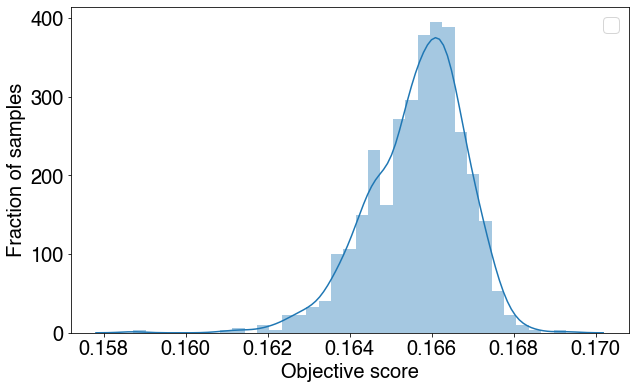

In [240]:
# Plot distribution of objectives
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(scores, norm_hist = True)
ax.set(xlabel= 'Objective score', ylabel = 'Fraction of samples')
# plt.plot([0,0],[0,0.0023], linestyle = '--', color = 'r')
plt.legend()
plt.show()

## Plot 1 episode

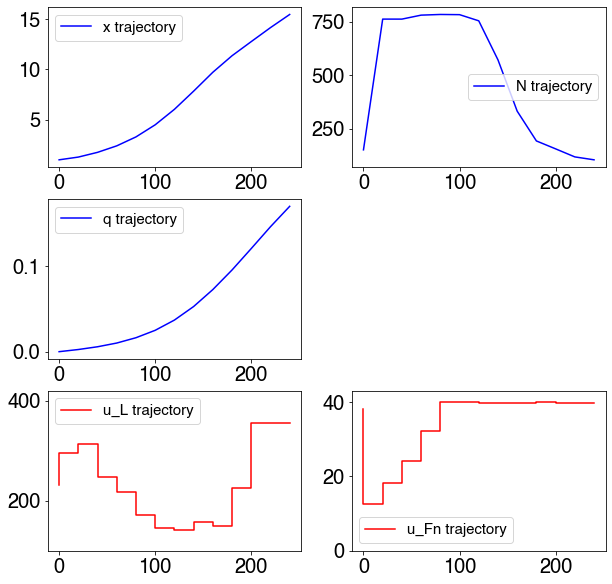

Score: 0.16989606412604974


In [221]:
# Run 1 episode
episode = generate_episode_with_NN(GA_optimize_constrained, [1.0, 150.0, 0, 0], epsilon = 0, 
                                   g1_threshold = 0,
                                   g2_threshold = 0,
                                   g3_threshold = 0)
plot_episode(episode)

## Save neural networks

In [249]:
# # Save neural network
# torch.save(Q_net, './NN_models/CS1_Q_net_g1g2g3_noise_1000_ep')
# # Save neural network
# torch.save(g1_net, './NN_models/CS1_g1_net_g1g2g3_noise_1000_ep')
# # Save neural network
# torch.save(g2_net, './NN_models/CS1_g2_net_g1g2g3_noise_1000_ep')
# # Save neural network
# torch.save(g3_net, './NN_models/CS1_g3_net_g1g2g3_noise_1000_ep')


# Load pre-trained neural network
# Q_net = torch.load('./NN_models/CS1_Q_net_g1g2g3_noise_1000_ep')
# Q_net.eval()
# # Load pre-trained neural network
# g1_net = torch.load('./NN_models/CS1_g1_net_g1g2g3_noise_1000_ep')
# g1_net.eval()
# # Load pre-trained neural network
# g2_net = torch.load('./NN_models/CS1_g2_net_g1g2g3_noise_1000_ep')
# g2_net.eval()
# # Load pre-trained neural network
# g3_net = torch.load('./NN_models/CS1_g3_net_g1g2g3_noise_1000_ep')
# g3_net.eval()

## Plot objective score and Q-network loss

No handles with labels found to put in legend.


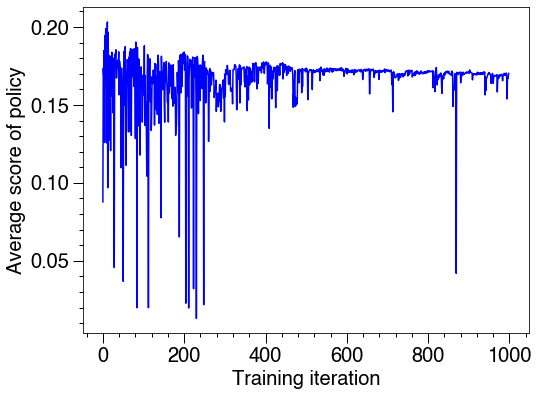

No handles with labels found to put in legend.


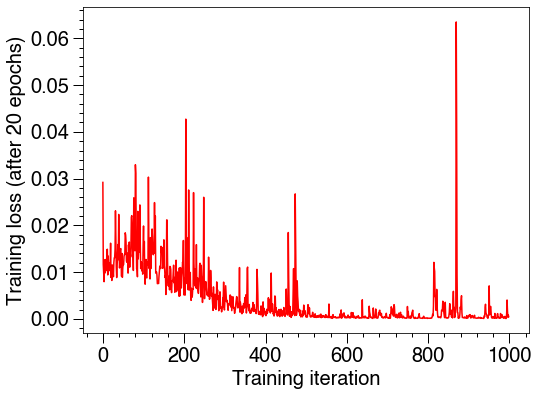

In [250]:
iteration_list = range(2000)
# Save data
# with open('./Data/CS1_score_g1g2g3_noise_1000_ep', 'wb') as f:
#     pickle.dump(score_list, f, pickle.HIGHEST_PROTOCOL)
# with open('./Data/CS1_loss_g1g2g3_noise_1000_ep', 'wb') as f:
#     pickle.dump(training_loss_list, f, pickle.HIGHEST_PROTOCOL)

# Load pre-run data
# with open('./Data/CS1_score_g1g2g3_noise_1000_ep', 'rb') as f:
#     score_list = pickle.load(f)
# with open('./Data/CS1_loss_g1g2g3_noise_1000_ep', 'rb') as f:
#     training_loss_list = pickle.load(f)

# Plot score vs. training iteration
fig, ax = plt.subplots(figsize=(8,6))
ax.minorticks_on()
ax.xaxis.set_minor_locator(AutoMinorLocator(5))
ax.yaxis.set_minor_locator(AutoMinorLocator(5))
ax.tick_params(which='major', length=10, width=1, direction='out')
ax.tick_params(which='minor', length=4, width=1, direction='out')
plt.plot(iteration_list[:len(score_list)], score_list, color = 'b')
plt.legend(frameon =  0)
plt.ylabel('Average score of policy', fontsize = 20)
plt.xlabel('Training iteration', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

# Plot training loss vs. training iteration
fig, ax = plt.subplots(figsize=(8,6))
ax.minorticks_on()
ax.xaxis.set_minor_locator(AutoMinorLocator(5))
ax.yaxis.set_minor_locator(AutoMinorLocator(5))
ax.tick_params(which='major', length=10, width=1, direction='out')
ax.tick_params(which='minor', length=4, width=1, direction='out')
plt.plot(iteration_list[:len(score_list)], training_loss_list, color = 'r')
plt.legend(frameon =  0)
plt.ylabel('Training loss (after 20 epochs)', fontsize = 20)
plt.xlabel('Training iteration', fontsize = 20)
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.show()

## Plot MC episodes and explore state space

In [1017]:
# # Generate g1_threshold
# g1_threshold_list = []
# g1_threshold = 500
# g2_threshold_list = []
# g2_threshold = 0.05
# for i in range(2000):
#     g1_threshold_list += [g1_threshold]
#     g1_threshold *= 0.995
#     g2_threshold_list += [g2_threshold]
#     g2_threshold *= 0.995

In [246]:
# # Save data to csv
# plotting_state_data.to_csv(r'./Data/CS1_state_space_g1g2g3_noise_1000_ep.csv', index = False)
# # Load data as pd.DataFrame
# plotting_state_data = pd.read_csv('./Data/CS1_state_space_g1g2g3_noise_1000_ep.csv')

In [232]:
# Generate data using random policy
plotting_state_data = []
for i in range(1000):
    initialize_MDP_BioEnv() # Initialize system
    try:
        episode      = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = 0,
                                                 g2_threshold = -0.001, # Backoff needed for g2
                                                 g3_threshold = 0)
    except KeyboardInterrupt:
        episode      = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = 0,
                                                 g2_threshold = -0.001,
                                                 g3_threshold = 0)
    data = extract_data_from_episode(episode, discount_factor = 0.9)   # Extract datapoint from episode
    for j in data:
        j = j[:-1]
        plotting_state_data += j  # Add datapoints to training set

# plotting_state_data
plotting_state_data = pd.DataFrame(plotting_state_data)

try:
    plotting_state_data_g1_violated = plotting_state_data[plotting_state_data[1] - 800 > 0] # Conpath 1
    plotting_state_data_g2_violated = plotting_state_data[plotting_state_data[2] - 0.011*plotting_state_data[0] > 0] # Conpath 2
    plotting_state_data_g3_violated = plotting_state_data[(plotting_state_data[3] == 240.0) & (plotting_state_data[1] - 150 > 0)] # Terminal constraint
except:
    plotting_state_data_g1_violated = plotting_state_data[plotting_state_data['1'] - 800 > 0] # Conpath 1
    plotting_state_data_g2_violated = plotting_state_data[plotting_state_data['2'] - 0.011*plotting_state_data['0'] > 0] # Conpath 2
    plotting_state_data_g3_violated = plotting_state_data[(plotting_state_data['3'] == 240.0) & (plotting_state_data['1'] - 150 > 0)] # Terminal constraint
    
print('No. of states visited:',len(plotting_state_data))
print('No. of states where g1 violated:',len(plotting_state_data_g1_violated))
print('No. of states where g2 violated:',len(plotting_state_data_g2_violated))
print('No. of states where g3 violated:',len(plotting_state_data_g3_violated))

try: 
    Cx_all = plotting_state_data[0]
    Cn_all = plotting_state_data[1]
    Cq_all = plotting_state_data[2]
    Cx_g1 = plotting_state_data_g1_violated[0]
    Cn_g1 = plotting_state_data_g1_violated[1]
    Cq_g1 = plotting_state_data_g1_violated[2]
    Cx_g2 = plotting_state_data_g2_violated[0]
    Cn_g2 = plotting_state_data_g2_violated[1]
    Cq_g2 = plotting_state_data_g2_violated[2]
    Cx_g3 = plotting_state_data_g3_violated[0]
    Cn_g3 = plotting_state_data_g3_violated[1]
    Cq_g3 = plotting_state_data_g3_violated[2]
except:
    Cx_all = plotting_state_data['0']
    Cn_all = plotting_state_data['1']
    Cq_all = plotting_state_data['2']
    Cx_g1 = plotting_state_data_g1_violated['0']
    Cn_g1 = plotting_state_data_g1_violated['1']
    Cq_g1 = plotting_state_data_g1_violated['2']
    Cx_g2 = plotting_state_data_g2_violated['0']
    Cn_g2 = plotting_state_data_g2_violated['1']
    Cq_g2 = plotting_state_data_g2_violated['2']
    Cx_g3 = plotting_state_data_g3_violated['0']
    Cn_g3 = plotting_state_data_g3_violated['1']
    Cq_g3 = plotting_state_data_g3_violated['2']

@interact(ns=(-90,90,0.1),ew=(-90,90,0.1))
def interact_poly(ns,ew):
    fig = plt.figure(figsize = (10,7))
    ax = plt.axes(projection='3d')

    # Data for a three-dimensional line
    ax.plot3D(Cx_all, Cn_all, Cq_all, 'g', label = 'no violation', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g1, Cn_g1, Cq_g1, 'r', label = 'g1', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g2, Cn_g2, Cq_g2, 'b', label = 'g2', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g3, Cn_g3, Cq_g3, 'black', label = 'g3', linestyle = '', marker = 'o', markersize = 1)
    plt.xlabel('$C_x$', labelpad=30)
    plt.ylabel('$C_n$', labelpad=50)
    ax.set_zlabel('$C_q$', fontsize=20, labelpad=20)
    plt.legend()
    plt.xticks(rotation=90)
    plt.yticks(rotation=90)
    plt.xlim(0,16)
    plt.ylim(0,2200)
    ax.set_zlim(0, 0.25)
    ax.view_init(ns,ew)
    plt.show()

No. of states visited: 13000
No. of states where g1 violated: 0
No. of states where g2 violated: 0
No. of states where g3 violated: 0


interactive(children=(FloatSlider(value=0.0, description='ns', max=90.0, min=-90.0), FloatSlider(value=0.0, de…

## Plot evolution of state space and save to gif

In [55]:
init_g1_threshold = 500
init_g2_threshold = 0.05
g1_threshold_list = [500]
g2_threshold_list = [0.05]
for i in range(2000):
    init_g1_threshold *= 0.995
    init_g2_threshold *= 0.995
    g1_threshold_list += [init_g1_threshold]
    g2_threshold_list += [init_g2_threshold]
g1_threshold_list

[500,
 497.5,
 495.0125,
 492.5374375,
 490.0747503125,
 487.6243765609375,
 485.1862546781328,
 482.7603234047421,
 480.3465217877184,
 477.94478917877984,
 475.55506523288597,
 473.1772899067215,
 470.8114034571879,
 468.457346439902,
 466.11505970770247,
 463.78448440916395,
 461.4655619871181,
 459.1582341771825,
 456.8624430062966,
 454.5781307912651,
 452.3052401373088,
 450.0437139366222,
 447.7934953669391,
 445.5545278901044,
 443.3267552506539,
 441.1101214744006,
 438.9045708670286,
 436.71004801269345,
 434.52649777262997,
 432.3538652837668,
 430.192095957348,
 428.0411354775612,
 425.9009298001734,
 423.77142515117254,
 421.65256802541666,
 419.54430518528955,
 417.4465836593631,
 415.3593507410663,
 413.282553987361,
 411.2161412174242,
 409.16006051133706,
 407.11426020878037,
 405.0786889077365,
 403.0532954631978,
 401.0380289858818,
 399.03283884095237,
 397.0376746467476,
 395.05248627351386,
 393.0772238421463,
 391.11183772293555,
 389.15627853432085,
 387.2104971

In [251]:
# SAVING EPISODE BANK - JSON WORKS BUT NOT PICKLE BCOS NESTED LIST
# # open output file for writing
# with open('./Data/CS1_episode_bank_g1g2g3_noise_1000_ep', 'w') as f:
#     json.dump(episode_bank, f)
# # open output file for reading
# with open('./Data/CS1_episode_bank_g1g2g3_noise_1000_ep', 'r') as f:
#     episode_bank = json.load(f)

No. of states visited: 130
No. of states where g1 violated: 52
No. of states where g2 violated: 0
No. of states where g3 violated: 0


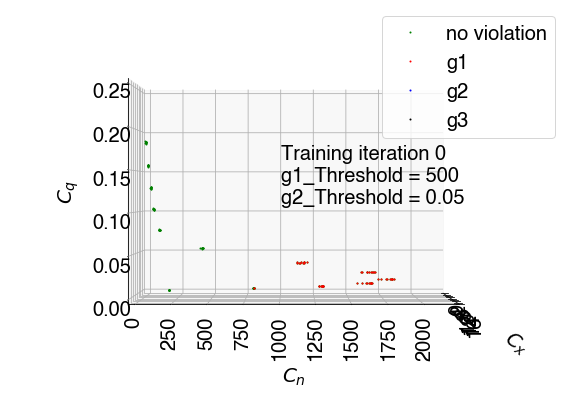

No. of states visited: 130
No. of states where g1 violated: 18
No. of states where g2 violated: 28
No. of states where g3 violated: 10


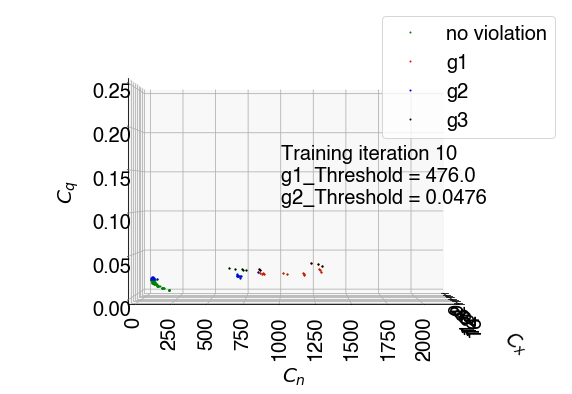

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 0
No. of states where g3 violated: 0


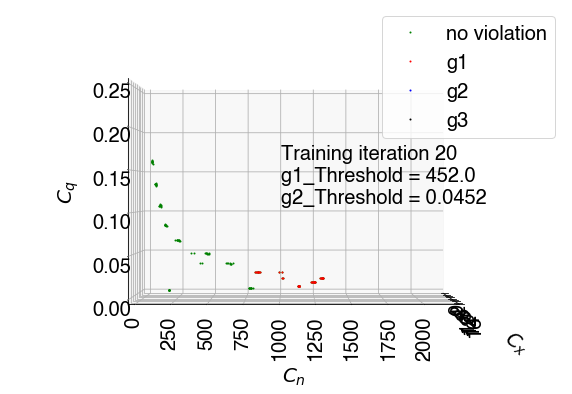

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 0
No. of states where g3 violated: 0


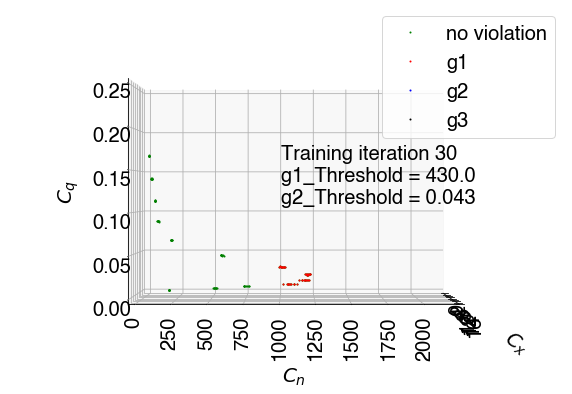

No. of states visited: 130
No. of states where g1 violated: 41
No. of states where g2 violated: 10
No. of states where g3 violated: 0


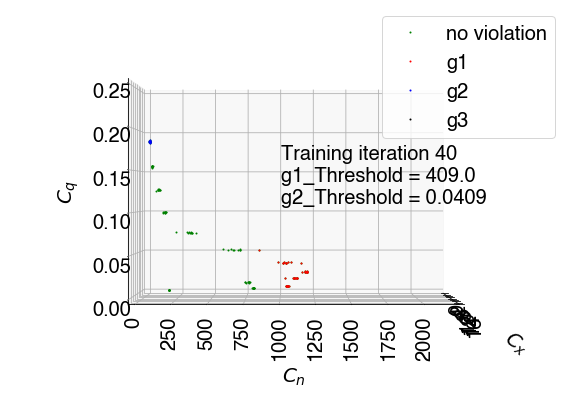

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 5
No. of states where g3 violated: 10


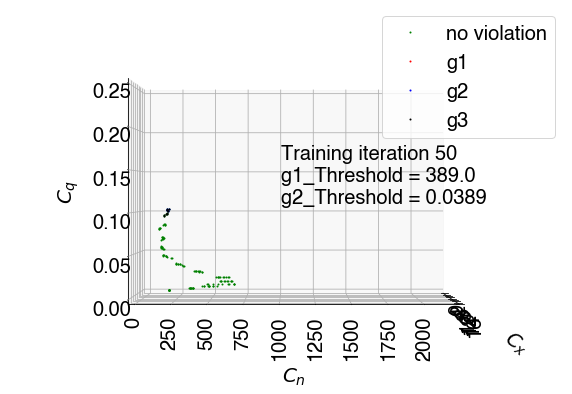

No. of states visited: 130
No. of states where g1 violated: 51
No. of states where g2 violated: 10
No. of states where g3 violated: 0


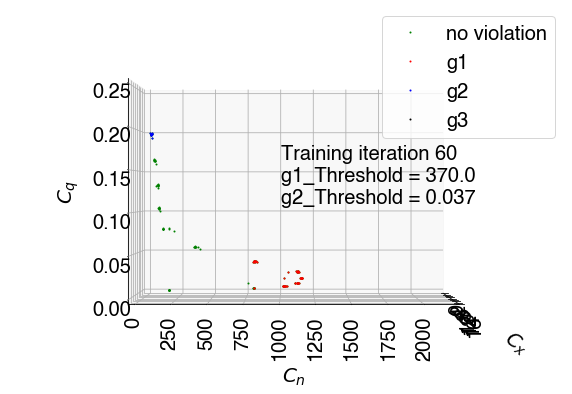

No. of states visited: 130
No. of states where g1 violated: 50
No. of states where g2 violated: 10
No. of states where g3 violated: 0


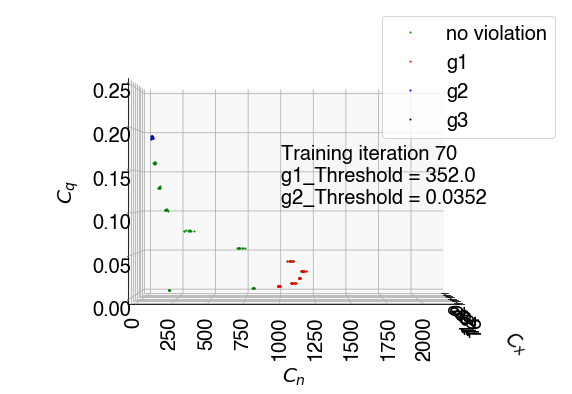

No. of states visited: 130
No. of states where g1 violated: 50
No. of states where g2 violated: 8
No. of states where g3 violated: 0


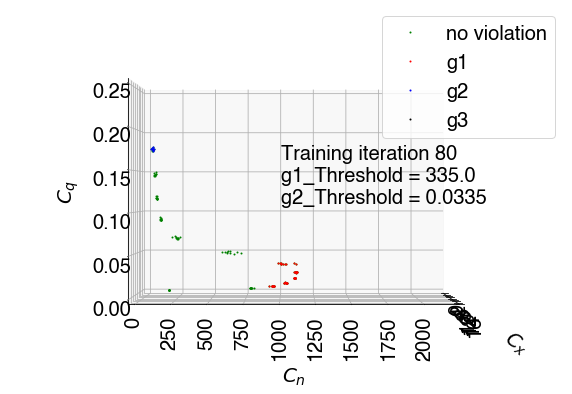

No. of states visited: 130
No. of states where g1 violated: 28
No. of states where g2 violated: 10
No. of states where g3 violated: 0


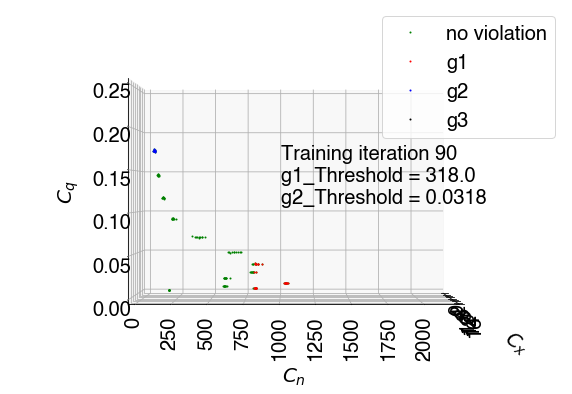

No. of states visited: 130
No. of states where g1 violated: 59
No. of states where g2 violated: 0
No. of states where g3 violated: 0


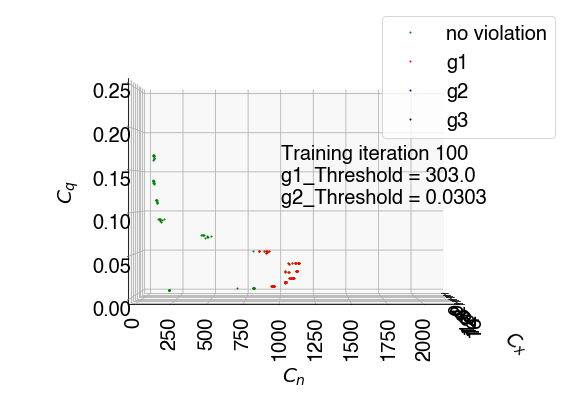

No. of states visited: 130
No. of states where g1 violated: 39
No. of states where g2 violated: 10
No. of states where g3 violated: 0


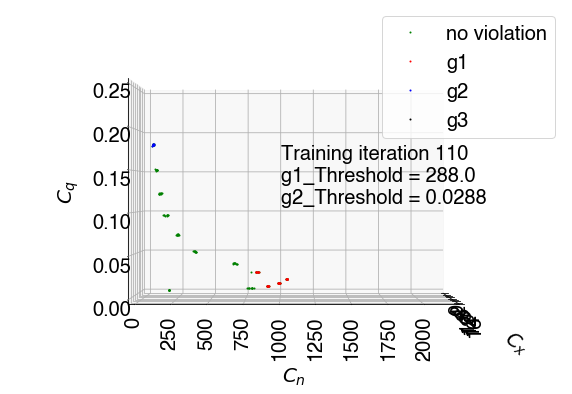

No. of states visited: 130
No. of states where g1 violated: 42
No. of states where g2 violated: 10
No. of states where g3 violated: 0


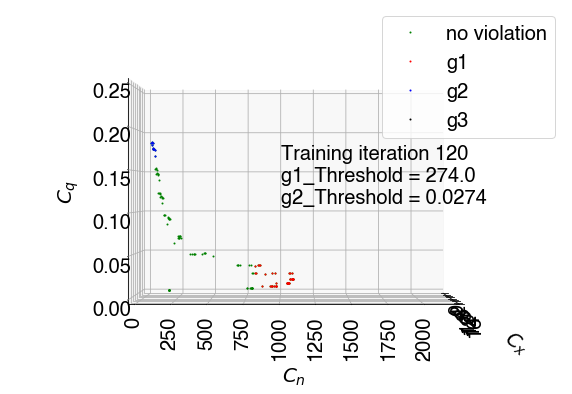

No. of states visited: 130
No. of states where g1 violated: 20
No. of states where g2 violated: 0
No. of states where g3 violated: 0


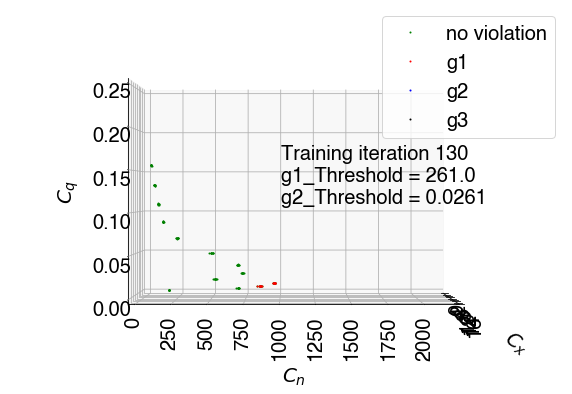

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


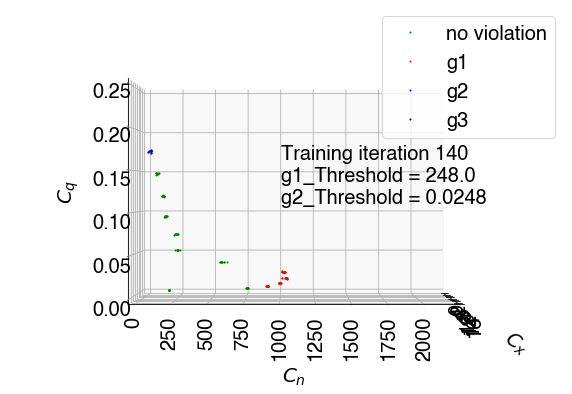

No. of states visited: 130
No. of states where g1 violated: 47
No. of states where g2 violated: 0
No. of states where g3 violated: 0


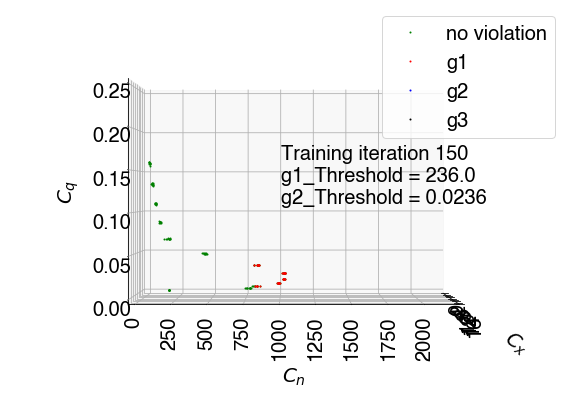

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


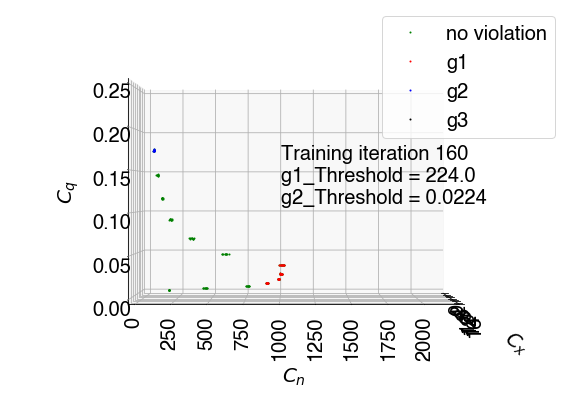

No. of states visited: 130
No. of states where g1 violated: 36
No. of states where g2 violated: 6
No. of states where g3 violated: 0


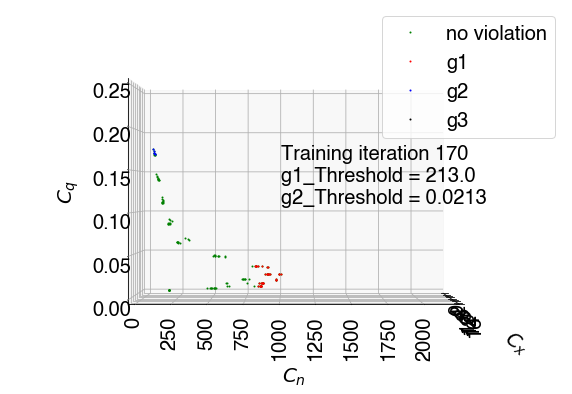

No. of states visited: 130
No. of states where g1 violated: 48
No. of states where g2 violated: 10
No. of states where g3 violated: 0


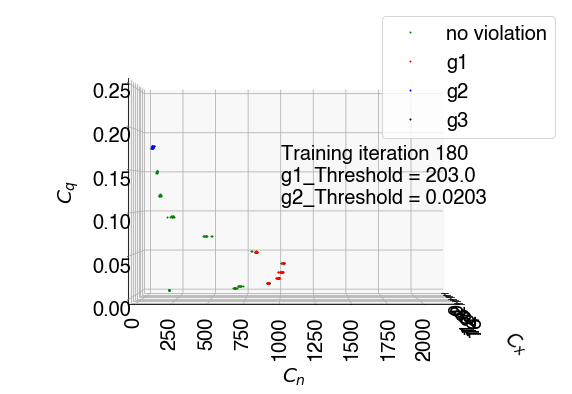

No. of states visited: 130
No. of states where g1 violated: 32
No. of states where g2 violated: 8
No. of states where g3 violated: 0


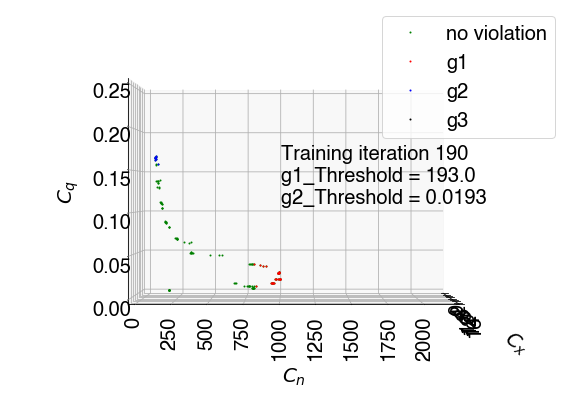

No. of states visited: 130
No. of states where g1 violated: 42
No. of states where g2 violated: 0
No. of states where g3 violated: 0


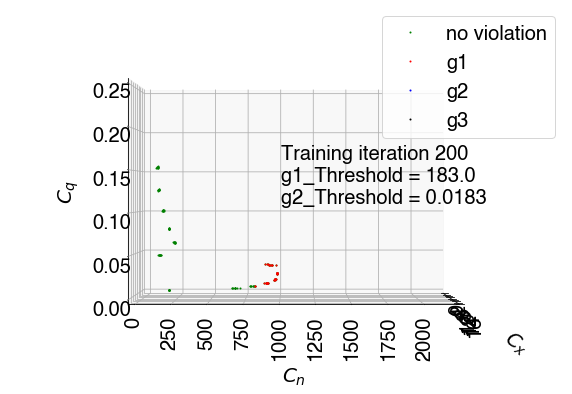

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


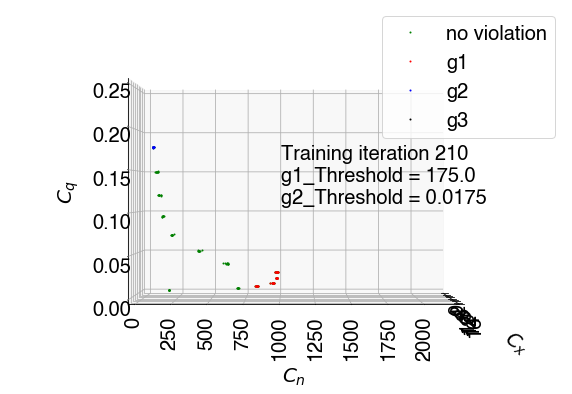

No. of states visited: 130
No. of states where g1 violated: 47
No. of states where g2 violated: 0
No. of states where g3 violated: 0


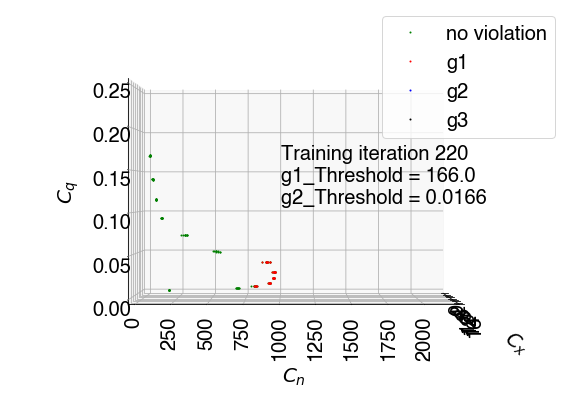

No. of states visited: 130
No. of states where g1 violated: 37
No. of states where g2 violated: 10
No. of states where g3 violated: 0


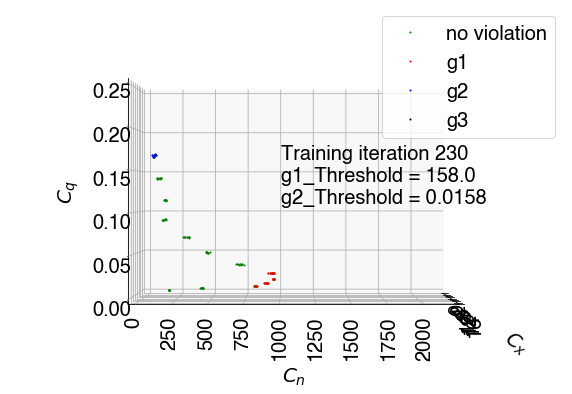

No. of states visited: 130
No. of states where g1 violated: 49
No. of states where g2 violated: 10
No. of states where g3 violated: 0


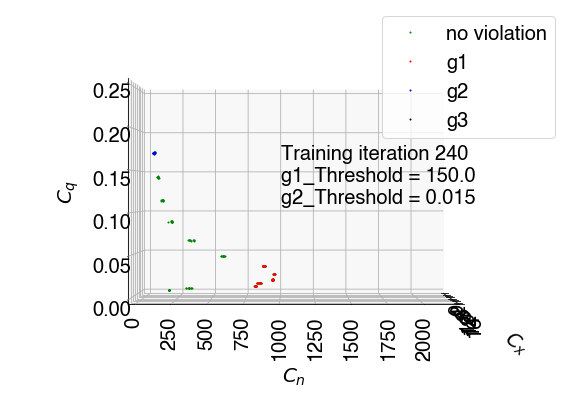

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 0
No. of states where g3 violated: 0


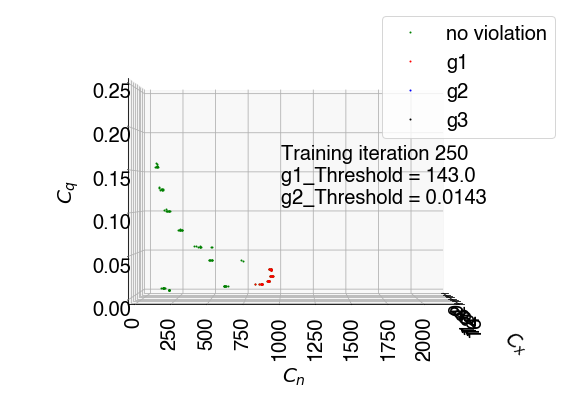

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


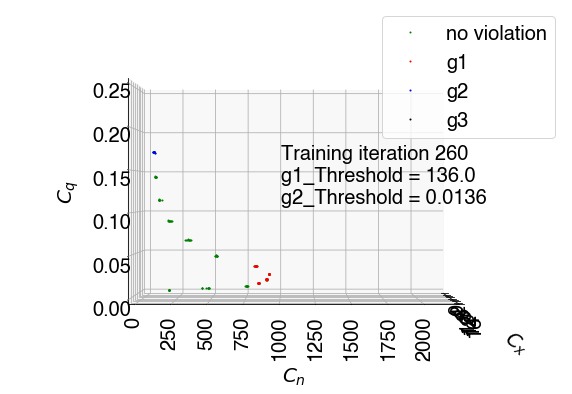

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 57
No. of states where g3 violated: 0


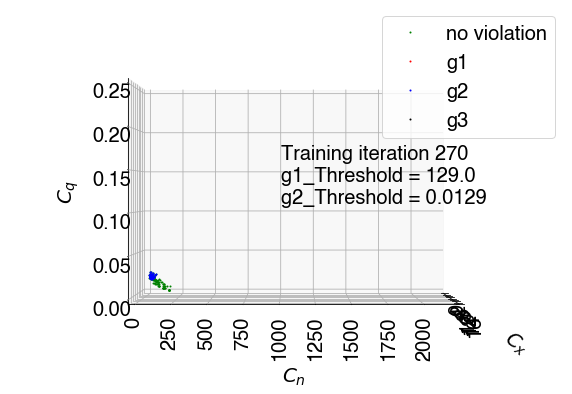

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


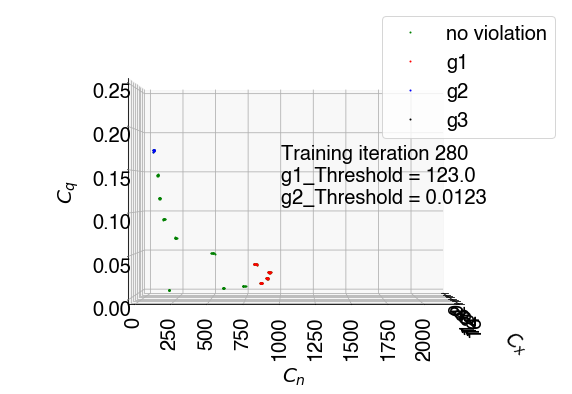

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 3
No. of states where g3 violated: 0


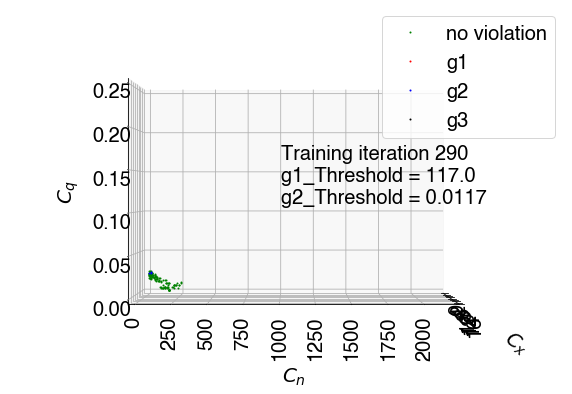

No. of states visited: 117
No. of states where g1 violated: 43
No. of states where g2 violated: 7
No. of states where g3 violated: 0


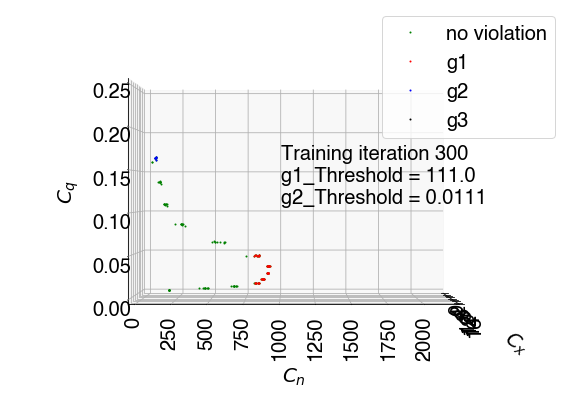

No. of states visited: 130
No. of states where g1 violated: 30
No. of states where g2 violated: 0
No. of states where g3 violated: 0


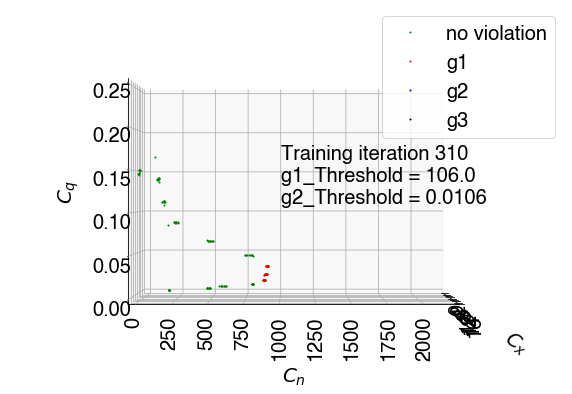

No. of states visited: 130
No. of states where g1 violated: 39
No. of states where g2 violated: 0
No. of states where g3 violated: 0


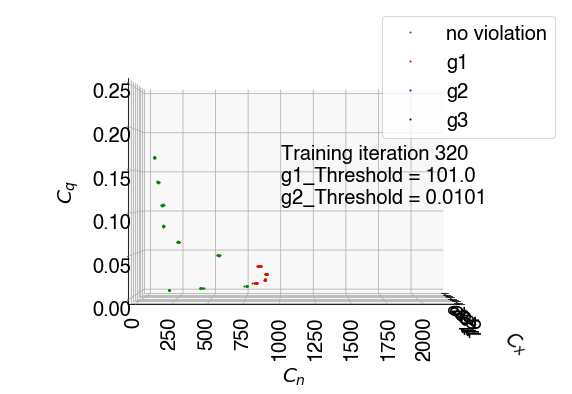

No. of states visited: 117
No. of states where g1 violated: 35
No. of states where g2 violated: 0
No. of states where g3 violated: 0


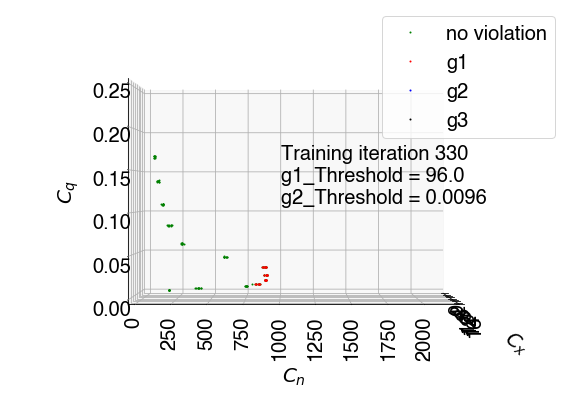

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


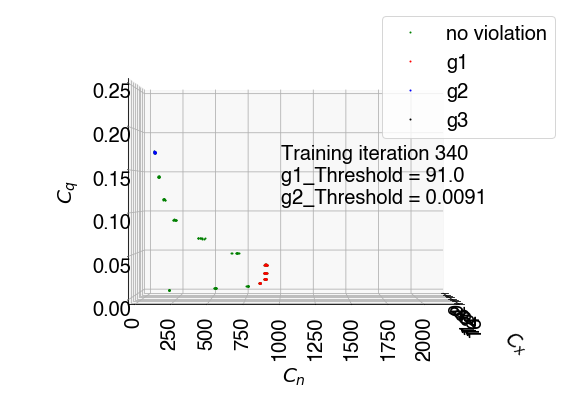

No. of states visited: 117
No. of states where g1 violated: 32
No. of states where g2 violated: 2
No. of states where g3 violated: 0


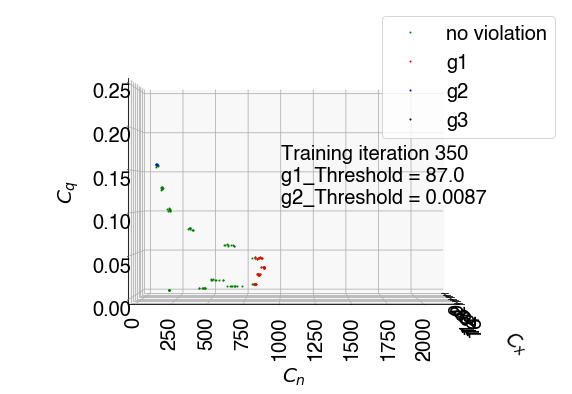

No. of states visited: 130
No. of states where g1 violated: 27
No. of states where g2 violated: 1
No. of states where g3 violated: 0


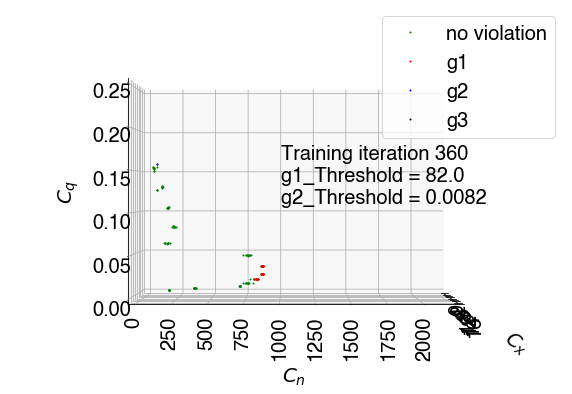

No. of states visited: 130
No. of states where g1 violated: 37
No. of states where g2 violated: 10
No. of states where g3 violated: 0


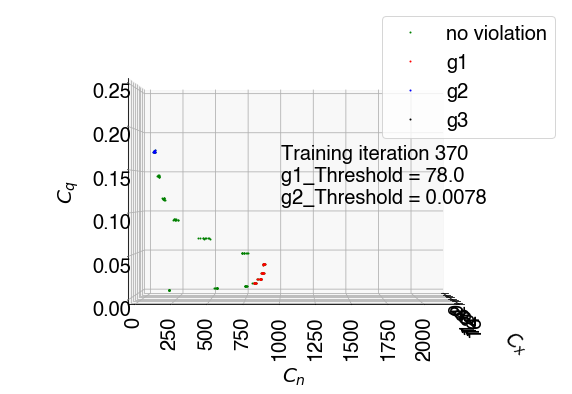

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


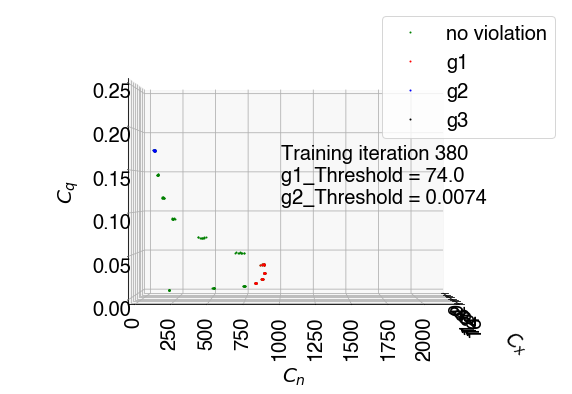

No. of states visited: 130
No. of states where g1 violated: 36
No. of states where g2 violated: 1
No. of states where g3 violated: 0


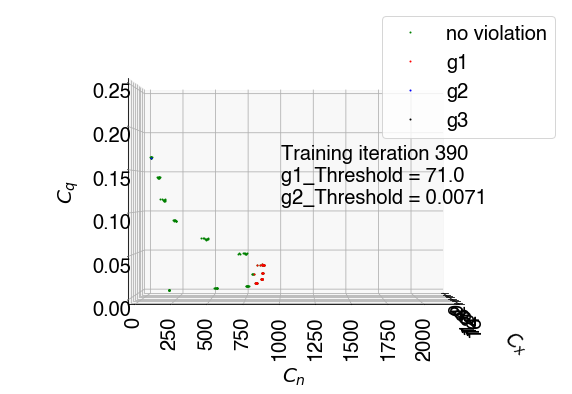

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


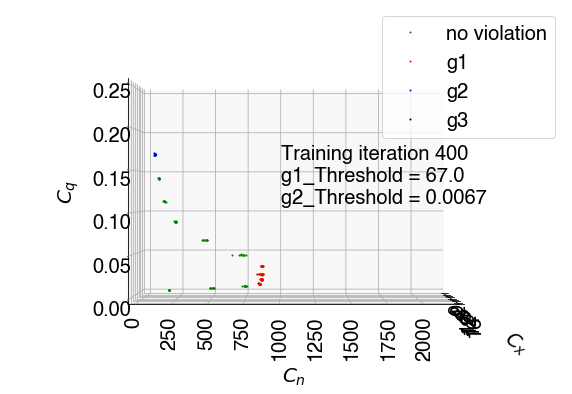

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 10
No. of states where g3 violated: 0


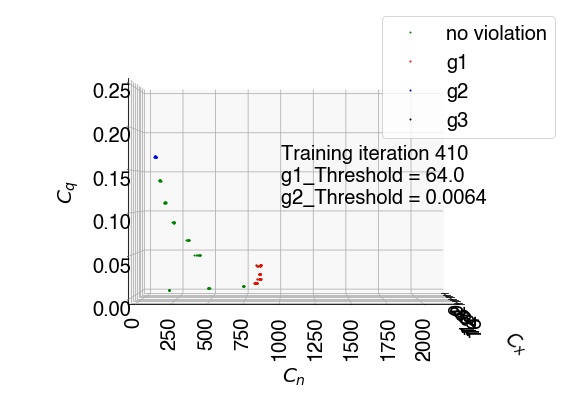

No. of states visited: 130
No. of states where g1 violated: 29
No. of states where g2 violated: 10
No. of states where g3 violated: 0


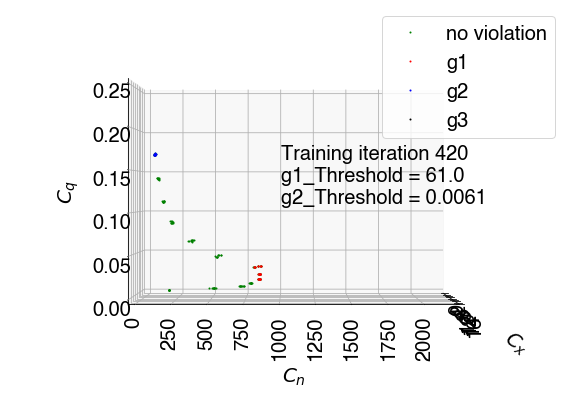

No. of states visited: 130
No. of states where g1 violated: 40
No. of states where g2 violated: 0
No. of states where g3 violated: 0


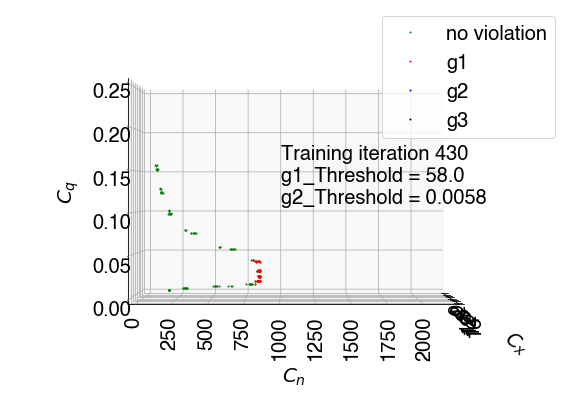

No. of states visited: 130
No. of states where g1 violated: 31
No. of states where g2 violated: 9
No. of states where g3 violated: 0


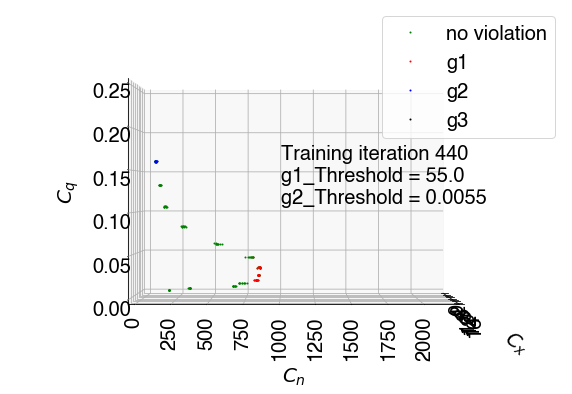

No. of states visited: 117
No. of states where g1 violated: 28
No. of states where g2 violated: 9
No. of states where g3 violated: 0


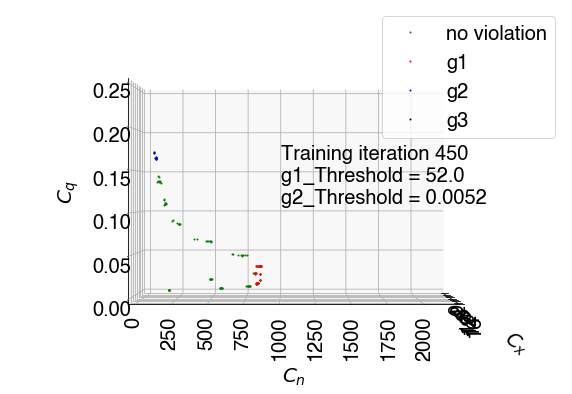

No. of states visited: 130
No. of states where g1 violated: 38
No. of states where g2 violated: 11
No. of states where g3 violated: 0


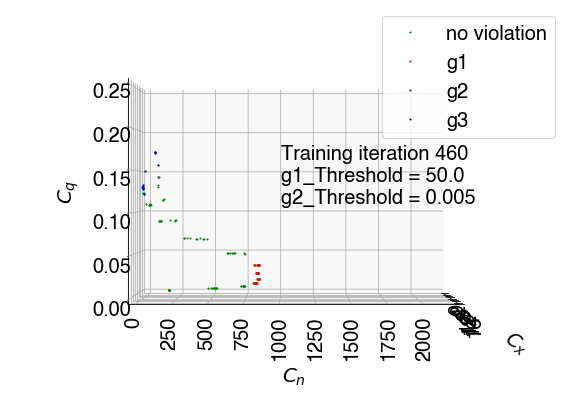

No. of states visited: 130
No. of states where g1 violated: 36
No. of states where g2 violated: 10
No. of states where g3 violated: 0


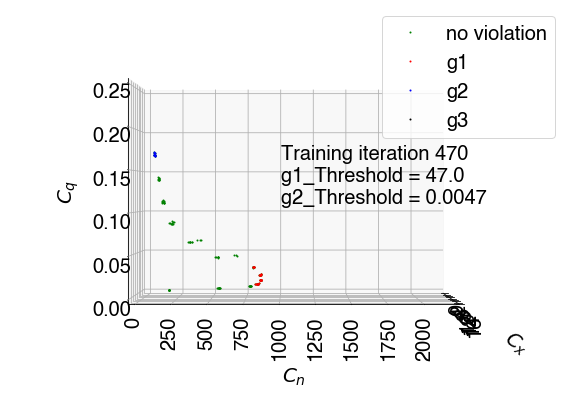

No. of states visited: 130
No. of states where g1 violated: 26
No. of states where g2 violated: 2
No. of states where g3 violated: 0


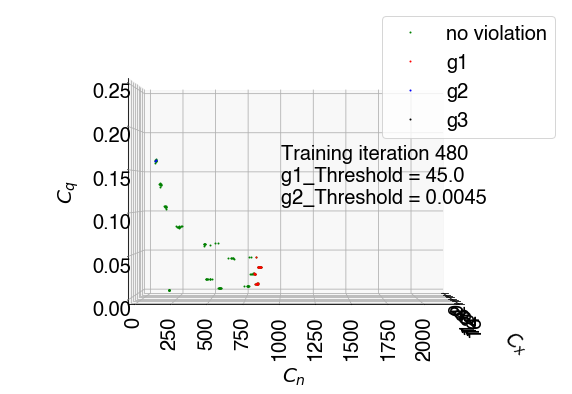

No. of states visited: 130
No. of states where g1 violated: 21
No. of states where g2 violated: 0
No. of states where g3 violated: 0


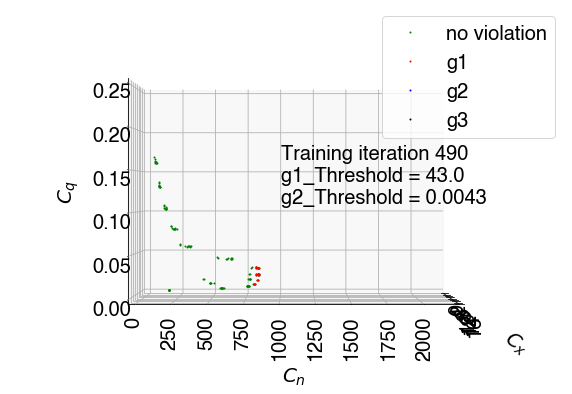

No. of states visited: 130
No. of states where g1 violated: 15
No. of states where g2 violated: 10
No. of states where g3 violated: 0


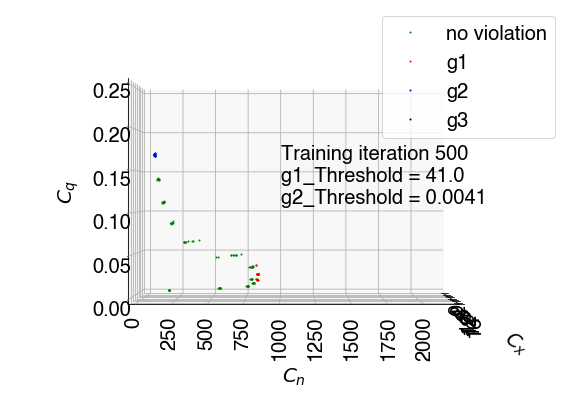

No. of states visited: 130
No. of states where g1 violated: 19
No. of states where g2 violated: 0
No. of states where g3 violated: 0


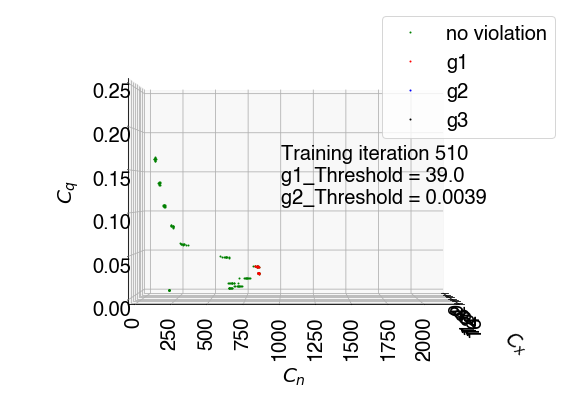

No. of states visited: 130
No. of states where g1 violated: 19
No. of states where g2 violated: 10
No. of states where g3 violated: 0


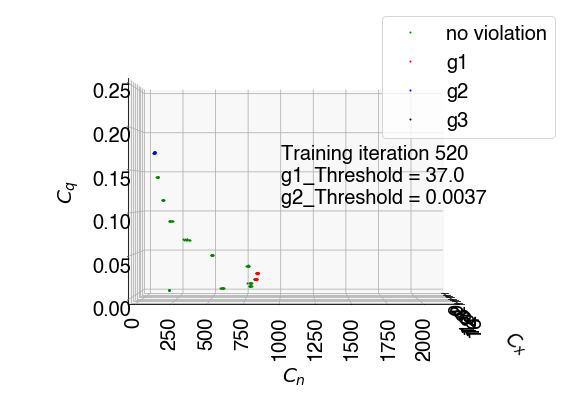

No. of states visited: 130
No. of states where g1 violated: 28
No. of states where g2 violated: 10
No. of states where g3 violated: 0


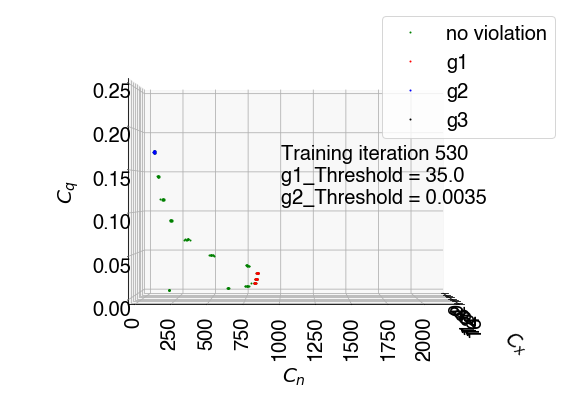

No. of states visited: 130
No. of states where g1 violated: 20
No. of states where g2 violated: 10
No. of states where g3 violated: 0


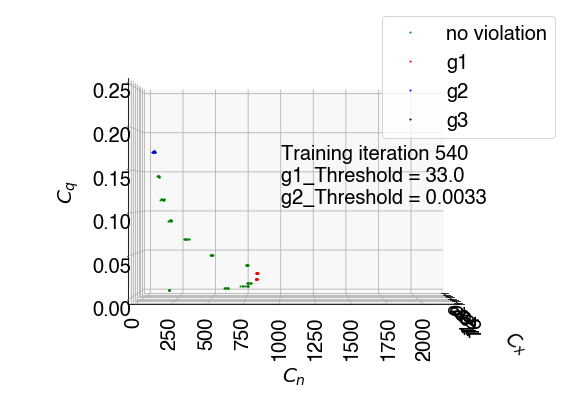

No. of states visited: 130
No. of states where g1 violated: 28
No. of states where g2 violated: 10
No. of states where g3 violated: 0


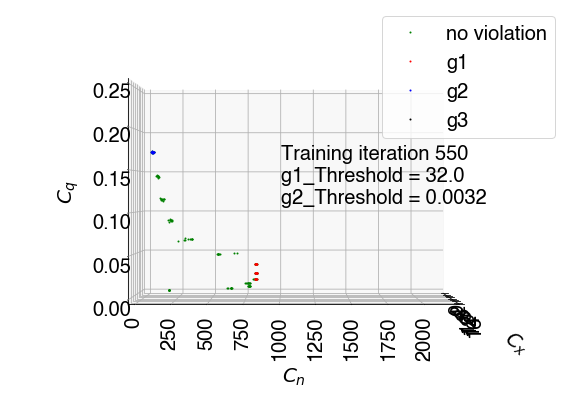

No. of states visited: 130
No. of states where g1 violated: 27
No. of states where g2 violated: 0
No. of states where g3 violated: 0


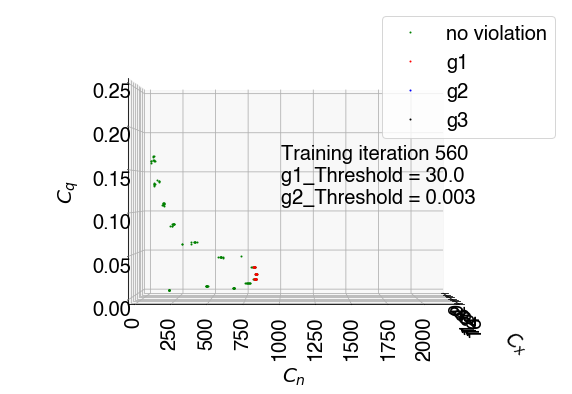

No. of states visited: 130
No. of states where g1 violated: 29
No. of states where g2 violated: 10
No. of states where g3 violated: 0


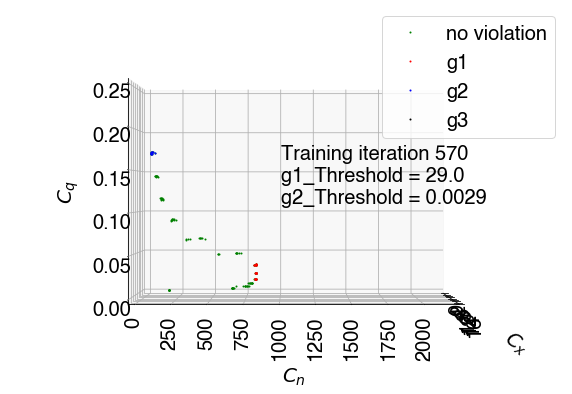

No. of states visited: 130
No. of states where g1 violated: 28
No. of states where g2 violated: 10
No. of states where g3 violated: 0


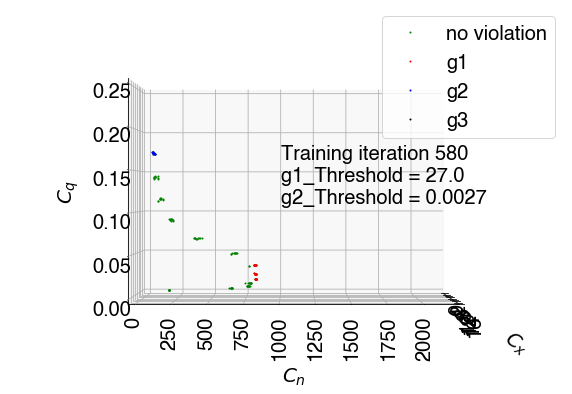

No. of states visited: 130
No. of states where g1 violated: 24
No. of states where g2 violated: 10
No. of states where g3 violated: 0


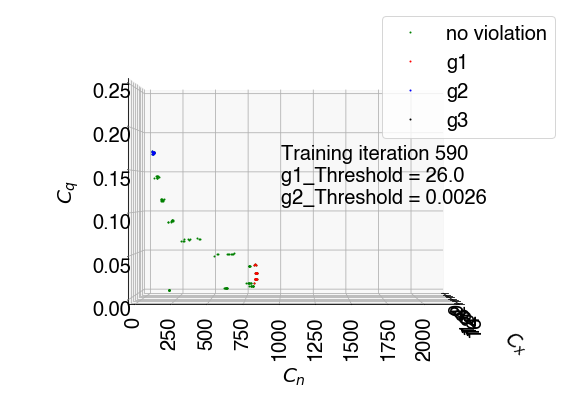

No. of states visited: 130
No. of states where g1 violated: 33
No. of states where g2 violated: 10
No. of states where g3 violated: 0


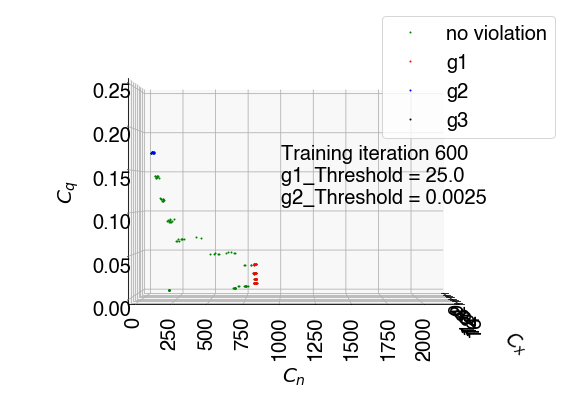

No. of states visited: 130
No. of states where g1 violated: 29
No. of states where g2 violated: 10
No. of states where g3 violated: 0


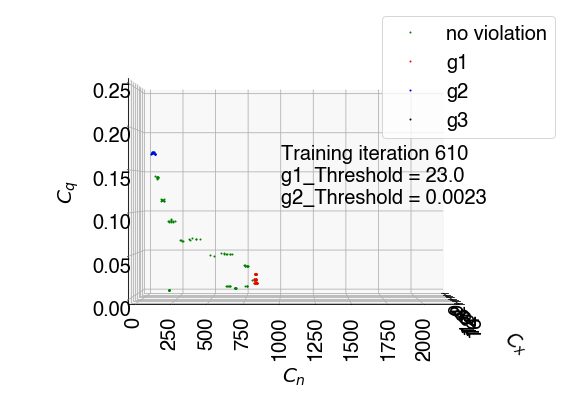

No. of states visited: 130
No. of states where g1 violated: 20
No. of states where g2 violated: 0
No. of states where g3 violated: 0


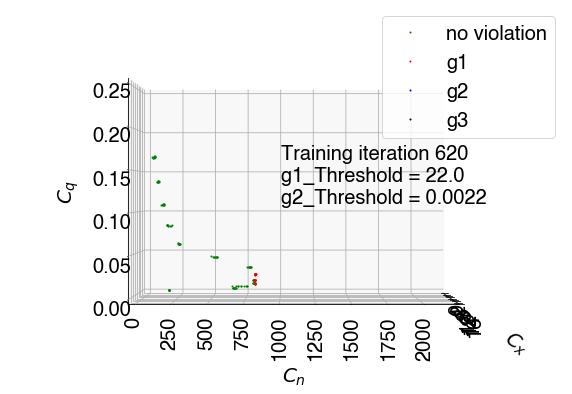

No. of states visited: 130
No. of states where g1 violated: 19
No. of states where g2 violated: 10
No. of states where g3 violated: 0


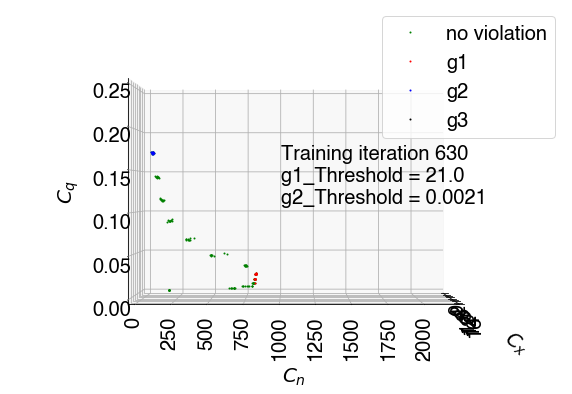

No. of states visited: 130
No. of states where g1 violated: 21
No. of states where g2 violated: 10
No. of states where g3 violated: 0


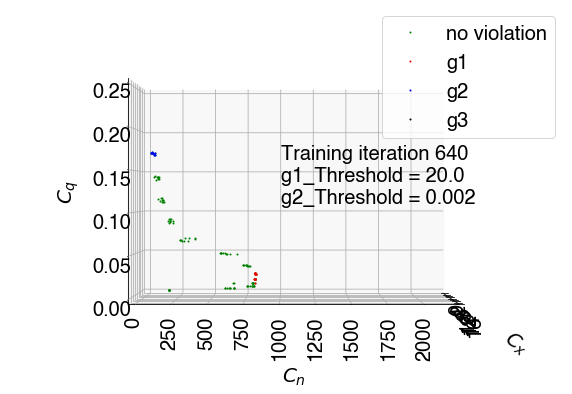

No. of states visited: 130
No. of states where g1 violated: 22
No. of states where g2 violated: 10
No. of states where g3 violated: 0


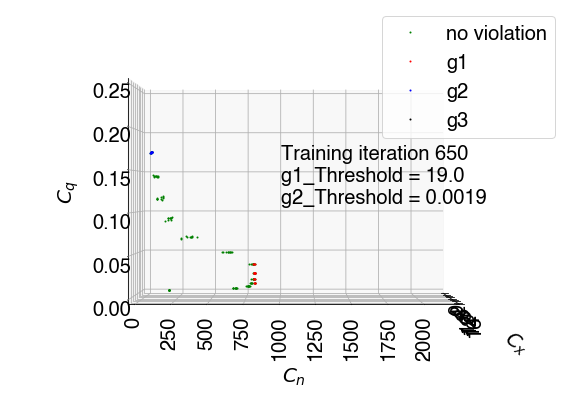

No. of states visited: 117
No. of states where g1 violated: 19
No. of states where g2 violated: 9
No. of states where g3 violated: 0


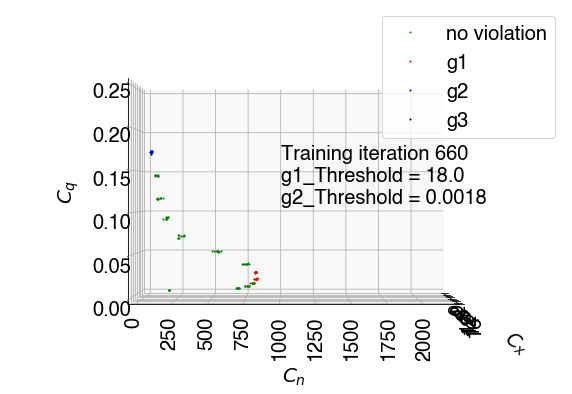

No. of states visited: 130
No. of states where g1 violated: 36
No. of states where g2 violated: 10
No. of states where g3 violated: 0


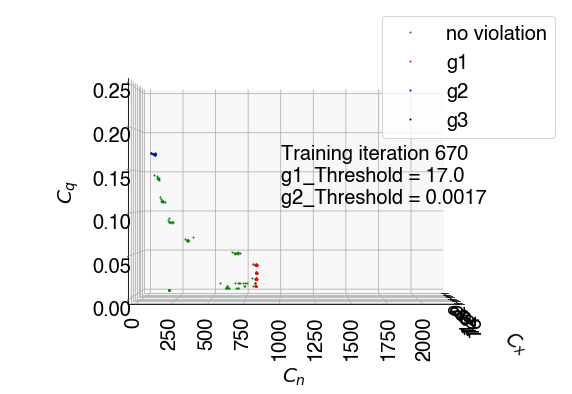

No. of states visited: 130
No. of states where g1 violated: 22
No. of states where g2 violated: 6
No. of states where g3 violated: 0


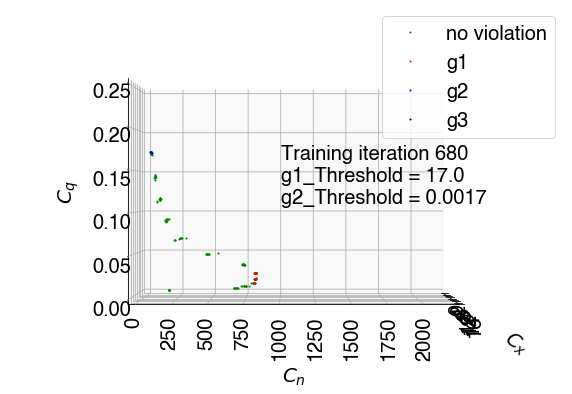

No. of states visited: 130
No. of states where g1 violated: 24
No. of states where g2 violated: 10
No. of states where g3 violated: 0


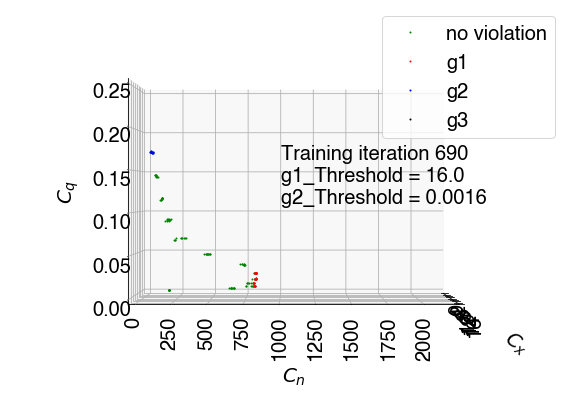

No. of states visited: 130
No. of states where g1 violated: 29
No. of states where g2 violated: 10
No. of states where g3 violated: 0


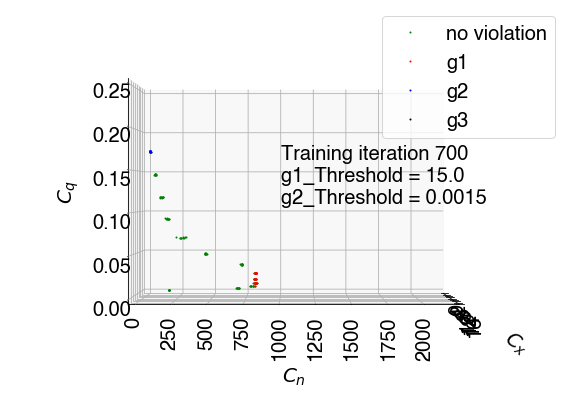

No. of states visited: 130
No. of states where g1 violated: 26
No. of states where g2 violated: 10
No. of states where g3 violated: 0


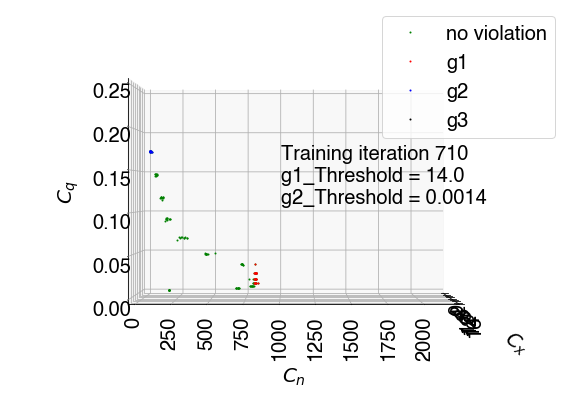

No. of states visited: 130
No. of states where g1 violated: 26
No. of states where g2 violated: 10
No. of states where g3 violated: 0


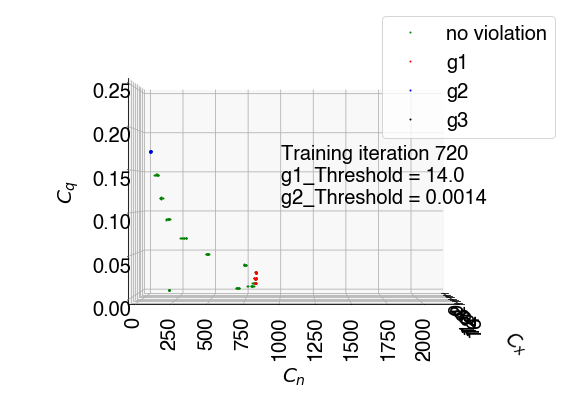

No. of states visited: 130
No. of states where g1 violated: 17
No. of states where g2 violated: 9
No. of states where g3 violated: 0


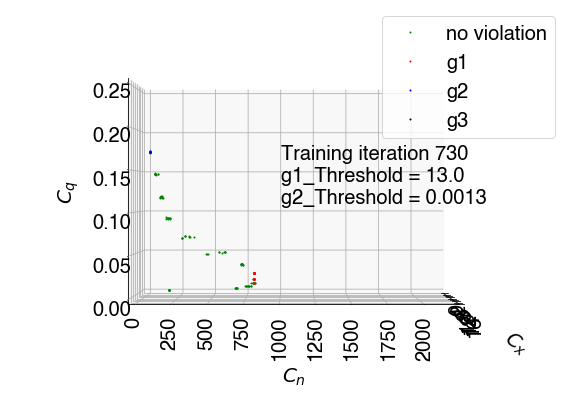

No. of states visited: 130
No. of states where g1 violated: 26
No. of states where g2 violated: 10
No. of states where g3 violated: 0


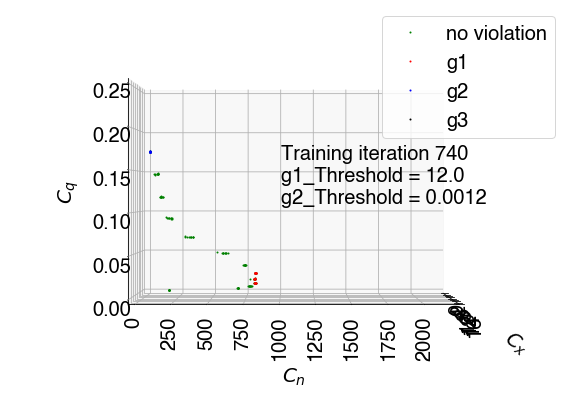

No. of states visited: 130
No. of states where g1 violated: 30
No. of states where g2 violated: 10
No. of states where g3 violated: 0


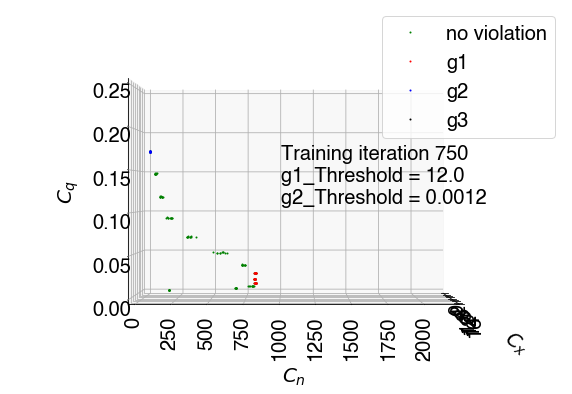

No. of states visited: 130
No. of states where g1 violated: 25
No. of states where g2 violated: 10
No. of states where g3 violated: 0


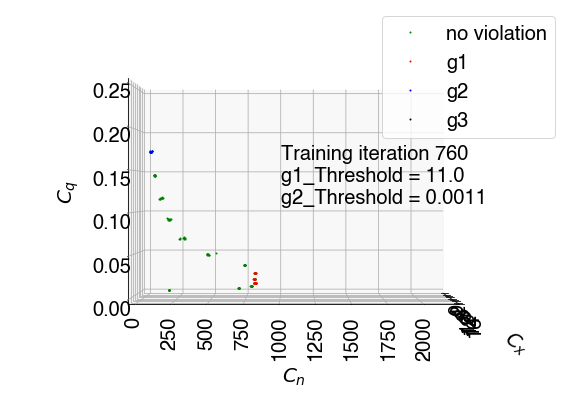

No. of states visited: 130
No. of states where g1 violated: 24
No. of states where g2 violated: 10
No. of states where g3 violated: 0


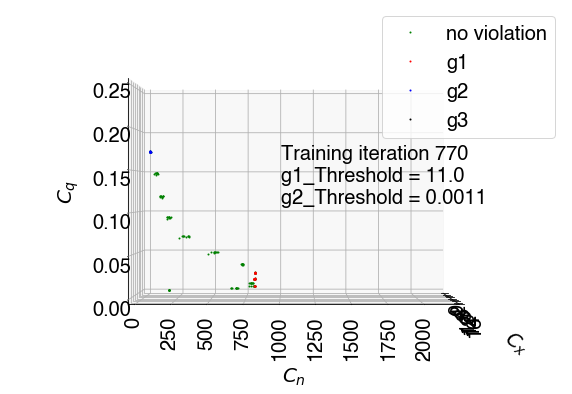

No. of states visited: 130
No. of states where g1 violated: 22
No. of states where g2 violated: 10
No. of states where g3 violated: 0


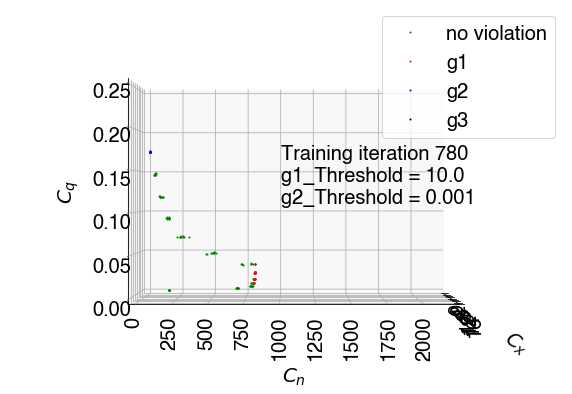

No. of states visited: 130
No. of states where g1 violated: 18
No. of states where g2 violated: 8
No. of states where g3 violated: 0


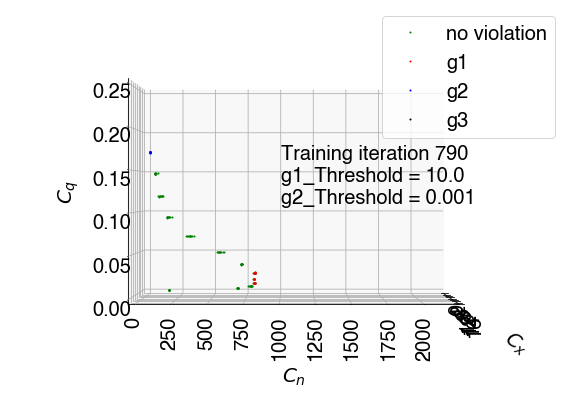

No. of states visited: 130
No. of states where g1 violated: 17
No. of states where g2 violated: 10
No. of states where g3 violated: 0


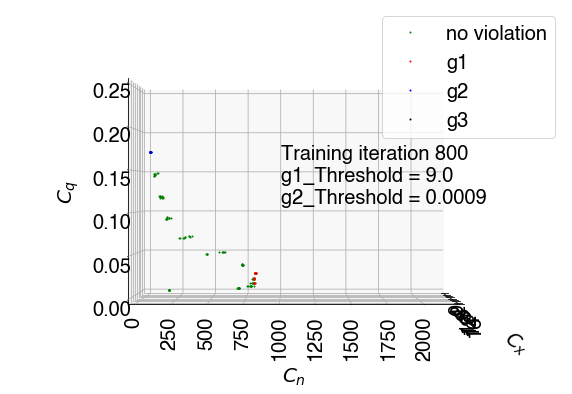

No. of states visited: 130
No. of states where g1 violated: 15
No. of states where g2 violated: 8
No. of states where g3 violated: 0


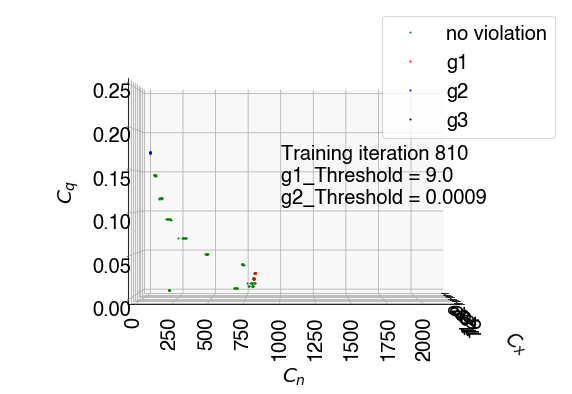

No. of states visited: 130
No. of states where g1 violated: 11
No. of states where g2 violated: 8
No. of states where g3 violated: 0


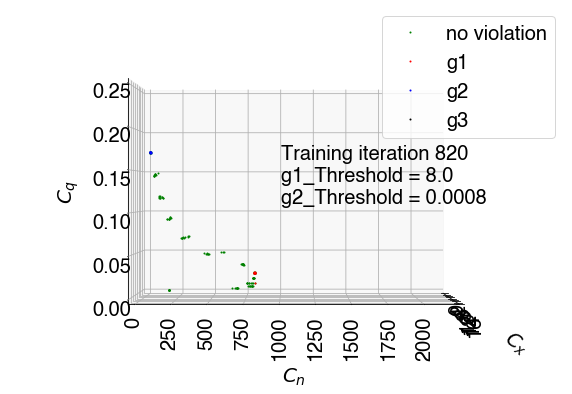

No. of states visited: 130
No. of states where g1 violated: 26
No. of states where g2 violated: 9
No. of states where g3 violated: 0


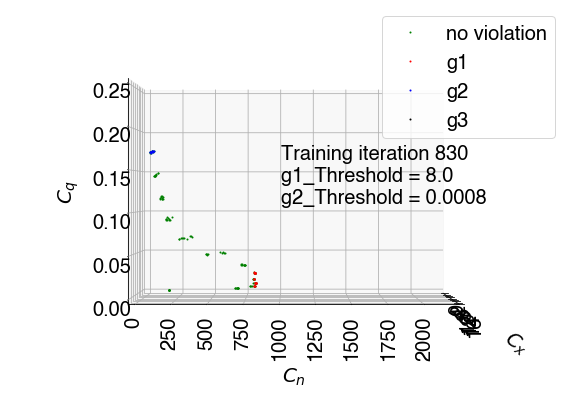

No. of states visited: 130
No. of states where g1 violated: 18
No. of states where g2 violated: 7
No. of states where g3 violated: 0


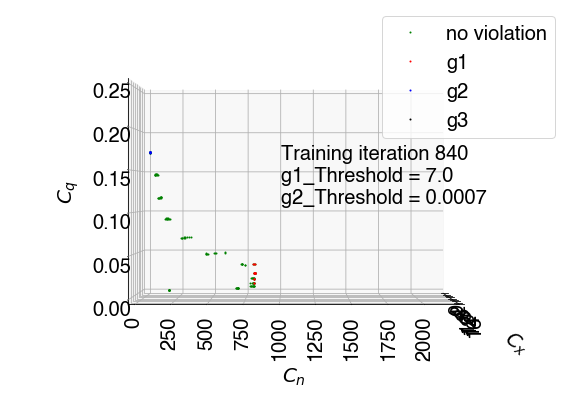

No. of states visited: 130
No. of states where g1 violated: 12
No. of states where g2 violated: 9
No. of states where g3 violated: 0


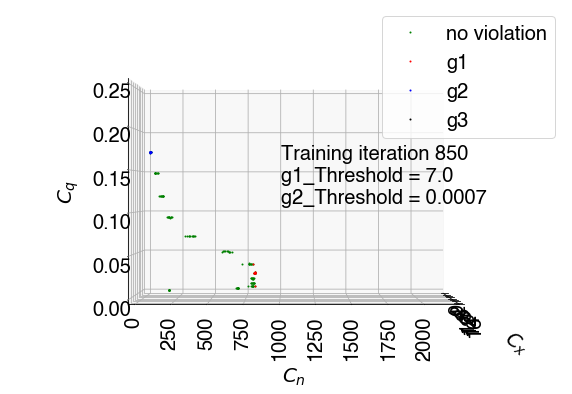

No. of states visited: 130
No. of states where g1 violated: 17
No. of states where g2 violated: 9
No. of states where g3 violated: 0


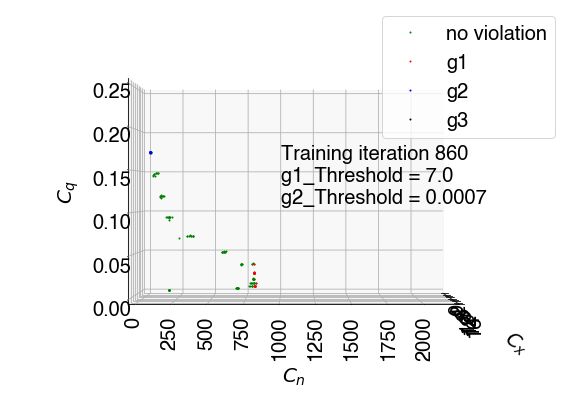

No. of states visited: 130
No. of states where g1 violated: 17
No. of states where g2 violated: 8
No. of states where g3 violated: 0


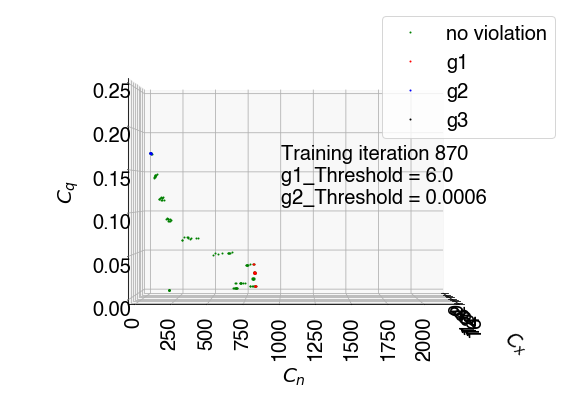

No. of states visited: 130
No. of states where g1 violated: 26
No. of states where g2 violated: 8
No. of states where g3 violated: 0


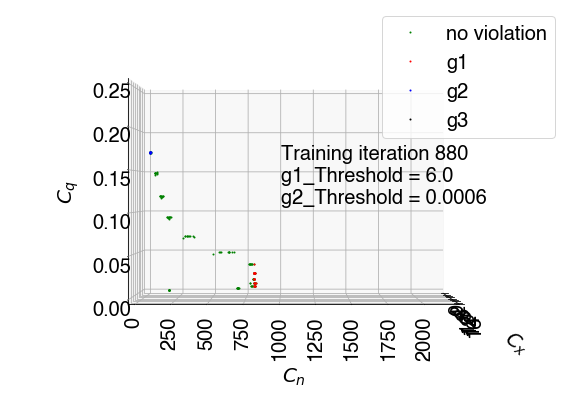

No. of states visited: 130
No. of states where g1 violated: 23
No. of states where g2 violated: 7
No. of states where g3 violated: 0


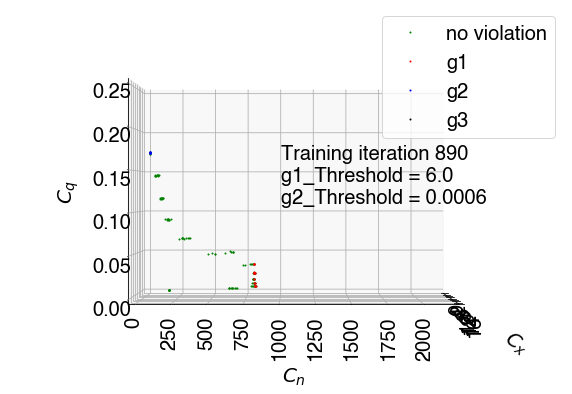

No. of states visited: 130
No. of states where g1 violated: 26
No. of states where g2 violated: 6
No. of states where g3 violated: 0


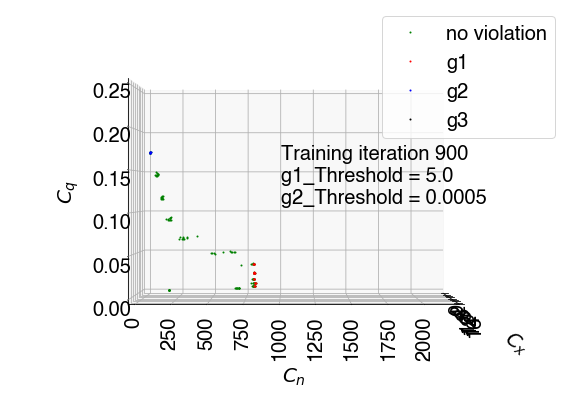

No. of states visited: 130
No. of states where g1 violated: 16
No. of states where g2 violated: 7
No. of states where g3 violated: 0


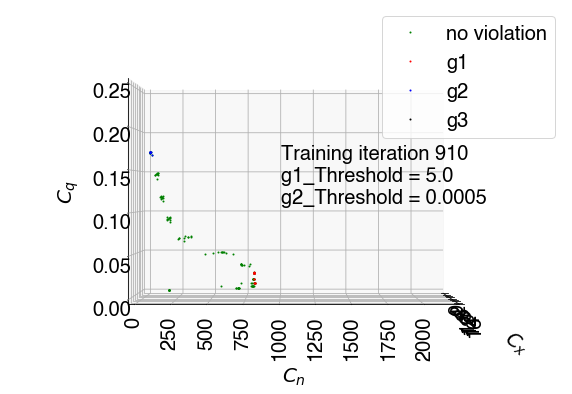

No. of states visited: 130
No. of states where g1 violated: 11
No. of states where g2 violated: 5
No. of states where g3 violated: 0


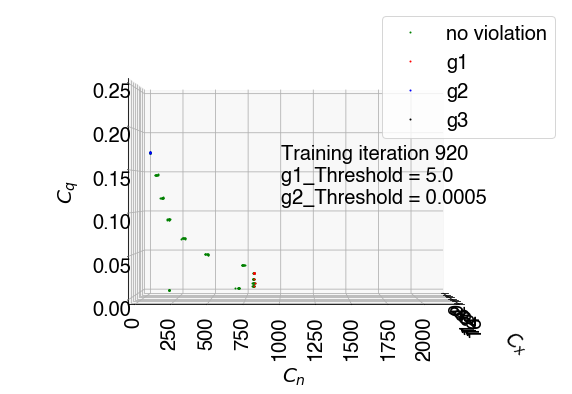

No. of states visited: 130
No. of states where g1 violated: 14
No. of states where g2 violated: 7
No. of states where g3 violated: 0


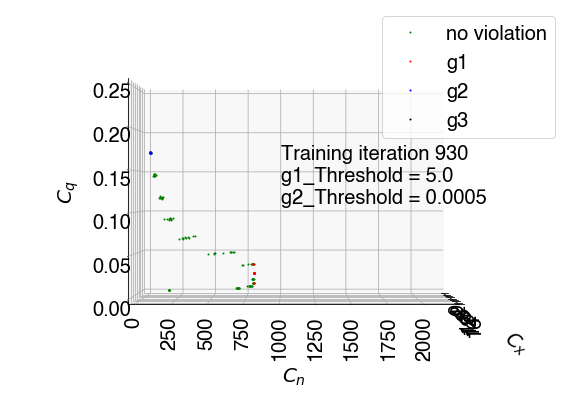

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 2
No. of states where g3 violated: 0


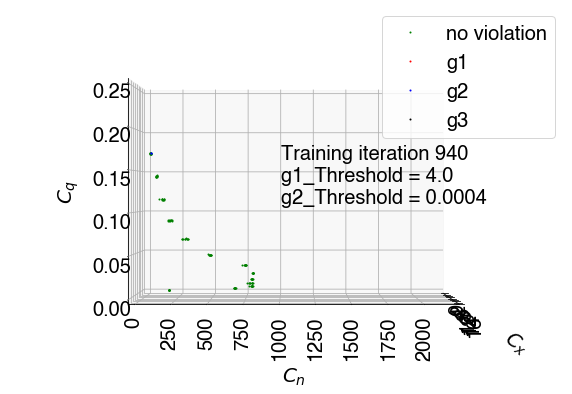

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 5
No. of states where g3 violated: 0


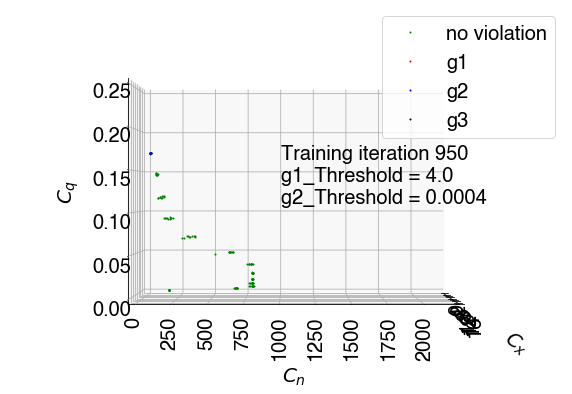

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 3
No. of states where g3 violated: 0


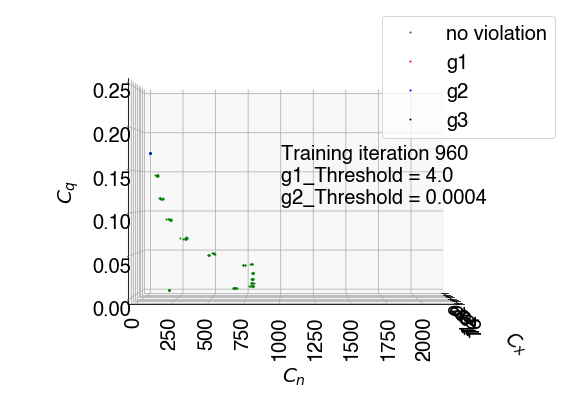

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 2
No. of states where g3 violated: 0


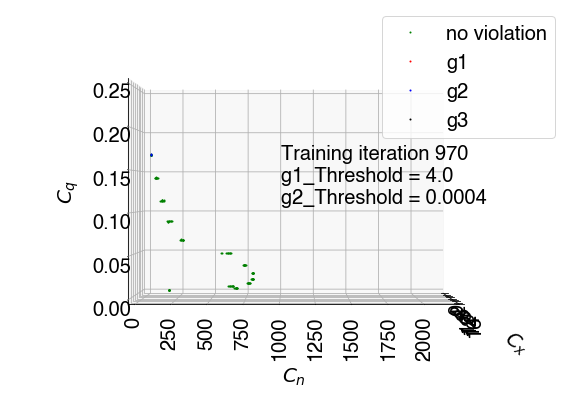

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 6
No. of states where g3 violated: 0


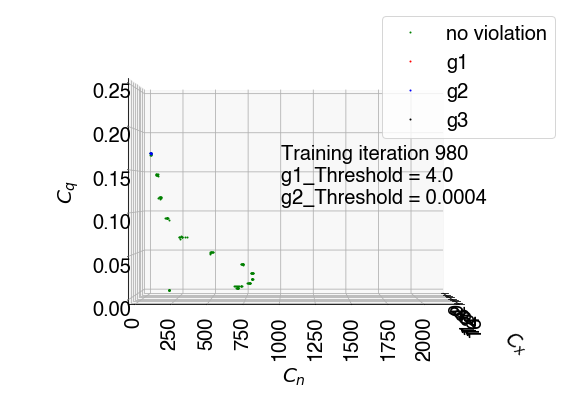

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 5
No. of states where g3 violated: 0


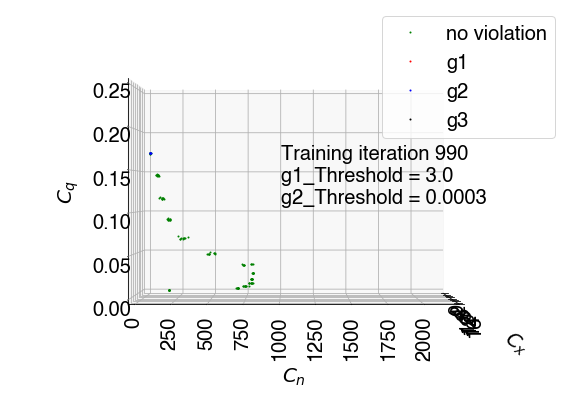

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 5
No. of states where g3 violated: 0


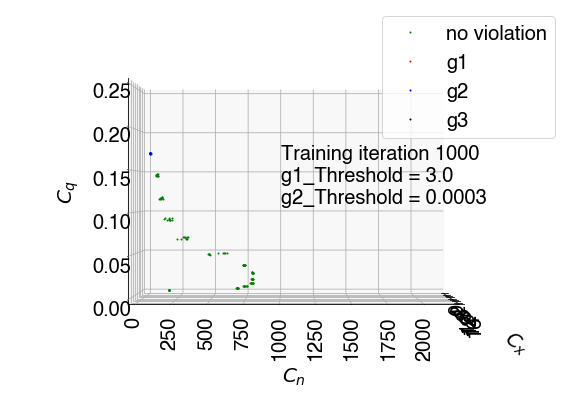

No. of states visited: 130
No. of states where g1 violated: 1
No. of states where g2 violated: 3
No. of states where g3 violated: 0


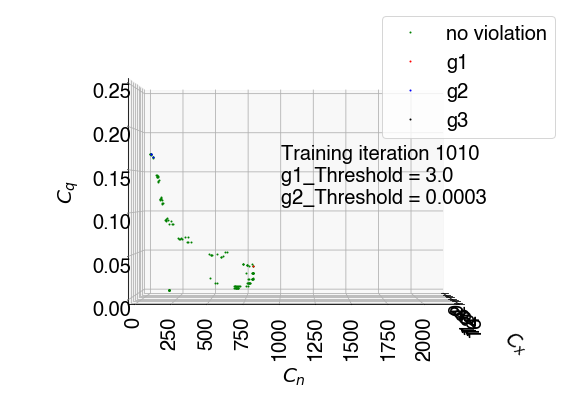

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 2
No. of states where g3 violated: 0


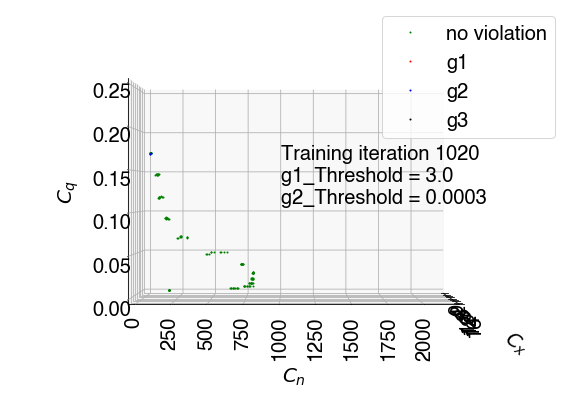

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 3
No. of states where g3 violated: 0


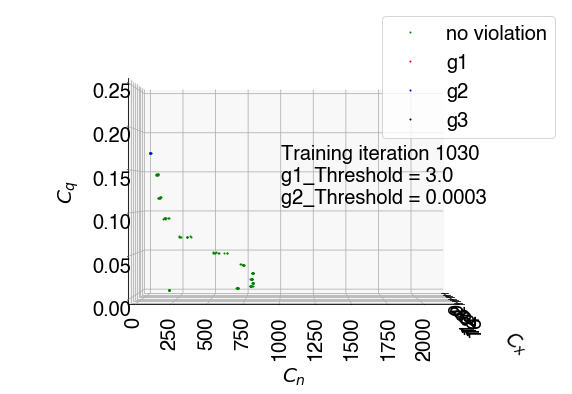

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 5
No. of states where g3 violated: 0


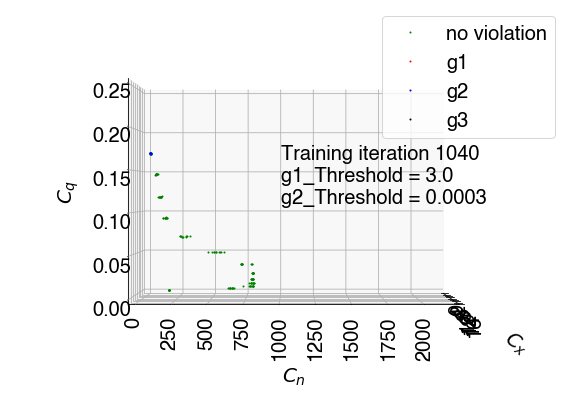

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 0
No. of states where g3 violated: 0


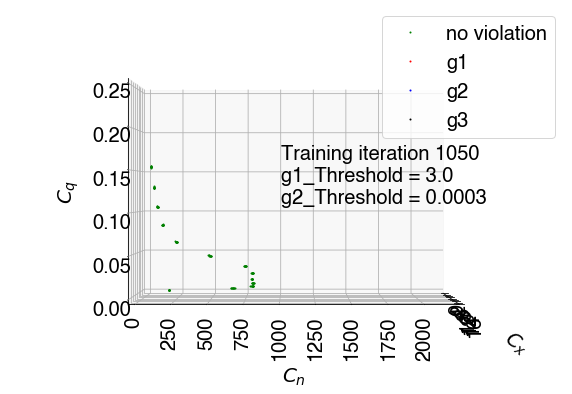

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 1
No. of states where g3 violated: 0


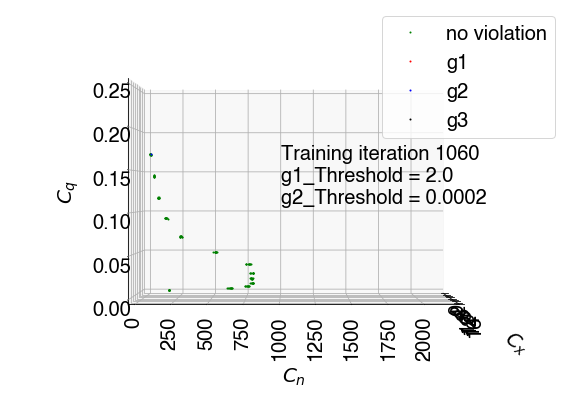

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 2
No. of states where g3 violated: 0


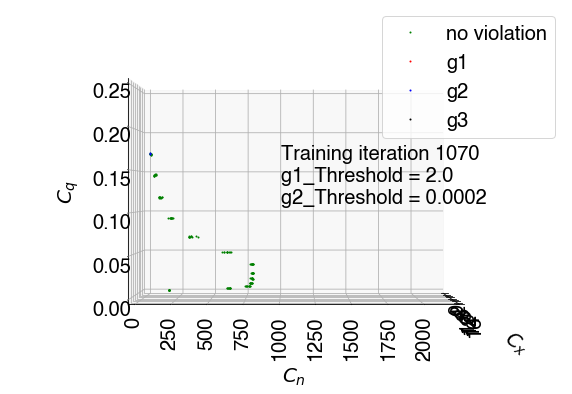

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 2
No. of states where g3 violated: 0


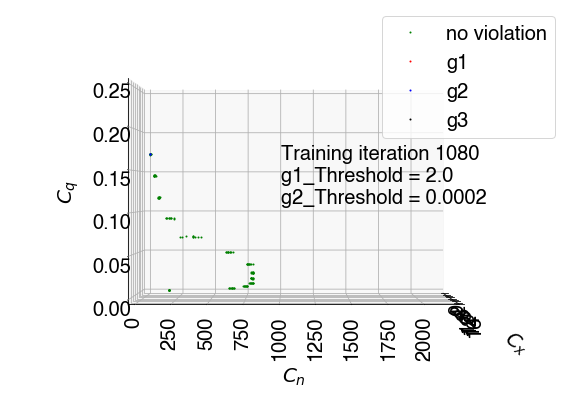

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 1
No. of states where g3 violated: 0


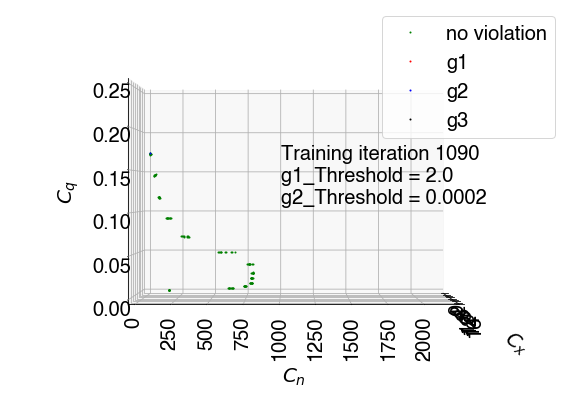

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 3
No. of states where g3 violated: 0


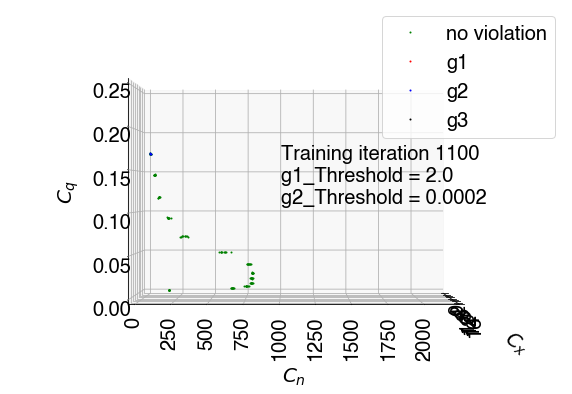

No. of states visited: 130
No. of states where g1 violated: 2
No. of states where g2 violated: 0
No. of states where g3 violated: 0


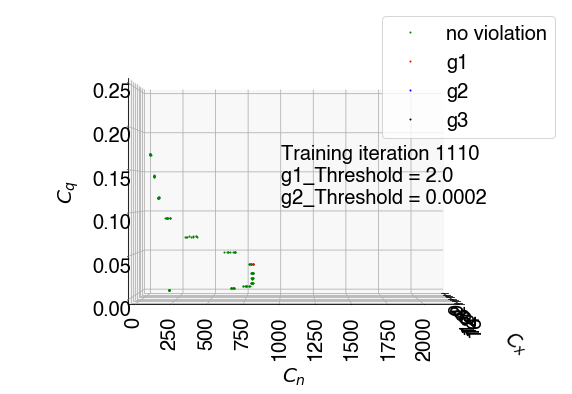

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 1
No. of states where g3 violated: 0


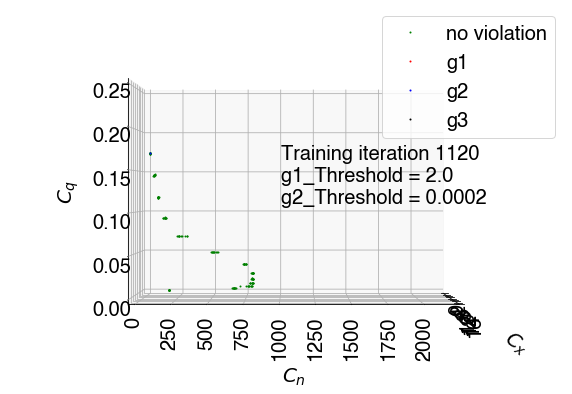

No. of states visited: 130
No. of states where g1 violated: 0
No. of states where g2 violated: 1
No. of states where g3 violated: 0


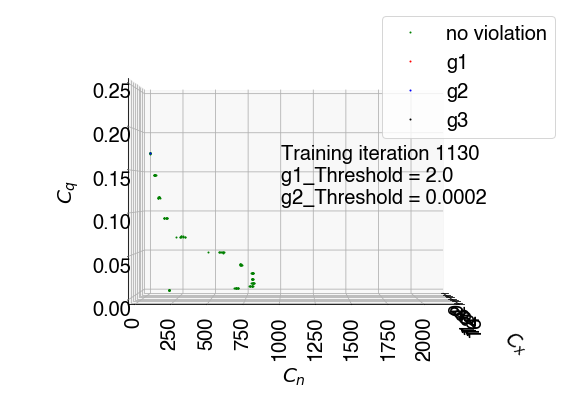

In [56]:
# Plot episode bank 
my_images = []  # For saving into gif

for i in range(len(episode_bank)): # i is the index for iteration
    plotting_state_data = []
    
    for j in range(len(episode_bank[i])): # j is the index for different episodes
        episode = episode_bank[i][j]

        data = extract_data_from_episode(episode, discount_factor = 0.9)   # Extract datapoint from episode
        for z in data:
            z = z[:-1]
            plotting_state_data += z  # Add datapoints to training set
    iteration = iteration_list[::10][i] # Record training iteration
    g1_threshold = g1_threshold_list[::10][i] # Record g1_threshold
    g2_threshold = g2_threshold_list[::10][i] # Record g1_threshold
    # plotting_state_data
    plotting_state_data = pd.DataFrame(plotting_state_data)
    plotting_state_data_g1_violated = plotting_state_data[plotting_state_data[1] - 800 > 0] # Conpath 1
    plotting_state_data_g2_violated = plotting_state_data[plotting_state_data[2] - 0.011*plotting_state_data[0] > 0] # Conpath 2
    plotting_state_data_g3_violated = plotting_state_data[(plotting_state_data[3] == 240.0) & (plotting_state_data[1] - 150 > 0)] # Terminal constraint

    print('No. of states visited:',len(plotting_state_data))
    print('No. of states where g1 violated:',len(plotting_state_data_g1_violated))
    print('No. of states where g2 violated:',len(plotting_state_data_g2_violated))
    print('No. of states where g3 violated:',len(plotting_state_data_g3_violated))

    Cx_all = plotting_state_data[0]
    Cn_all = plotting_state_data[1]
    Cq_all = plotting_state_data[2]

    Cx_g1 = plotting_state_data_g1_violated[0]
    Cn_g1 = plotting_state_data_g1_violated[1]
    Cq_g1 = plotting_state_data_g1_violated[2]

    Cx_g2 = plotting_state_data_g2_violated[0]
    Cn_g2 = plotting_state_data_g2_violated[1]
    Cq_g2 = plotting_state_data_g2_violated[2]

    Cx_g3 = plotting_state_data_g3_violated[0]
    Cn_g3 = plotting_state_data_g3_violated[1]
    Cq_g3 = plotting_state_data_g3_violated[2]

    
    fig = plt.figure(figsize = (10,7))
    ax = plt.axes(projection='3d')

    # Data for a three-dimensional line
    ax.plot3D(Cx_all, Cn_all, Cq_all, 'g', label = 'no violation', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g1, Cn_g1, Cq_g1, 'r', label = 'g1', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g2, Cn_g2, Cq_g2, 'b', label = 'g2', linestyle = '', marker = 'o', markersize = 1)
    ax.plot3D(Cx_g3, Cn_g3, Cq_g3, 'black', label = 'g3', linestyle = '', marker = 'o', markersize = 1)
    plt.xlabel('$C_x$', labelpad=30)
    plt.ylabel('$C_n$', labelpad=50)
    ax.set_zlabel('$C_q$', fontsize=20, labelpad=20)
    plt.legend()
    plt.xticks(rotation=90)
    plt.yticks(rotation=90)
    plt.xlim(0,16)
    plt.ylim(0,2200)
    ax.set_zlim(0, 0.25)
    plt.legend()
    ax.text(0,1000,0.11,'Training iteration {} \ng1_Threshold = {} \ng2_Threshold = {}'.format(iteration, round(g1_threshold,0), round(g2_threshold,4)),None)
    ax.view_init(0,0)
    plt.show()
        
    # Used to return the plot as an image array 
    # (https://ndres.me/post/matplotlib-animated-gifs-easily/)
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    my_images.append(image)

# save images as a gif    
# imageio.mimsave('./Data/CS1_training_g1g2g3_1100_ep.gif', my_images, fps=6)

## Plot trajectory with MC episodes

In [253]:
# SAVING EPISODE POOL - JSON WORKS BUT NOT PICKLE BCOS NESTED LIST
import json
# # open output file for writing
# with open('./Data/CS1_episode_pool_g1g2g3_noise_1000_ep', 'w') as f:
#     json.dump(episode_pool, f)
# # open output file for reading
# with open('./Data/CS1_episode_pool_g1g2g3_noise_1000_ep', 'r') as f:
#     episode_pool = json.load(f)

In [233]:
# Plot average of 1000 episodes
episode_pool = []
for i in range(1000):
    initialize_MDP_BioEnv() # Initialize system
    try:
        episode = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = 0,
                                                 g2_threshold = -0.001,
                                                 g3_threshold = 0)
    except KeyboardInterrupt:
        episode = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = 0,
                                                 g2_threshold = -0.001,
                                                 g3_threshold = 0) # Generate 1 episode
    episode_pool += [episode]

<ipython-input-256-f56bcf986bda>:573: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(3,2,1)
<ipython-input-256-f56bcf986bda>:581: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(3,2,2)
<ipython-input-256-f56bcf986bda>:588: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created 

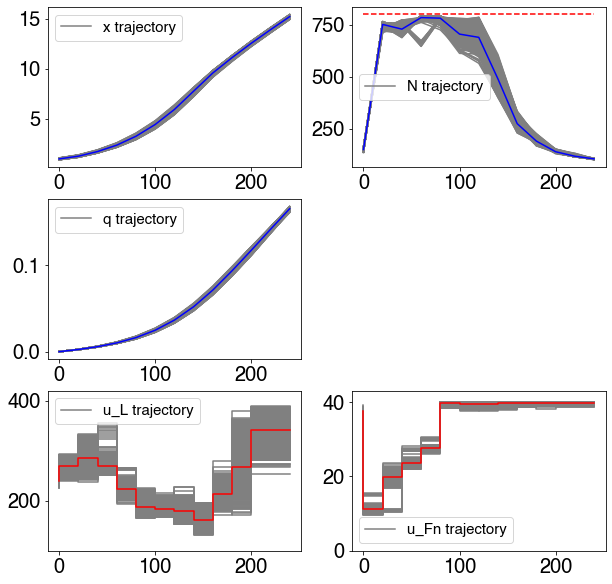

Score: 0.16651943227574642


In [257]:
plot_episode_pool(episode_pool)

## Plot g1, g2, g3 trajectories

In [296]:
g1_pool = [] # List of lists of g1 trajectories
g2_pool = []
g3_pool = []
t_list = range(0,260,20) # Define time

for i in range(1000):
    initialize_MDP_BioEnv() # Initialize system
    episode = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                     initial_state = generate_initial_state(),
                                                     epsilon = epsilon, 
                                                     g1_threshold = 0,
                                                     g2_threshold = -0.001,
                                                     g3_threshold = 0) # Generate 1 episode
    g1_list = extract_constraint_values_from_episode_NO_ORACLE(episode, N_limit = 800, terminal_N_limit = 150)[1]
    g2_list = extract_constraint_values_from_episode_NO_ORACLE(episode, N_limit = 800, terminal_N_limit = 150)[2]
    g3_list = extract_constraint_values_from_episode_NO_ORACLE(episode, N_limit = 800, terminal_N_limit = 150)[3]
    g1_pool += [g1_list]
    g2_pool += [g2_list]
    g3_pool += [g3_list]

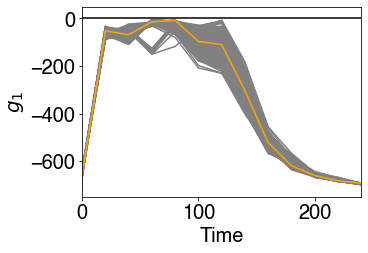

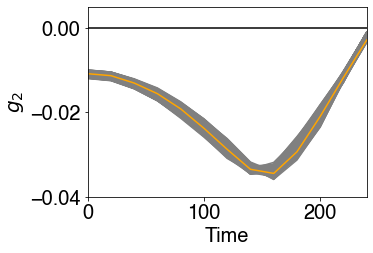

In [297]:
# Plot g1 trajectory
plt.figure(figsize = (5,3.5))
for g1_list in g1_pool:
    plt.plot(t_list, g1_list, color = 'grey')
g1_pool = np.array(g1_pool)
g1_average  = g1_pool.mean(axis = 0) # Take average of trajectory
plt.plot(t_list, g1_list, color = 'orange')
plt.plot([-100,2500], [0,0], color = 'black')
plt.xlabel('Time')
plt.ylabel('$g_1$')
plt.ylim(-750, 50)
plt.xlim(0,240)
plt.show()

# Plot g2 trajectory
plt.figure(figsize = (5,3.5))
for g2_list in g2_pool:
    plt.plot(t_list, g2_list, color = 'grey')
g2_pool = np.array(g2_pool)
g2_average  = g2_pool.mean(axis = 0) # Take average of trajectory
plt.plot(t_list, g2_list, color = 'orange')
plt.plot([-100,2500], [0,0], color = 'black')
plt.xlabel('Time')
plt.ylabel('$g_2$')
plt.ylim(-0.04,0.005)
plt.xlim(0,240)
plt.show()

## Plot distribution of g values

In [248]:
# Save data
# with open('./Data/CS1_max_g1_g1g2g3_noise_1000_ep', 'wb') as f:
#     pickle.dump(max_g1_list, f, pickle.HIGHEST_PROTOCOL)
# with open('./Data/CS1_max_g2_g1g2g3_noise_1000_ep', 'wb') as f:
#     pickle.dump(max_g2_list, f, pickle.HIGHEST_PROTOCOL)
# with open('./Data/CS1_max_g3_g1g2g3_noise_1000_ep', 'wb') as f:
#     pickle.dump(max_g3_list, f, pickle.HIGHEST_PROTOCOL)
    
# Load pre-run data
# with open('./Data/CS1_max_g1_g1g2g3_noise_1000_ep', 'rb') as f:
#     max_g1_list = pickle.load(f)
# with open('./Data/CS1_max_g2_g1g2g3_noise_1000_ep', 'rb') as f:
#     max_g2_list = pickle.load(f)
# with open('./Data/CS1_max_g3_g1g2g3_noise_1000_ep', 'rb') as f:
#     max_g3_list = pickle.load(f)

In [235]:
max_g1_list = []
max_g2_list = []
max_g3_list = []
for i in range(1000):
    initialize_MDP_BioEnv()
    try:
        episode = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = 0,
                                                 g2_threshold = -0.001,
                                                 g3_threshold = 0) # Generate 1 episode
    except KeyboardInterrupt:
        episode = generate_episode_with_NN(NN = GA_optimize_constrained,
                                                 initial_state = generate_initial_state(),
                                                 epsilon = epsilon, 
                                                 g1_threshold = 0,
                                                 g2_threshold = -0.001,
                                                 g3_threshold = 0) # Generate 1 episode
    # WORST violation of this episode
    max_g1 = max(extract_constraint_values_from_episode(episode, N_limit = 800, terminal_N_limit = 150)[1])[0]
    max_g2 = max(extract_constraint_values_from_episode(episode, N_limit = 800, terminal_N_limit = 150)[2])[0]
    max_g3 = max(extract_constraint_values_from_episode(episode, N_limit = 800, terminal_N_limit = 150)[3])[0]
    max_g1_list += [max_g1]
    max_g2_list += [max_g2]
    max_g3_list += [max_g3]

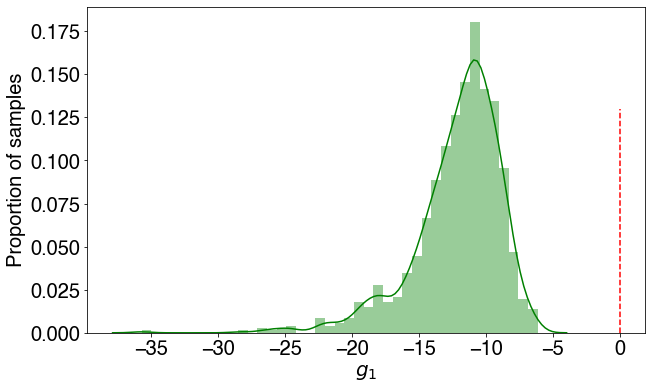

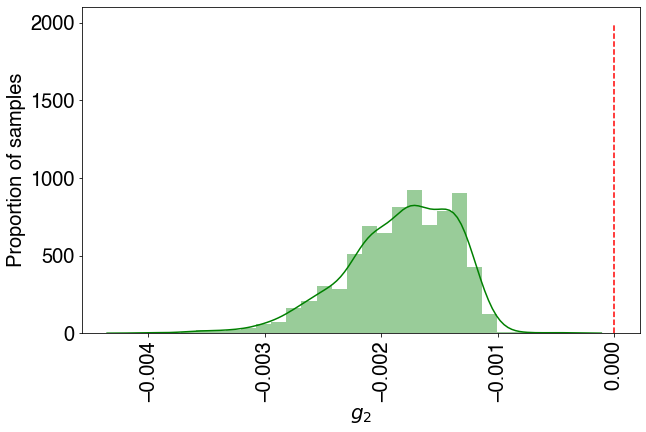

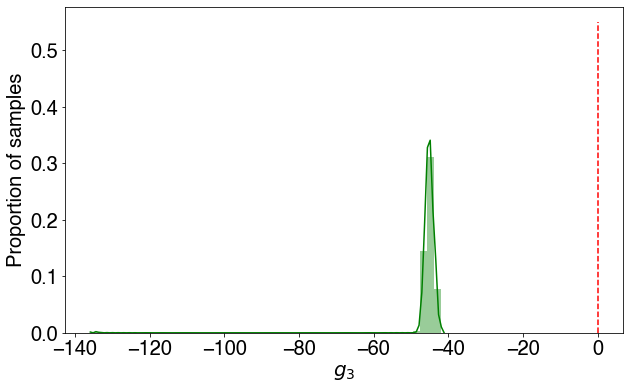

In [238]:
# Plot distribution of g1
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(max_g1_list, norm_hist = True, color = 'green')
ax.set(xlabel= '$g_1$', ylabel = 'Proportion of samples')
plt.plot([0,0],[0,0.13], linestyle = '--', color = 'r')
# plt.xlim(-1000,1000)
plt.show()

# Plot distribution of g2
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(max_g2_list, norm_hist = True, color = 'green')
ax.set(xlabel= '$g_2$', ylabel = 'Proportion of samples')
plt.plot([0,0],[0,2000], linestyle = '--', color = 'r')
plt.xticks(rotation=90)
# plt.xlim(-0.055,0.022)
plt.show()

# Plot distribution of g1
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(max_g3_list, norm_hist = True, color = 'green')
ax.set(xlabel= '$g_3$', ylabel = 'Proportion of samples')
plt.plot([0,0],[0,0.55], linestyle = '--', color = 'r')
# plt.xlim(-160,330)
plt.show()

## Superimpose before and after training

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(g1_constraint, norm_hist = True)
ax.set(xlabel= '$g_1$', ylabel = 'Fraction of samples')
plt.plot([0,0],[0,0.0023], linestyle = '--', color = 'r')
plt.legend()
plt.show()

fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(g2_constraint, norm_hist = True)
ax.set(xlabel= '$g_2$', ylabel = 'Fraction of samples')
plt.plot([0,0],[0,90], linestyle = '--', color = 'r')
plt.legend()
plt.show()

fig, ax = plt.subplots(figsize=(10,6))
ax = sns.distplot(g3_constraint, norm_hist = True)
ax.set(xlabel= '$g_3$', ylabel = 'Fraction of samples')
plt.plot([0,0],[0,0.007], linestyle = '--', color = 'r')
plt.legend()
plt.show()

## Make gif for nitrate trajectory

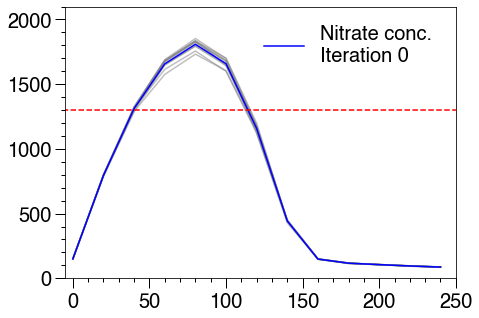

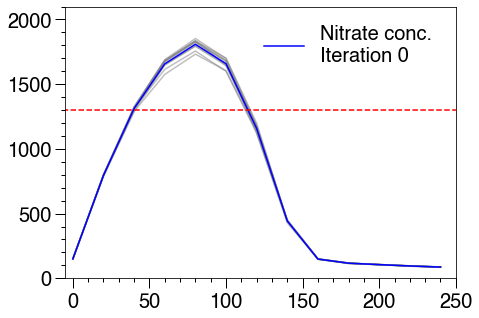

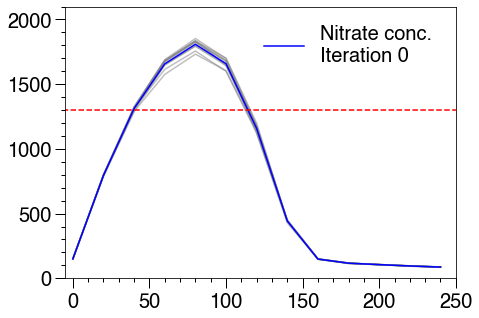

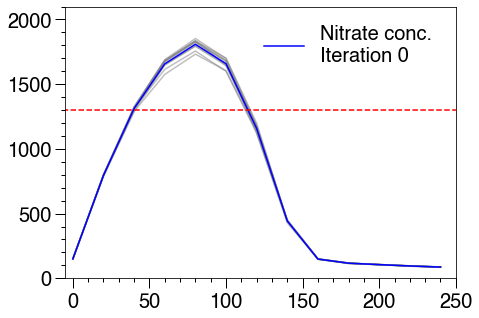

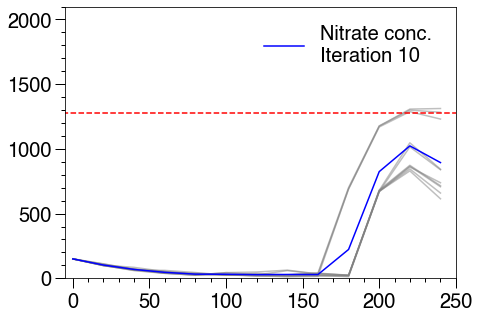

...

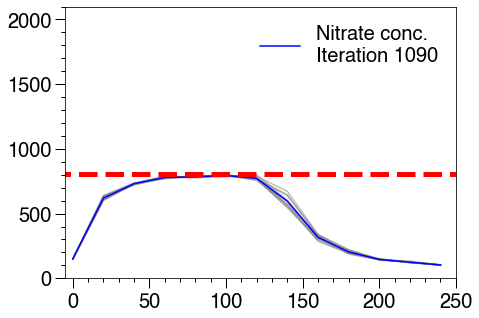

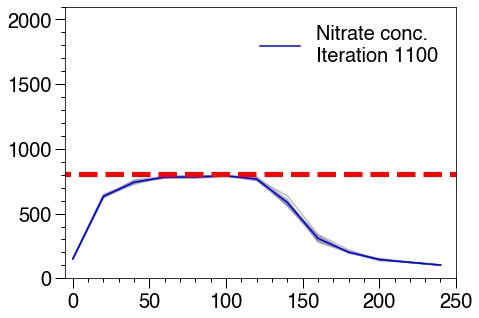

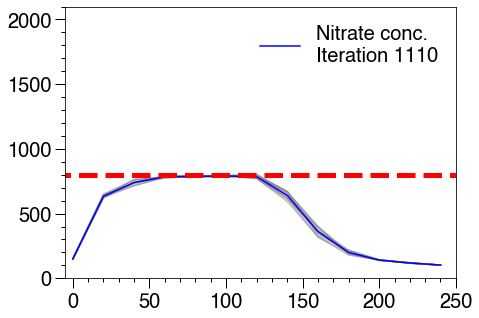

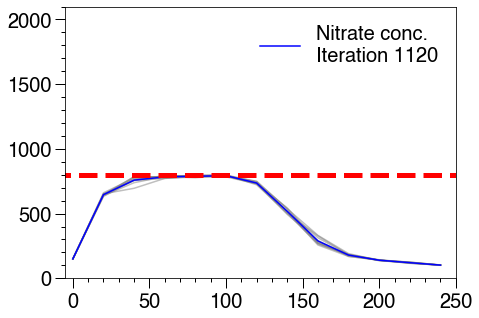

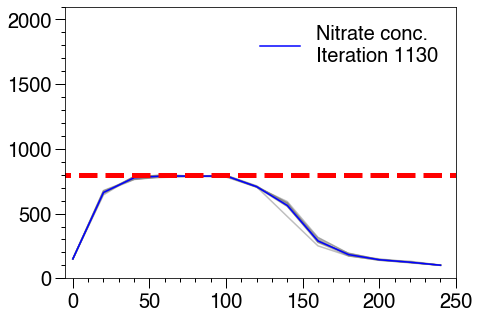

In [132]:
my_images = []

for i in range(len(episode_bank)):
    if i <= 20:
        for j in range(4):
            N_lim = 800 + 500*(0.995**(i*10))
            episode_pool = episode_bank[i]   

            fig, ax = plt.subplots(figsize = (7,5))
            Cn_pool = []
            for episode in episode_pool: # Idx refers to nth episode in episode pool
                Cn_list = []
                t_list = []
                t = 0
                for step in episode:
                    Cn_list += [step[0][1]]
                    t_list  += [t]
                    t       += tf
                plt.plot(t_list, Cn_list, color = 'grey', alpha = 0.5)
                Cn_pool += [Cn_list]
            Cn_pool = np.array(Cn_pool)
            Cn_average = Cn_pool.mean(axis=0)
            plt.plot(t_list, Cn_average, color = 'b', label = 'Nitrate conc. \nIteration %.0f' % (i*10))
            if i < 90:
                plt.plot([-50, 300], [N_lim, N_lim], linestyle = '--', color = 'r')
            else:
                plt.plot([-50, 300], [N_lim, N_lim], linestyle = '--', linewidth = 5, color = 'r')
            ax.minorticks_on()
            ax.xaxis.set_minor_locator(AutoMinorLocator(5))
            ax.yaxis.set_minor_locator(AutoMinorLocator(5))
            ax.tick_params(which='major', length=10, width=1, direction='out')
            ax.tick_params(which='minor', length=4, width=1, direction='out')
            plt.xlim(-5,250)
            plt.ylim(0,2100)
            plt.legend(frameon = 0)
            plt.show()
            # For saving into gif
            fig.canvas.draw()       # draw the canvas, cache the renderer
            image  = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
            image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
            my_images.append(image)
    
    else:
        N_lim = 800 + 500*(0.995**(i*10))
        episode_pool = episode_bank[i]   

        fig, ax = plt.subplots(figsize = (7,5))
        Cn_pool = []
        for episode in episode_pool: # Idx refers to nth episode in episode pool
            Cn_list = []
            t_list = []
            t = 0
            for step in episode:
                Cn_list += [step[0][1]]
                t_list  += [t]
                t       += tf
            plt.plot(t_list, Cn_list, color = 'grey', alpha = 0.5)
            Cn_pool += [Cn_list]
        Cn_pool = np.array(Cn_pool)
        Cn_average = Cn_pool.mean(axis=0)
        plt.plot(t_list, Cn_average, color = 'b', label = 'Nitrate conc. \nIteration %.0f' % (i*10))
        if i < 90:
            plt.plot([-50, 300], [N_lim, N_lim], linestyle = '--', color = 'r')
        else:
            plt.plot([-50, 300], [N_lim, N_lim], linestyle = '--', linewidth = 5, color = 'r')
        ax.minorticks_on()
        ax.xaxis.set_minor_locator(AutoMinorLocator(5))
        ax.yaxis.set_minor_locator(AutoMinorLocator(5))
        ax.tick_params(which='major', length=10, width=1, direction='out')
        ax.tick_params(which='minor', length=4, width=1, direction='out')
        plt.xlim(-5,250)
        plt.ylim(0,2100)
        plt.legend(frameon = 0)
        plt.show()
        # For saving into gif
        fig.canvas.draw()       # draw the canvas, cache the renderer
        image  = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
        my_images.append(image)
        

# save images as a gif    
# imageio.mimsave('./Data/CS1_Nitrate_modified.gif', my_images, fps=10)

## Make gif for biomass trajectory

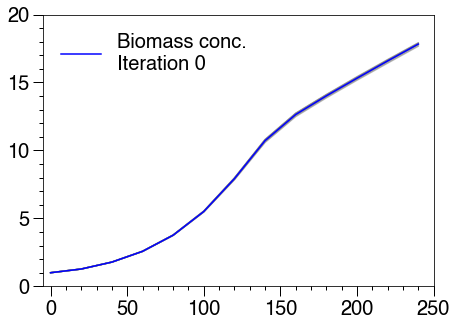

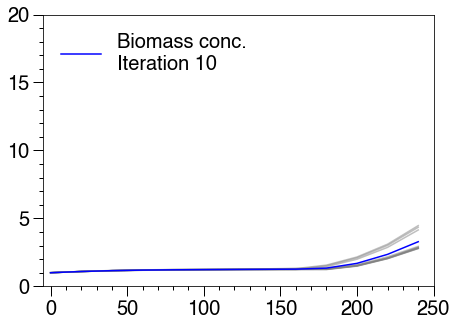

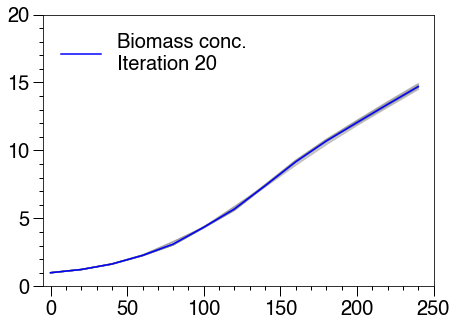

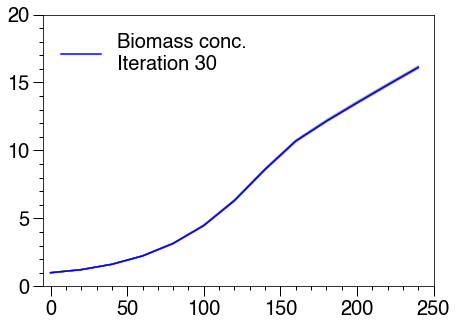

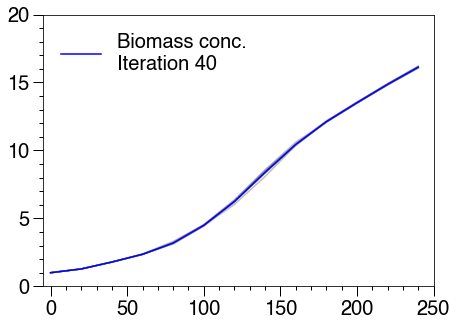

...

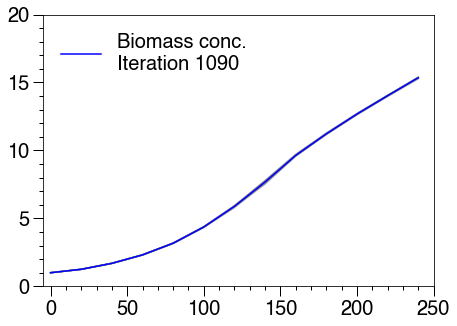

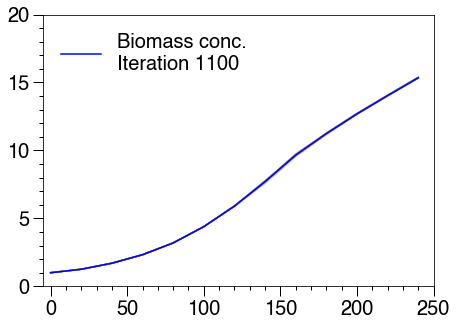

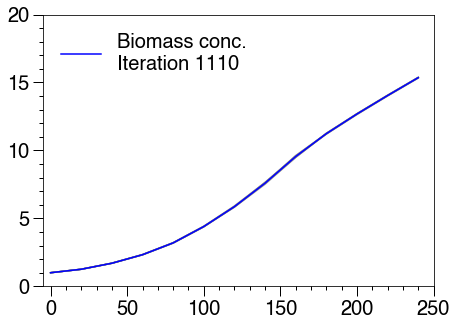

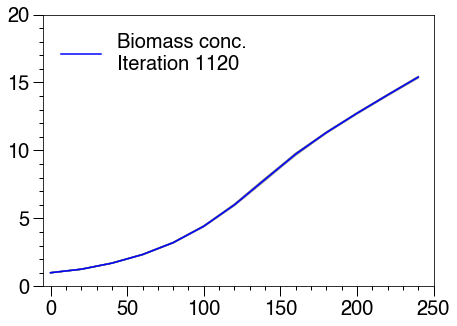

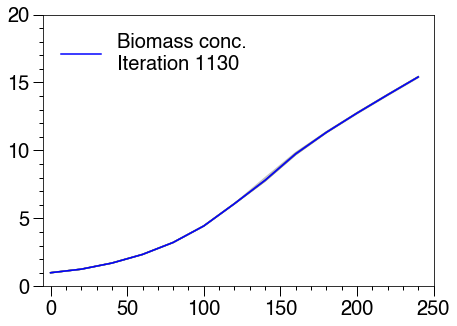

In [124]:
my_images = []

for i in range(len(episode_bank)):
# for i in range(1):
    episode_pool = episode_bank[i]   

    fig, ax = plt.subplots(figsize = (7,5))
    Cx_pool = []
    for episode in episode_pool: # Idx refers to nth episode in episode pool
        Cx_list = []
        t_list = []
        t = 0
        for step in episode:
            Cx_list += [step[0][0]]
            t_list  += [t]
            t       += tf
        plt.plot(t_list, Cx_list, color = 'grey', alpha = 0.5)
        Cx_pool += [Cx_list]
    Cx_pool = np.array(Cx_pool)
    Cx_average = Cx_pool.mean(axis=0)
    plt.plot(t_list, Cx_average, color = 'b', label = 'Biomass conc. \nIteration %.0f' % (i*10))
    ax.minorticks_on()
    ax.xaxis.set_minor_locator(AutoMinorLocator(5))
    ax.yaxis.set_minor_locator(AutoMinorLocator(5))
    ax.tick_params(which='major', length=10, width=1, direction='out')
    ax.tick_params(which='minor', length=4, width=1, direction='out')
    plt.xlim(-5,250)
    plt.ylim(0,20)
    plt.legend(frameon = 0, loc = 'upper left')
    plt.show()

    # For saving into gif
    # Used to return the plot as an image array 
    # (https://ndres.me/post/matplotlib-animated-gifs-easily/)
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image  = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    my_images.append(image)

# save images as a gif    
# imageio.mimsave('./Data/CS1_Biomass.gif', my_images, fps=10)

## Make gif for product trajectory

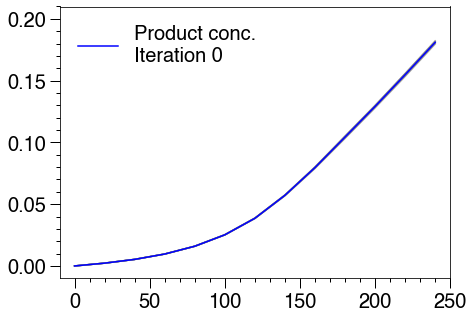

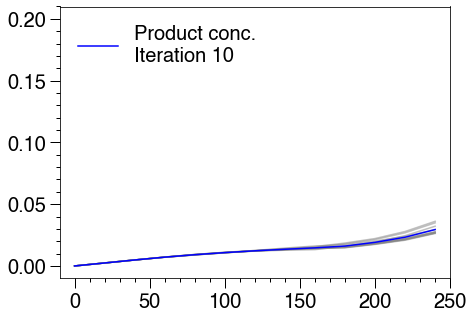

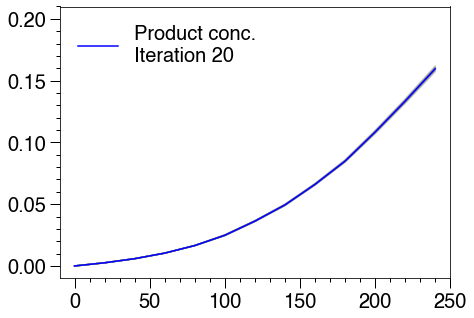

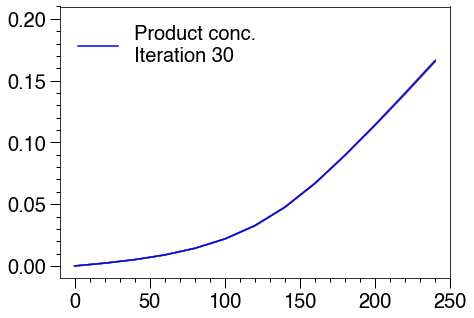

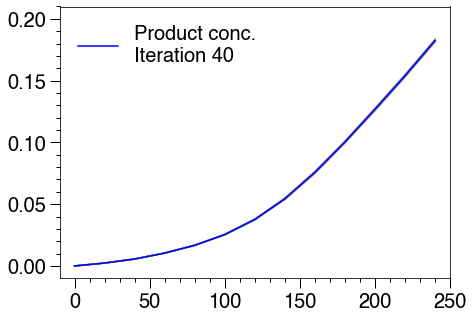

...

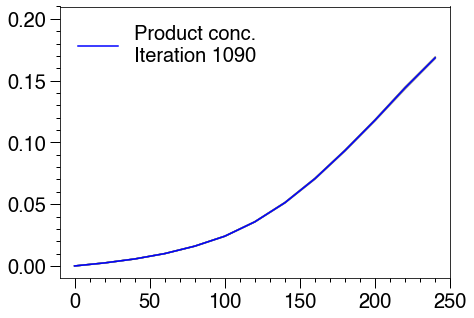

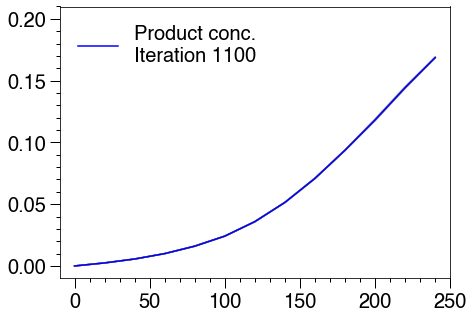

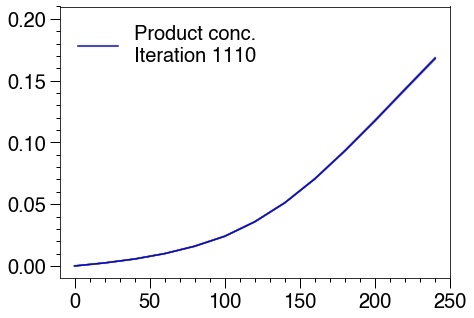

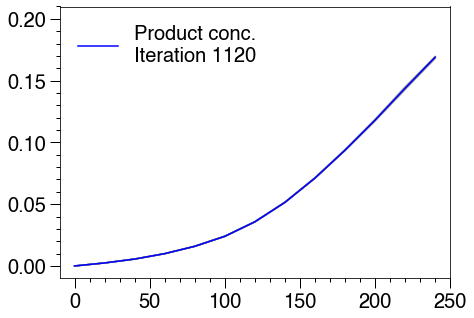

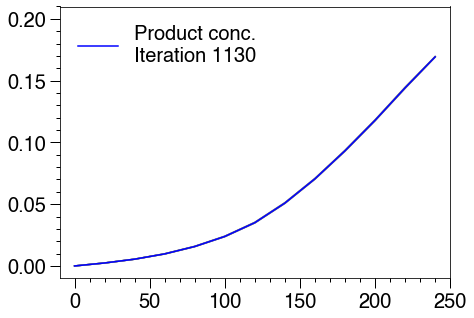

In [131]:
my_images = []

for i in range(len(episode_bank)):
# for i in range(1):
    episode_pool = episode_bank[i]   

    fig, ax = plt.subplots(figsize = (7,5))
    Cq_pool = []
    for episode in episode_pool: # Idx refers to nth episode in episode pool
        Cq_list = []
        t_list = []
        t = 0
        for step in episode:
            Cq_list += [step[0][2]]
            t_list  += [t]
            t       += tf
        plt.plot(t_list, Cq_list, color = 'grey', alpha = 0.5)
        Cq_pool += [Cq_list]
    Cq_pool = np.array(Cq_pool)
    Cq_average = Cq_pool.mean(axis=0)
    plt.plot(t_list, Cq_average, color = 'b', label = 'Product conc. \nIteration %.0f' % (i*10))
    ax.minorticks_on()
    ax.xaxis.set_minor_locator(AutoMinorLocator(5))
    ax.yaxis.set_minor_locator(AutoMinorLocator(5))
    ax.tick_params(which='major', length=10, width=1, direction='out')
    ax.tick_params(which='minor', length=4, width=1, direction='out')
    plt.xlim(-10,250)
    plt.ylim(-0.01,0.21)
    plt.legend(frameon = 0, loc = 'upper left')
    plt.show()

    # For saving into gif
    # Used to return the plot as an image array 
    # (https://ndres.me/post/matplotlib-animated-gifs-easily/)
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image  = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    my_images.append(image)

# save images as a gif    
# imageio.mimsave('./Data/CS1_Product.gif', my_images, fps=10)